<a href="https://colab.research.google.com/github/TeoCavi/gitHelloWorld/blob/master/Network_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Directories and Dependencies

## Dependencies

In [3]:
!pip install med_dataloader

     |████████████████████████████████| 48.4 MB 1.2 MB/s 
  Created wheel for med-dataloader: filename=med_dataloader-0.1.12-py2.py3-none-any.whl size=10922 sha256=892b01273597eb6d09e8267fcc41d251239cae28e6112547a019adbde02baa8b
  Stored in directory: /root/.cache/pip/wheels/f9/a6/6d/7e58516ef9580421703539030ba5c41ed3956f2ffc755fc21c
Successfully built med-dataloader


In [4]:
!pip install tensorflow_addons

     |████████████████████████████████| 1.1 MB 9.8 MB/s 


In [5]:
import numpy as np

import tensorflow as tf
from tensorboard.plugins.hparams import api as hp
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import Model
from tensorflow.python.framework import ops
from tensorflow.keras import utils as tfu
from tensorflow.python.ops import confusion_matrix
import tensorflow_probability as tfp
import tensorflow_addons as tfa

from keras.callbacks import TensorBoard,ModelCheckpoint

from datetime import datetime
from dateutil.tz import gettz

import med_dataloader as mdl

import os
import shutil
from pathlib import Path

import matplotlib.pyplot as plt
from matplotlib import gridspec

from IPython.display import clear_output

from tabulate import tabulate

import csv

## Setup for Drive Environment

In [6]:
from google.colab import drive
ROOT_PATH = os.path.join(os.sep, 'content' , 'gdrive')
drive.mount(ROOT_PATH)

Mounted at /content/gdrive


# Model Preparation

## Setup *Dataset parameters* and *Paths*



In [7]:
check_overwrite = False

In [8]:
NUM_CLASSES = 7
BATCH_SIZE = 8
EPOCHS = 70

DATA_AUGMENTATION = False
ROTATION = False
FLIP = False
CROP_SIZE = None

PERC_TRAIN_DATA = 0.8  
PERC_VALIDATION_DATA = 0.1
PERC_TEST_DATA = 0.1

PROJECT_PATH = os.path.join(ROOT_PATH, 'MyDrive', 'Colab Notebooks Teo', 'Segmentazione PoliMi') 
DATASET_PATH = os.path.join(PROJECT_PATH, 'Dataset_TF')
CODE_PATH = os.path.join(PROJECT_PATH, 'Code')
MODEL_PATH = os.path.join(PROJECT_PATH, 'Models')

#METRICS PARAMETERS
##GCE
GCE_THRESHOLD = 0.8

#LOSS PARAMETERS
##Focal
GAMMA = 2

##TopK
PERCENTILE = 5

##HD
ALPHA = 2

train_prop = {'NUM_CLASSES': NUM_CLASSES,
                'BATCH_SIZE': BATCH_SIZE,
                'EPOCHS': EPOCHS,
                'DATA_AUGMENTATION': DATA_AUGMENTATION,
                'ROTATION': ROTATION,
                'FLIP': FLIP,
                'CROP_SIZE': CROP_SIZE,
                'PERC_TRAIN_DATA': PERC_TRAIN_DATA,
                'PERC_VALIDATION_DATA':PERC_VALIDATION_DATA,
                'PERC_TEST_DATA': PERC_TEST_DATA,
                'GCE_THRESHOLD': GCE_THRESHOLD,
              }

## Dataset Extraction

In [9]:
train_ds, validation_ds, test_ds = mdl.get_dataset(data_dir = DATASET_PATH,
                                                    percentages = [PERC_TRAIN_DATA, PERC_VALIDATION_DATA, PERC_TEST_DATA],
                                                    batch_size = BATCH_SIZE,
                                                    train_augmentation = DATA_AUGMENTATION,
                                                    random_crop_size = CROP_SIZE,
                                                    random_rotate = ROTATION,
                                                    random_flip = FLIP,
                                                    )

In [10]:
element = 0
for i in train_ds.as_numpy_iterator():
    element += 1

BATCH_NUM_TRAIN = element

element = 0
for i in test_ds.as_numpy_iterator():
    element += 1

BATCH_NUM_TEST = element

element = 0
for i in validation_ds.as_numpy_iterator():
    element += 1

BATCH_NUM_VALIDATION = element


## Dataset Visualization

### Train Set

  Batch n°:   0


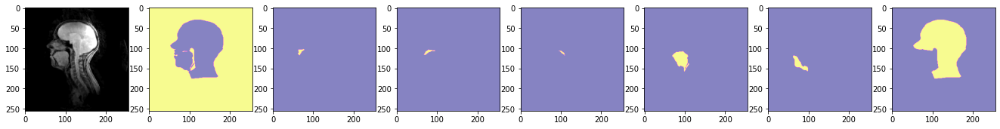

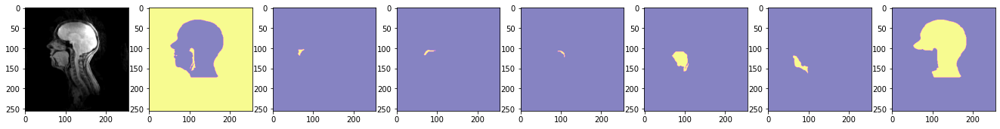

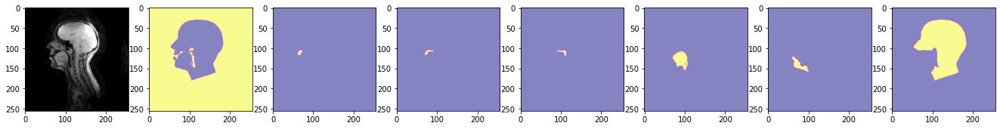

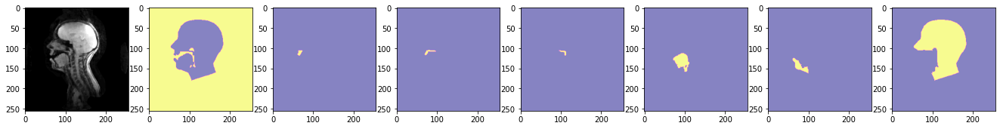

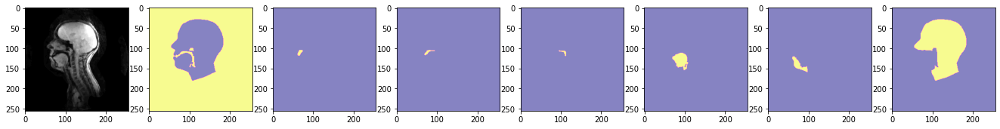

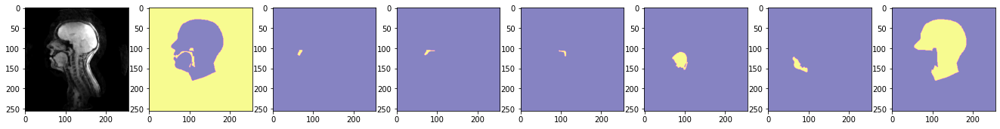

KeyboardInterrupt: ignored

In [81]:
batch_n = 0
import seaborn as sns

for batch in train_ds.take(BATCH_NUM_TRAIN):  #rendi meno hard code 
    volume_batch, label_batch = batch
    #fig = plt.figure(figsize = [23, 7])
    
    print("\033[92m \033[1m Batch n°:  \033[0m", batch_n)
    batch_n = batch_n + 1


    for volume, label in zip(volume_batch, label_batch):
        #print(np.percentile(volume, [25, 50, 75, 90, 99]))
        fig = plt.figure(figsize = [23, 7]) #creo ogni ciclo la figura bianca
        plt.subplot(1, NUM_CLASSES + 1, 1) #creo le colonne e le righe
        plt.imshow(volume[:,:,0], cmap="gray") #ploto l'immagine

        for i in range(NUM_CLASSES):
            
            plt.subplot(1, NUM_CLASSES + 1, i+2) #muovo l'indice di colonna per plottare le varie classi 
            plt.imshow(label[:,:,i], cmap="plasma", alpha=0.5) #plotto le classi 
    plt.show(fig) #stampo il tutto

### Validation Set

In [ ]:
batch_n = 0

for batch in validation_ds.take(BATCH_NUM_VALIDATION):  #rendi meno hard code 
    volume_batch, label_batch = batch
    #fig = plt.figure(figsize = [23, 7])
    print("\033[92m \033[1m Batch n°:  \033[0m", batch_n)
    batch_n = batch_n + 1

    for volume, label in zip(volume_batch, label_batch):
        fig = plt.figure(figsize = [23, 7]) #creo ogni ciclo la figura bianca
        plt.subplot(1, NUM_CLASSES + 1, 1) #creo le colonne e le righe
        plt.imshow(volume[:,:,0], cmap="gray") #ploto l'immagine

        for i in range(NUM_CLASSES):
            
            plt.subplot(1, NUM_CLASSES + 1, i+2) #muovo l'indice di colonna per plottare le varie classi 
            plt.imshow(label[:,:,i], cmap="plasma", alpha=0.5) #plotto le classi 
    plt.show(fig) #stampo il tutto

### Test Set

In [ ]:
batch_n = 0

for batch in test_ds.take(BATCH_NUM_TEST):  #rendi meno hard code 
    volume_batch, label_batch = batch
    #fig = plt.figure(figsize = [23, 7])
    print("\033[92m \033[1m Batch n°:  \033[0m", batch_n)
    batch_n = batch_n + 1

    for volume, label in zip(volume_batch, label_batch):
        fig = plt.figure(figsize = [23, 7]) #creo ogni ciclo la figura bianca
        plt.subplot(1, NUM_CLASSES + 1, 1) #creo le colonne e le righe
        plt.imshow(volume[:,:,0], cmap="gray") #ploto l'immagine

        for i in range(NUM_CLASSES):
            
            plt.subplot(1, NUM_CLASSES + 1, i+2) #muovo l'indice di colonna per plottare le varie classi 
            plt.imshow(label[:,:,i], cmap="plasma", alpha=0.5) #plotto le classi 
    plt.show(fig) #stampo il tutto

## Losses

1. Cross Entropy:  $\, L_{CE} = -\sum_{c=1}^{C} \frac{1}{N} \sum_{i=1}^{N} g_i^c\,log\,p_i^c \quad$ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



2. Weighted Cross Entropy: $\, L_{WCE} = -\sum_{c=1}^{C} w_c\frac{1}{N} \sum_ {i=1}^{N} g_i^c\,log\,p_i^c  \quad \text{with} \quad w_c = \frac{N°\,non\,null\,pixels\,of\,labels\,for\,all\,classes}{N°\,non\,null\,pixels\,of\,label\,for\,single\,class} \quad$ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



3. Focal Loss: $\, L_{Focal} = -\frac{1}{N} \sum_{c=1}^{C} \sum_{i=1}^{N} (1-p_{i}^{c})^{\gamma} g_{i}^{c} \log\,p_{i}^{c} \quad \text{with} \quad \gamma=2 \quad \text{obtains best performances} \quad$ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



4. TopK Loss: $\, L_{TopK} = -\frac{1}{N} \sum_{c=1}^{C} \sum_{i \in K} g_i^c\,log\,p_i^c \quad \text{with K% worst pixels} \quad $ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



5. Dice Loss: $\, L_{DC} = 1 \,-\,\frac{2\,\sum_{c=1}^{C}\sum_{i=1}^{N}g_i^c\,p_i^c}{\sum_{c=1}^{C}\sum_{i=1}^{N}g_i^c \,+\, \sum_{c=1}^{C}\sum_{i=1}^{N}p_i^c  } \quad$ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



6. Hausdorff Distance Loss: $\, L_{HD} =\frac{1}{N} \sum_{c=1}^{C} \sum_{i=1}^{N} [(p_{i}^{c} - g_{i}^{c})^{2} \circ (d_{G_{i}^{c}}^{\alpha} + d_{P_{i}^{c}}^{\alpha})] \quad \text{with best} \, \alpha = 2 \quad  $[[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)[[2]](https://ieeexplore.ieee.org/stamp/stamp.jsp?tp=&arnumber=8767031)



7. Dice Cross Entropy: $\, L_{DC} \,+\, L_{CE} \quad$ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



8. Dice Focal: $\, L_{DC} \,+\, L_{Focal} $ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



9. Dice TopK: $\, L_{DC} \,+\, L_{TopK} $ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



10. Dice HD: $\, L_{DC} \,+\, L_{HD} $ [[1]](https://www.sciencedirect.com/science/article/pii/S1361841521000815)



N.B: $\scriptstyle g_i^c \, \text{are ground truth pixels of class c, while} \, p_i^c \, \text{are predicted pixels of class c}$

In [12]:
#DISTRIBUTION BASED LOSSES

class Cross_Entropy(tf.keras.losses.Loss):
    def __init__ (self,
                  num_classes, 
                  name = 'CE',
                  **kwargs):
        
        super(Cross_Entropy, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.name = name
        self.cname = 'Cross_Entropy'
        
    def call(self, y_true, y_pred): #[batch_size, 256, 256, classe], viene chiamata per ogni batch

        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)
        
        loss_image = 0.0
        loss = 0.0

        for c in range(self.num_classes): #y_true.shape[3]): #automatic detection del numero di classi
            loss_image = tf.math.add(-1*(tf.math.reduce_mean(tf.math.multiply(y_true[:,:,:,c], tf.math.log(y_pred[:,:,:,c] + 1e-9)), axis = (1,2))), loss_image)

                    
        loss = tf.math.reduce_mean(loss_image)

        return loss

    def get_config(self):

        config = super(Cross_Entropy, self).get_config() #estraggo i parametri come dictionary dell super(keras.losses.Loss) che sono reduction= SUM_OVER_BATCH e name
        config.update({'num_classes': self.num_classes}) #aggiungo al dictionary gli altri parametri di mio interesse 

        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


class Weighted_Cross_Entropy(keras.losses.Loss):
    def __init__(self,
                 num_classes,
                 name = 'WCE',
                 **kwargs):
        
        super(Weighted_Cross_Entropy, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.name = name
        self.cname = 'Weighted_Cross_Entropy'
        
    def call(self, y_true, y_pred): #most correct version

        num_classes = self.num_classes

        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)

        tot_pixels = 0.
        loss_batch = 0.
        tot_weight = 0.
        weighted_loss = 0.
        weighted_mean_loss = 0.

        loss_image = tf.TensorArray(tf.float32, size=0, dynamic_size=True, clear_after_read=False)
        n_pixels_1 = tf.TensorArray(tf.float32, size=0, dynamic_size=True, clear_after_read=False)

        for c in range(num_classes): #y_true.shape[3]): #automatic detection del numero di classi
            n_pixels_1 = n_pixels_1.write(c, tf.math.count_nonzero(y_true[:,:,:,c], axis = (1,2), dtype=tf.float32))
            loss_image = loss_image.write(c, -1*(tf.math.reduce_mean(tf.math.multiply(y_true[:,:,:,c], tf.math.log(y_pred[:,:,:,c] + 1e-9)), axis = (1,2))))
            tot_pixels = tf.add(n_pixels_1.read(c), tot_pixels)
                    
        for c in range(num_classes):
            weight_class_c = tot_pixels/n_pixels_1.read(c)
            tot_weight = tf.math.add(weight_class_c, tot_weight)

            loss_batch = tf.math.add(tf.math.multiply(weight_class_c, loss_image.read(c)), loss_batch)

        weighted_loss = tf.math.divide(loss_batch, tot_weight)
        weighted_mean_loss = tf.math.reduce_mean(weighted_loss)

        return weighted_mean_loss

    def get_config(self):

        config = super(Weighted_Cross_Entropy, self).get_config()
        config.update({'num_classes': self.num_classes})

        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


class Focal(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  gamma = 2,
                  name = 'Focal',
                  **kwargs):
    
        super(Focal, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.gamma = gamma
        self.name = name
        self.cname = 'Focal'
    
    def call(self, y_true, y_pred):

        num_classes = self.num_classes
        gamma = self.gamma

        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)
        
        loss_image = 0.0
        loss = 0.0

        for c in range(num_classes): #y_true.shape[3]): #automatic detection del numero di classi
            loss_image = tf.math.add(-1.*(tf.math.reduce_mean(tf.math.multiply(
                tf.math.pow(tf.math.subtract(1.,y_pred[:,:,:,c]), gamma), 
                tf.math.multiply(y_true[:,:,:,c], tf.math.log(y_pred[:,:,:,c] + 1e-9))
                ), axis = (1,2))), loss_image)
                                
        loss = tf.math.reduce_mean(loss_image)

        return loss

    def get_config(self):

        config = super(Focal, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'gamma': self.gamma})

        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


class TopK(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  percentile, 
                  name = 'TopK',
                  **kwargs):
    
        super(TopK, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.percentile = percentile
        self.name = name
        self.cname = 'TopK'
    
    def call(self, y_true, y_pred):

        num_classes = self.num_classes
        percentile = self.percentile

        y_true = tf.convert_to_tensor(value = y_true)
        y_pred = tf.convert_to_tensor(value = y_pred)

        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)
        batch_s = 0

        #extraction of dinamic size
        batch_s = tf.math.reduce_mean(y_pred, axis = (1,2,3)) # mi riduco ad un vettore [batch_size]
        batch_s= tf.math.add(1., batch_s) #sommo a tutto 1 per contare tutti i valori
        batch_s = tf.math.count_nonzero(batch_s) #conto tutti gli elementi non nulli
        
        y_true = tf.reshape(y_true, [batch_s , y_pred.shape[1], y_pred.shape[2], y_pred.shape[3]])

        diff = 0.
        perc_s = 0.
        mask_b = 0.
        k_y_true = 0.
        k_y_pred = 0.
        topk_loss = 0.

        for c in range(num_classes):
            diff = tf.math.abs(tf.math.subtract(y_true[:,:,:,c],y_pred[:,:,:,c]))
            perc_s = tfp.stats.percentile(diff, [100 - percentile], axis = (1,2), keepdims= True)
            perc_s = tf.squeeze(perc_s, 0)
            mask_b = tf.cast(tf.greater_equal(diff, perc_s), dtype = tf.float32)
            k_y_true = tf.math.multiply(y_true[:,:,:,c], mask_b)
            k_y_pred = tf.math.multiply(y_pred[:,:,:,c], mask_b)
            topk_loss = tf.math.add(Cross_Entropy(num_classes = 1)(tf.expand_dims(k_y_true,3), tf.expand_dims(k_y_pred,3)), topk_loss)

        return topk_loss

    def get_config(self):

        config = super(TopK, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'percentile': self.percentile})

        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


#REGION BASED LOSSES

class Dice(tf.keras.losses.Loss):
    def __init__ (self,
                  num_classes, 
                  name = 'Dice',
                  **kwargs):
        
        super(Dice, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.name = name
        self.cname = 'Dice'

    def call(self, y_true, y_pred):

        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)
        
        num = 0.
        den_l = 0.
        den_r = 0.

        for c in range(self.num_classes):
            num = tf.math.add(tf.reduce_sum(tf.math.multiply(y_true[:,:,:,c], y_pred[:,:,:,c]), axis = (1,2)), num)
            den_l = tf.math.add(tf.reduce_sum(y_true[:,:,:,c], axis = (1,2)), den_l)
            den_r = tf.math.add(tf.reduce_sum(y_pred[:,:,:,c], axis = (1,2)), den_r)

        loss_image = 1 - tf.math.divide(2*num, tf.math.add(den_l, den_r))
        loss = tf.reduce_mean(loss_image)

        return loss
    
    def get_config(self):
        config = super(Dice, self).get_config()
        config.update({'num_classes': self.num_classes})
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


#BOUNDARY BASED LOSSES

class Hausdorff_Distance_Loss(keras.losses.Loss):

    def __init__ (self,
                  num_classes,
                  batch_size,
                  alpha = 2,
                  name = 'HDL',
                  **kwargs):
        
        super(Hausdorff_Distance_Loss, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.batch_size = batch_size
        self.alpha = alpha
        self.name = name
        self.cname = 'Hausdorff_Distance_Loss'
    
    def call(self, y_true, y_pred):

        num_classes = self.num_classes
        batch_size = self.batch_size
        alpha = self.alpha

        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)

        y_t = tf.cast(tf.cast(y_true, dtype= bool), dtype= tf.uint8)
        y_p = tf.cast(tf.cast(y_pred, dtype= bool), dtype= tf.uint8)

        hd_loss_image = tf.TensorArray(tf.float32, size=0, dynamic_size=True, clear_after_read=False)

        distance_transform_map = 0.
        dtm_mod = 0.
        symmetric_distance = 0.
        hd_loss_classes = 0.
        hd_loss = 0.
        reshape_image = 0.
        delta = 0.
        negative = 0.
        y_p_mod = 0.

        c = 0
        b = 0
        check = 0

        batch_s = 0

        #extraction of dinamic size
        batch_s = tf.math.reduce_mean(y_pred, axis = (1,2,3)) # mi riduco ad un vettore [batch_size]
        batch_s= tf.math.add(1., batch_s) #sommo a tutto 1 per contare tutti i valori
        batch_s = tf.cast(tf.math.count_nonzero(batch_s), dtype = tf.int32) #conto tutti gli elementi non nulli
        

        for c in range(num_classes):               
            for b in range(batch_s):
                
                symmetric_distance = tf.math.square(tf.math.subtract(y_pred[b,:,:,c],y_true[b,:,:,c]))
                symmetric_distance = tf.cast(symmetric_distance, dtype = tf.float32)
                
                check = tf.math.count_nonzero(y_p[b,:,:,c])
                
                if check == (y_pred.shape[1]*y_pred.shape[2]):
                    reshape_image = tf.pad(y_p[b,:,:,c], [[1,0],[0,0]], mode='CONSTANT', constant_values= 1 , name=None)
                    delta = tf.sparse.to_dense(tf.SparseTensor([[0,0]], [1.], [y_pred.shape[1]+1,y_pred.shape[2]]))
                    negative = tf.cast(tf.math.logical_not(tf.cast(delta, dtype = tf.bool)), tf.uint8)
                    y_p_mod = tf.math.multiply(reshape_image, negative)
                    dtm_mod = tfa.image.euclidean_dist_transform(y_p_mod, dtype= tf.float32)[1:,:]
                    distance_transform_map = tf.math.add(tf.math.pow(tfa.image.euclidean_dist_transform(y_t[b,:,:,c], dtype= tf.float32), alpha), tf.math.pow(dtm_mod, alpha))
                    distance_transform_map = tf.cast(distance_transform_map, dtype= tf.float32)
                else:
                    distance_transform_map = tf.math.add(tf.math.pow(tfa.image.euclidean_dist_transform(y_t[b,:,:,c], dtype= tf.float32), alpha), tf.math.pow(tfa.image.euclidean_dist_transform(y_p[b,:,:,c], dtype= tf.float32), alpha))
                    distance_transform_map = tf.cast(distance_transform_map, dtype= tf.float32)
                
                hd_loss_image = hd_loss_image.write(b, tf.math.reduce_mean(tf.math.multiply(symmetric_distance, distance_transform_map )))

            hd_loss_classes = tf.math.add(hd_loss_image.stack(), hd_loss_classes)
            
        hd_loss = tf.math.reduce_mean(hd_loss_classes)

        return hd_loss
    
    def get_config(self):
        config = super(Hausdorff_Distance_Loss, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'batch_size': self.batch_size,
                       'alpha': self.alpha})
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


#COMPOUND LOSSES
class Dice_CE(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  name = 'DiceCE',
                  **kwargs):
        
        super(Dice_CE, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.name = name
        self.cname = 'Dice_CE'
    
    def call(self, y_true, y_pred):     
        dice_loss = Dice(self.num_classes)(y_true, y_pred)  
        cross_entropy_loss = Cross_Entropy(self.num_classes)(y_true, y_pred)
        loss = dice_loss + cross_entropy_loss

        return loss
    
    def get_config(self):
        config = super(Dice_CE, self).get_config()
        config.update({'num_classes': self.num_classes})
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


class Dice_Focal(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  gamma = 2,
                  name = 'DiceFocal',
                  **kwargs):
        
        super(Dice_Focal, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.gamma = gamma
        self.name = name
        self.cname = 'Dice_Focal'
    
    def call(self, y_true, y_pred):

        dice_loss = Dice(self.num_classes)(y_true, y_pred)  
        focal_loss = Focal(self.num_classes, self.gamma)(y_true, y_pred)
        loss = dice_loss + focal_loss

        return loss
    
    def get_config(self):
        config = super(Dice_Focal, self).get_config()
        config.update({'num_classes': self.num_classes})
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


class Dice_TopK(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  percentile, 
                  name = 'DiceTopK',
                  **kwargs):
    
        super(Dice_TopK, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.percentile = percentile
        self.name = name
        self.cname = 'Dice_TopK'
    
    def call(self, y_true, y_pred):

        dice_loss = Dice(self.num_classes)(y_true, y_pred)
        top_k_loss = TopK(self.num_classes, self.percentile)(y_true, y_pred)
        loss = dice_loss + top_k_loss

        return loss
    
    def get_config(self):

        config = super(Dice_TopK, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'percentile': self.percentile})

        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


class Dice_HD(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  batch_size,
                  alpha = 2,
                  name = 'DiceHD',
                  **kwargs):
        
        super(Dice_HD, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.batch_size = batch_size
        self.alpha = alpha
        self.name = name
        self.cname = 'Dice_HD'
    
    def call(self, y_true, y_pred):

        dice_loss = Dice(self.num_classes)(y_true, y_pred)
        hd_loss = Hausdorff_Distance_Loss(self.num_classes, self.batch_size, self.alpha)(y_true, y_pred)
        loss = dice_loss + hd_loss

        return loss
    
    def get_config(self):
        config = super(Dice_HD, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'batch_size': self.batch_size,
                       'alpha': self.alpha})
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)

class Dice_CE_Focal(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  gamma = 2,
                  name = 'DiceCEFocal',
                  **kwargs):
        
        super(Dice_CE_Focal, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.gamma = gamma
        self.name = name
        self.cname = 'Dice_CE_Focal'
    
    def call(self, y_true, y_pred):     
        dice_loss = Dice(self.num_classes)(y_true, y_pred)  
        cross_entropy_loss = Cross_Entropy(self.num_classes)(y_true, y_pred)
        focal_loss = Focal(self.num_classes, self.gamma)(y_true, y_pred)
        loss = dice_loss + cross_entropy_loss + focal_loss

        return loss
    
    def get_config(self):
        config = super(Dice_CE_Focal, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'gamma': self.gamma
                       })
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)

class Dice_CE_TopK(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  percentile,
                  name = 'DiceCETopK',
                  **kwargs):
        
        super(Dice_CE_TopK, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.percentile = percentile
        self.name = name
        self.cname = 'Dice_CE_TopK'
    
    def call(self, y_true, y_pred):     
        dice_loss = Dice(self.num_classes)(y_true, y_pred)  
        cross_entropy_loss = Cross_Entropy(self.num_classes)(y_true, y_pred)
        top_k_loss = TopK(self.num_classes, self.percentile)(y_true, y_pred)
        loss = dice_loss + cross_entropy_loss + top_k_loss

        return loss
    
    def get_config(self):
        config = super(Dice_CE_TopK, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'percentile': self.percentile
                       })
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)
    
class Dice_CE_Focal_TopK(keras.losses.Loss):
    def __init__ (self,
                  num_classes,
                  percentile,
                  gamma = 2,
                  name = 'DiceCEFocalTopK',
                  **kwargs):
        
        super(Dice_CE_Focal_TopK, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.gamma = gamma
        self.percentile = percentile
        self.name = name
        self.cname = 'Dice_CE_Focal_TopK'
    
    def call(self, y_true, y_pred):     
        dice_loss = Dice(self.num_classes)(y_true, y_pred)  
        cross_entropy_loss = Cross_Entropy(self.num_classes)(y_true, y_pred)
        top_k_loss = TopK(self.num_classes, self.percentile)(y_true, y_pred)
        focal_loss = Focal(self.num_classes, self.gamma)(y_true, y_pred)
        loss = dice_loss + cross_entropy_loss + top_k_loss + focal_loss

        return loss
    
    def get_config(self):
        config = super(Dice_CE_Focal_TopK, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'gamma': self.gamma,
                       'percentile': self.percentile
                       })
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)


loss_dict = {#'CE': Cross_Entropy(num_classes=NUM_CLASSES),
             #'WCE': Weighted_Cross_Entropy(num_classes= NUM_CLASSES),
             #'Focal': Focal(num_classes=NUM_CLASSES, gamma = GAMMA),
             #'TopK': TopK(num_classes=NUM_CLASSES, percentile = PERCENTILE),
             #'Dice': Dice(num_classes= NUM_CLASSES),
             'Dice_CE': Dice_CE(num_classes= NUM_CLASSES),
             'Dice_Focal': Dice_Focal(num_classes= NUM_CLASSES, gamma = GAMMA),
             'Dice_TopK': Dice_TopK(num_classes = NUM_CLASSES, percentile = PERCENTILE ),
             'Dice_CE_Focal': Dice_CE_Focal(num_classes= NUM_CLASSES, gamma = GAMMA),
             'Dice_CE_TopK': Dice_CE_TopK(num_classes=NUM_CLASSES, percentile = PERCENTILE),
             'Dice_CE_Focal_TopK': Dice_CE_Focal_TopK(num_classes=NUM_CLASSES, gamma = GAMMA, percentile = PERCENTILE),
             #'Dice_HD': Dice_HD(num_classes=NUM_CLASSES, batch_size= BATCH_SIZE, alpha = ALPHA),
             #'HDL': Hausdorff_Distance_Loss(num_classes= NUM_CLASSES, batch_size=BATCH_SIZE, alpha = ALPHA),
             }
    

    

## Metrics

1. Weighted Mean Dice: $\, DICE = \frac { \sum_{c = 1}^{C} w_c \frac{2\lvert S_g^c \cap S_p^c \rvert}{\lvert S_g^c \rvert + \lvert S_p^c \rvert}}{\sum_{c=1}^{C} w_c} \quad$ [[3]](https://bmcmedimaging.biomedcentral.com/track/pdf/10.1186/s12880-015-0068-x.pdf)



2. Hausdorff Distance: $\, HD(G,P) = max(h(G,P), h(P,G)) \quad \text{with} \quad h(G,P)= \max\limits_{g \in G} \, \min\limits_{p \in P} \, \lvert\lvert {g - p} \rvert\rvert  \quad$[[3]](https://bmcmedimaging.biomedcentral.com/track/pdf/10.1186/s12880-015-0068-x.pdf) [[4]](https://publik.tuwien.ac.at/files/PubDat_247739.pdf)



3. Global Consistency Error: $\, GCE = \frac{1}{N} min\{ \frac{FN(FN + 2TP)}{TP+FN}+\frac{FP(FP+2TN)}{TN+FP}, \frac{FP(FP+2TP)}{TP+FP} + \frac{FN(FN+2TN)}{TN+FN}\} \quad$ [[3]](https://bmcmedimaging.biomedcentral.com/track/pdf/10.1186/s12880-015-0068-x.pdf)




In [13]:
class Mean_DICE(tf.keras.metrics.Metric):
    def __init__(self,
                num_classes, 
                name='Mean_DICE',
                **kwargs):

        super(Mean_DICE, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes

    def update_state(self, y_true, y_pred, sample_weight=None):
        
        num_classes = self.num_classes
        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)
        
        dice_batch = 0.0
        tot_pixels = 0.
        tot_weight = 0.

        #y_pred = tf.cast(tf.math.greater(y_pred, 0.8), dtype = tf.float32) #se voglio mettere threshold

        dice_image = tf.TensorArray(tf.float32, size=0, dynamic_size=True, clear_after_read=False)
        n_pixels_1 = tf.TensorArray(tf.float32, size=0, dynamic_size=True, clear_after_read=False)

        for c in range(num_classes): #y_true.shape[3]): #automatic detection del numero di classi

            n_pixels_1 = n_pixels_1.write(c, tf.math.count_nonzero(y_true[:,:,:,c], axis = (1,2), dtype=tf.float32))
            tot_pixels = tf.add(n_pixels_1.read(c), tot_pixels)
            
            abs_label = tf.math.reduce_sum(y_true[:,:,:,c], axis = (1,2))
            abs_pred = tf.math.reduce_sum(y_pred[:,:,:,c], axis = (1,2))
            MD_batch_denom = tf.math.add(abs_label, abs_pred)
            MD_batch_num = 2*tf.math.reduce_sum(tf.math.multiply(y_true[:,:,:,c], y_pred[:,:,:,c]), axis = (1,2))
            dice_image = dice_image.write(c, tf.math.divide(MD_batch_num, MD_batch_denom)) 
        
        for c in range(num_classes):

            weight_class_c = tot_pixels/n_pixels_1.read(c)
            tot_weight = tf.math.add(weight_class_c, tot_weight)

            dice_batch = tf.math.add(tf.math.multiply(weight_class_c, dice_image.read(c)), dice_batch)
        
        weighted_dice = tf.math.divide(dice_batch, tot_weight)
        self.weighted_mean_dice = tf.math.reduce_mean(weighted_dice)

    def result(self):
        return self.weighted_mean_dice
  
    def get_config(self):
        config = super(Mean_DICE, self).get_config()
        config.update({'num_classes': self.num_classes})
        return config

    @classmethod
    def from_config(cls, config):
        return cls(**config)


class Hausdorff_Distance(tf.keras.metrics.Metric):
    def __init__(self,
                num_classes, 
                name='HD',
                **kwargs):

        super(Hausdorff_Distance, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes

    def update_state(self, y_true, y_pred, sample_weight=None):

        num_classes = self.num_classes

        y_true = tf.convert_to_tensor(value = y_true)
        y_pred = tf.convert_to_tensor(value = y_pred)

        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)

        a = y_true
        b = y_pred

        num = 0.
        hd= 0.
        
        for c in range(num_classes):

            difference = (tf.expand_dims(a[:,:,:,c], axis=-2) - tf.expand_dims(b[:,:,:,c], axis=-3))
            square_distances = tf.einsum("...i,...i->...", difference, difference)
            minimum_square_distance_a_to_b = tf.reduce_min(input_tensor=square_distances, axis = -1)

            hd_a_to_b =  tf.sqrt(tf.reduce_max(input_tensor=minimum_square_distance_a_to_b, axis=-1))
            #print(hd_a_to_b)
        
            difference = (tf.expand_dims(b[:,:,:,c], axis=-2) - tf.expand_dims(a[:,:,:,c], axis=-3))
            square_distances = tf.einsum("...i,...i->...", difference, difference)
            minimum_square_distance_b_to_a = tf.reduce_min(input_tensor=square_distances, axis = -1)

            hd_b_to_a =  tf.sqrt(tf.reduce_max(input_tensor=minimum_square_distance_b_to_a, axis=-1))
            #print(hd_b_to_a)

            hd = tf.math.add(tf.math.maximum(hd_a_to_b, hd_b_to_a), hd)
        
        self.hd_mc = tf.reduce_mean(tf.math.divide(hd, num_classes))

    def result(self):
        return self.hd_mc
    
    def get_config(self):
        config = super(Hausdorff_Distance, self).get_config()
        config.update({'num_classes': self.num_classes})
        return config

    @classmethod
    def from_config(cls, config):
        return cls(**config)


class Global_Consistency_Error(tf.keras.metrics.Metric):

    def __init__(self,
                 num_classes,
                 threshold, 
                 name='GCE',
                 **kwargs):
        
        super(Global_Consistency_Error, self).__init__(name = name, **kwargs)
        self.num_classes = num_classes
        self.threshold = threshold

    def update_state(self, y_true, y_pred, sample_weight=None):

        num_classes = self.num_classes
        threshold = self.threshold

        y_true = tf.cast(y_true, dtype = tf.float32)
        y_pred = tf.cast(y_pred, dtype = tf.float32)

        GCE_image = 0.
        GCE_batch = 0.

        for c in range(num_classes):

            TP, TN, FP, FN, n = ConfusionMatrix(y_true[:,:,:,c], y_pred[:,:,:,c], threshold)

            e1 = tf.math.divide(tf.math.add(tf.math.divide(tf.math.multiply(FN, tf.math.add(FN, 2.*TP)), tf.math.add(TP, FN)), tf.math.divide(tf.math.multiply(FP, tf.math.add(FP, 2.*TN)), tf.math.add(TN, FP))), n)
            e2 = tf.math.divide(tf.math.add(tf.math.divide(tf.math.multiply(FP, tf.math.add(FP, 2.*TP)), tf.math.add(TP, FP)), tf.math.divide(tf.math.multiply(FN, tf.math.add(FN, 2.*TN)), tf.math.add(TN, FN))), n)
            GCE_image = tf.add(tf.math.minimum(e1,e2), GCE_image)
            n = 0.

        GCE_batch = tf.math.divide(GCE_image, num_classes)
        self.GCE_mc = tf.math.reduce_mean(GCE_batch)

        if tf.math.is_nan(self.GCE_mc):
            self.GCE_mc = float('inf')

    def result(self):
        return self.GCE_mc

    def get_config(self):
        config = super(Global_Consistency_Error, self).get_config()
        config.update({'num_classes': self.num_classes,
                       'threshold': self.threshold})
        return config

    @classmethod
    def from_config(cls, config):
        return cls(**config)

#CONFUSION MATRIX
def ConfusionMatrix(y_true, y_pred, threshold):

    y_true = (tf.expand_dims(y_true, axis = 3))
    y_pred = (tf.expand_dims(y_pred, axis = 3))
    
    tp = tf.math.count_nonzero(tf.math.logical_and(y_true == 1, y_pred >= threshold), dtype= tf.float32 , axis = (1,2))
    tn = tf.math.count_nonzero(tf.math.logical_and(y_true == 0, y_pred < threshold), dtype= tf.float32, axis = (1,2))
    fp = tf.math.count_nonzero(tf.math.logical_and(y_true == 0, y_pred >= threshold), dtype= tf.float32, axis = (1,2)) 
    fn = tf.math.count_nonzero(tf.math.logical_and(y_true == 1, y_pred < threshold), dtype= tf.float32, axis = (1,2))    
    n = tf.math.add_n([tp,tn,fp,fn])

    return tp, tn, fp, fn, n



# Model Architecture

## Architecture Selection

In [ ]:

SELECTED_ARCHITECTURE = 'IMUNet' #@param ["GoldStandard", "QTNet", "DRINet", "IMUNet"] {allow-input: true}

In [ ]:
check = 'n'

while check != 'y':
    clear_output(wait=False)
    check = input("Ran the previous cell? (y/n) :")

## A1: Gold_Standard



In [ ]:
class Ruthven_UNet(object):

    def __init__(self,
                 input_size = (256,256,1),
                 depth = 4,
                 n_initial_filters = 64,
                 bottleneck_filters = None,
                 output_size = None,

                 kernel_size = (3,3),
                 strides = (1,1),
                 activation_conv = 'linear',
                 padding_conv = 'same',

                 deconv_kernel_size = (2,2),
                 deconv_strides = (2,2),
                 activation_dconv = 'linear',
                 padding_dconv = 'same',

                 activation_relu = 'relu',

                 pool_size = (2,2),
                 pool_strides = (2,2),
                 
                 kernel_size_outl = (1,1),
                 strides_outl = (1,1),
                 activation_outl = 'softmax',
                 padding_outl = 'same',
                 n_output_filters = 7,
                 #kernel_regularizer = regularizers.l2(0.001),
                 #bias_regularizer = regularizers.l2(0.001),
                 ):
        
        self.input_size = input_size
        self.n_dim = len(input_size) # Number of dimensions of the input data
        self.depth = depth  #solo il numero di layer di encoding, escluso il livello bottleneck
        self.n_initial_filters = n_initial_filters
        self.n_output_filters = n_output_filters
        self.output_size = (self.input_size[0], self.input_size[1], self.n_output_filters)
        self.bottleneck_filters = self.n_initial_filters*pow(2,self.depth)

        self.kernel_size = kernel_size
        self.strides = strides
        self.activation_conv = activation_conv
        self.padding_conv = padding_conv

        self.deconv_kernel_size = deconv_kernel_size
        self.deconv_strides = deconv_strides
        self.activation_dconv = activation_dconv
        self.padding_dconv = padding_dconv

        self.activation_relu = activation_relu

        self.pool_size = pool_size
        self.pool_strides = pool_strides

        self.kernel_size_outl = kernel_size_outl  
        self.strides_outl = strides_outl
        self.activation_outl = activation_outl
        self.padding_outl = padding_outl
        

        #self.kernel_regularizer = kernel_regularizer
        #self.bias_regularizer = bias_regularizer
        
    
    def build_model(self):

        layer = layers.Input(shape = self.input_size)
        inputs = layer

        inter_layer_connection = []

        #ENCODING
        for i in range(self.depth):
            
            for j in range(2):

                layer = layers.Conv2D(filters = self.n_initial_filters*pow(2,i),
                                      kernel_size = self.kernel_size,
                                      strides = self.strides, #
                                      padding = self.padding_conv, #
                                      activation = self.activation_conv #
                                      )(layer)
                layer = layers.BatchNormalization()(layer)
                layer = layers.Activation(activation = self.activation_relu)(layer)
            
            inter_layer_connection.append(layer)
            layer = layers.MaxPooling2D(pool_size = self.pool_size,
                                        strides = self.pool_strides)(layer)
        
        #BOTTLENECK
        for j in range(2):

            layer = layers.Conv2D(filters = self.n_initial_filters*pow(2,self.depth),
                                      kernel_size = self.kernel_size,
                                      strides = self.strides,
                                      padding = self.padding_conv,
                                      activation = self.activation_conv
                                      )(layer)
            layer = layers.BatchNormalization()(layer)
            layer = layers.Activation(activation = self.activation_relu)(layer)
        
        #DECODING
        for i in range(self.depth):

            layer = layers.Conv2DTranspose(filters = self.n_initial_filters*pow(2,(self.depth-1)-i),
                                           kernel_size = self.deconv_kernel_size,
                                           strides = self.deconv_strides,
                                           padding = self.padding_dconv, #
                                           activation = self.activation_dconv
                                           )(layer)#
            
            
            layer = layers.Concatenate(axis = self.n_dim)([inter_layer_connection[(self.depth-1)-i], layer])
            

            for j in range(2):

                layer = layers.Conv2D(filters = self.n_initial_filters*pow(2,(self.depth-1)-i),
                                      kernel_size = self.kernel_size,
                                      strides = self.strides,
                                      padding = self.padding_conv, #
                                      activation = self.activation_conv#
                                      )(layer)
                layer = layers.BatchNormalization()(layer) #?
                layer = layers.Activation(activation = self.activation_relu)(layer)

        #SOFTMAX 
        outputs = layers.Conv2D(filters = self.n_output_filters,
                                kernel_size = self.kernel_size_outl,
                                strides = self.strides_outl, 
                                padding = self.padding_outl,
                                activation = self.activation_outl
                                )(layer) #self.activation_outl
        
        #outputs = layers.Softmax(axis = -1)(layer)

        self.model = Model(inputs = [inputs], outputs = [outputs])
        return self.model

    def get_config(self):
        config = {
                'depth': self.depth,
                'input_size': self.input_size,
                'n_initial_filters': self.n_initial_filters,
                'bottleneck_filters': self.n_initial_filters*pow(2,self.depth),
                'n_output_filters': self.n_output_filters,
                'output_size': (self.input_size[0], self.input_size[1], self.n_output_filters),
                'kernel_size': self.kernel_size,
                'strides': self.strides,
                'activation_conv': self.activation_conv,
                'padding_conv': self.padding_conv,
                'deconv_kernel_size': self.deconv_kernel_size,
                'deconv_strides': self.deconv_strides,
                'activation_dconv': self.activation_dconv, #se cambiano tra conv e deconv modificare
                'padding_dconv': self.padding_dconv,
                'pool_size': self.pool_size,
                'pool_strides': self.pool_strides,
                'kernel_size_outl': self.kernel_size_outl,
                'strides_outl': self.strides_outl,
                'activation_outl': self.activation_outl,
                'padding_outl': self.padding_outl
                }
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)

unet = Ruthven_UNet(input_size = (256,256,1), 
                    #kernel_size = (3,3),
                    strides = (1,1),
                    deconv_kernel_size = (2,2),
                    deconv_strides = (2,2),
                    pool_size = (2,2),
                    pool_strides = (2,2),
                    depth = 4,
                    activation_conv = 'linear',
                    activation_relu = 'relu',
                    padding_conv = 'same',
                    padding_dconv = 'same',
                    n_initial_filters = 64,
                    n_output_filters = NUM_CLASSES)

## A2: QT_Net

In [ ]:
class QT_Net():

    def __init__(self,
                 input_size = (256,256,1),
                 depth = 4,
                 n_initial_filters = 64,
                 bottleneck_filters = None,
                 output_size = None,
                 n_output_filters = 7,

                 kernel_size_conv = (5,5),
                 activation_conv = 'relu',
                 padding_conv = 'same',

                 kernel_size_last_conv = (1,1),
                 activation_last_conv = 'relu',
                 padding_last_conv = 'same',

                 kernel_size_dconv = (2,2),

                 kernel_size_outl = (1,1),
                 activation_outl = 'softmax',

                 max_pool = True,
                 pool_size = (2,2),
                 ):
        
        self.input_size = input_size
        self.depth = depth  #solo il numero di layer di encoding, escluso il livello bottleneck

        self.n_dim = len(input_size) # Number of dimensions of the input data
        self.n_initial_filters = n_initial_filters
        self.bottleneck_filters = n_initial_filters
        self.n_output_filters = n_output_filters
        self.output_size = (self.input_size[0], self.input_size[1], self.n_output_filters)

        self.kernel_size_conv = kernel_size_conv
        self.activation_conv = activation_conv
        self.padding_conv = padding_conv

        self.kernel_size_last_conv = kernel_size_last_conv
        self.activation_last_conv = activation_last_conv
        self.padding_last_conv = padding_last_conv

        self.kernel_size_dconv = kernel_size_dconv

        self.kernel_size_outl = kernel_size_outl
        self.activation_outl = activation_outl

        self.max_pool = max_pool
        self.pool_size = pool_size

  
    def build_model(self):

        inputs = layers.Input(shape = self.input_size,
                             name='inputlayer')
        x = inputs

        inter_layer_connection = []

        #ENCODING PATH
        for i in range(self.depth):
            s, x = QT_Net().DenseBlock(inp = x, 
                                       name = 'Dense{0}'.format(i+1),
                                       max_pool= self.max_pool)
            inter_layer_connection.append(s)

        #BOTTLENECK
        x = layers.Conv2D(filters = self.n_initial_filters,
                          kernel_size = self.kernel_size_last_conv,
                          padding = self.padding_last_conv, 
                          name='BottleNeck_Conv',)(x)
        x = layers.BatchNormalization(name='BottleNeck_Normalization')(x)

        #DECODING PATH
        for i in range(self.depth):
            x = layers.UpSampling2D(size = self.kernel_size_dconv,
                                    name = 'Up-pool{0}'.format(i+1))(x)
            x = layers.Concatenate(name='Concat{0}'.format(i+1))([x, inter_layer_connection[-i-1]])
            x = QT_Net().DenseBlock(inp = x, 
                                    name = 'Up_Dense{0}'.format(i+1))
        
        #OUTPUT LAYER   
        outputs = layers.Conv2D(filters = self.n_output_filters,
                               kernel_size = self.kernel_size_outl,
                               activation= self.activation_outl,
                               name='OutputLayer')(x)

        self.model = Model(inputs = [inputs], outputs = [outputs], name='QT_Net')
        return self.model
    
    def DenseBlock(self, inp, name, max_pool=False):

        fp1 = layers.Conv2D(filters = self.n_initial_filters,
                            kernel_size = self.kernel_size_conv,
                            activation= self.activation_conv,
                            padding= self.padding_conv,
                            name = name + '_Conv1')(inp)
        fp1 = layers.BatchNormalization(name=name + '_BatchNorm1')(fp1)
        con1 = layers.Concatenate(name=name+'_Concat1')([inp, fp1])

        fp2 = layers.Conv2D(filters = self.n_initial_filters,
                            kernel_size = self.kernel_size_conv,
                            activation= self.activation_conv,
                            padding= self.padding_conv,
                            name = name + '_Conv2')(con1)
        fp2 = layers.BatchNormalization(name=name + '_BatchNorm2')(fp2)
        con2 = layers.Concatenate(name=name+'_Concat2')([inp, fp1, fp2])

        res = layers.Conv2D(filters = self.n_initial_filters,
                            kernel_size = self.kernel_size_last_conv,
                            activation= self.activation_last_conv,
                            padding= self.padding_last_conv,
                            name=name+'_OutDense')(con2)
        res = layers.BatchNormalization(name=name + '_BatchNorm3')(res)
        
        if max_pool:
            max_p = layers.MaxPool2D(pool_size= self.pool_size,
                                     name=name+'_Maxpool1')(res)
            return res, max_p

        return res
    
    
    def get_config(self):
        config = {
                'depth': self.depth,
                'input_size': self.input_size,
                'n_initial_filters': self.n_initial_filters,
                'bottleneck_filters': self.n_initial_filters,
                'n_output_filters': self.n_output_filters,
                'output_size': (self.input_size[0], self.input_size[1], self.n_output_filters),
                'kernel_size_conv': self.kernel_size_conv,
                'activation_conv': self.activation_conv,
                'padding_conv': self.padding_conv,
                'kernel_size_last_conv': self.kernel_size_last_conv,
                'activation_last_conv': self.activation_last_conv,
                'padding_last_conv': self.padding_last_conv,
                'kernel_size_dconv': self.kernel_size_dconv,
                'pool_size': self.pool_size,
                'kernel_size_outl': self.kernel_size_outl,
                'activation_outl': self.activation_outl,
                }
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)

qtnet = QT_Net()


## A3: DRI_Net

In [ ]:
class DRI_Net():

    def __init__(self,
                 k = 48,
                 dense_depth = 3, #riguardare 
                 input_size = (256,256,1),
                 depth = 4,
                 ):
        
        self.input_size = input_size
        self.k = k
        self.dense_depth = dense_depth
        self.depth = depth  #solo il numero di layer di encoding, escluso il livello bottleneck

    def build_model(self):

        inputs = layers.Input(shape = self.input_size,
                             name='inputlayer')
        x = inputs

        inter_layer_connection = []

        x = layers.Conv2D(filters = 2*self.k,
                          kernel_size = (2,2),
                          strides = 2,
                         )(x)

        x = layers.MaxPool2D(pool_size = (2,2),
                             strides = 2,
                            )(x)

        #ENCODING PATH
        for i in range(self.depth - 1):
            x = DRI_Net().DenseBlock(inp = x, 
                                     depth = self.dense_depth)
            
            x = DRI_Net().TransitionBlock(inp = x,
                                          bottleneck = False)
            
        #BOTTLENECK
        x = DRI_Net().DenseBlock(inp = x, 
                                 depth = self.dense_depth)
        #print(x.shape)
        x = DRI_Net().TransitionBlock(inp = x, 
                                      bottleneck = True)
        #x = layers.BatchNormalization()(x)  #DA GUARDARE!!
        #x = layers.Activation(activation = 'relu')(x)

        #DECODING PATH

        for i in range(self.depth):

            x = DRI_Net().ResidualInceptionBlock(inp = x)
            x = DRI_Net().UnpoolingBlock(inp = x)

        outputs = layers.Conv2D(filters = 7,
                                         kernel_size = (2,2),
                                         strides = (2,2),
                                         activation = 'softmax'
                                         )(x)

        self.model = Model(inputs = [inputs], outputs = [outputs], name='DRI_Net')
        return self.model
        
    
    def DenseBlock(self, inp, depth):

        x = inp
        for i in range(depth):

            cl1 = layers.BatchNormalization()(x)
            cl1 = layers.Activation(activation = 'relu')(cl1)
            cl1 = layers.Conv2D(filters = 4*self.k,
                                kernel_size = (1,1),
                                padding = 'same')(cl1)
            cl1 = layers.BatchNormalization()(cl1)
            cl1 = layers.Activation(activation = 'relu')(cl1)
            cl1 = layers.Conv2D(filters = self.k,
                                kernel_size = (3,3),
                                padding = 'same')(cl1)
            x = layers.Concatenate()([x, cl1])
        
        return x
    
    def TransitionBlock(self, inp, bottleneck):

        tb = layers.BatchNormalization()(inp)
        if bottleneck == True:
            tb = layers.Conv2D(filters = 192,
                            kernel_size = (1,1),
                            padding = 'same')(tb)
        if bottleneck == False:
            tb = layers.Conv2D(filters = 2*self.k,
                    kernel_size = (1,1),
                    padding = 'same')(tb)
            tb = layers.AveragePooling2D(pool_size = (2,2),
                                strides = 2,
                                )(tb)
        
        return tb
    
    def ResidualInceptionBlock(self, inp):

        #print('inp', inp.shape)
        #1x1 DCONV BRANCH
        inp1 = layers.Conv2DTranspose(filters = (inp.shape[3]/4),
                                                 kernel_size = (1,1),
                                                 padding = 'same')(inp)
        inp1 = layers.BatchNormalization()(inp1)
        inp1 = layers.Activation(activation = 'relu')(inp1)
        #print('inp1', inp1.shape)

        #3x3 DCONV BRANCH
        inp3 = layers.Conv2DTranspose(filters = (inp.shape[3]/4),
                                                 kernel_size = (1,1),
                                                 padding = 'same')(inp)
        inp3 = layers.BatchNormalization()(inp3)
        inp3 = layers.Activation(activation = 'relu')(inp3)
        inp3 = layers.Conv2DTranspose(filters = (inp3.shape[3]*2),
                                      kernel_size = (3,3),
                                      padding = 'same')(inp3)
        inp3 = layers.BatchNormalization()(inp3)
        inp3 = layers.Activation(activation = 'relu')(inp3)
        #print('inp3', inp3.shape)

        #5x5 DCONV BRANCH
        inp5 = layers.Conv2DTranspose(filters = (inp.shape[3]/4),
                                                 kernel_size = (1,1),
                                                 padding = 'same')(inp)
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)
        inp5 = layers.Conv2DTranspose(filters = (inp5.shape[3]),
                                kernel_size = (5,5),
                                padding = 'same')(inp5)
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)
        #print('inp5', inp5.shape)

        concat = layers.Concatenate()([inp1, inp3, inp5])
        out = layers.Add()([concat, inp])

        return out
    
    def UnpoolingBlock(self, inp):

        #1x1 UNPOLING BRANCH
        inp1 = layers.Conv2DTranspose(filters = (inp.shape[3]/2),
                                      kernel_size = (1,1),
                                      padding = 'same')(inp) 
        inp1 = layers.BatchNormalization()(inp1)
        inp1 = layers.Activation(activation = 'relu')(inp1)
        inp1 = layers.Conv2DTranspose(filters = (inp1.shape[3]/2),
                                      kernel_size = (2,2),
                                      strides = (2,2))(inp1)
        inp1 = layers.BatchNormalization()(inp1)
        inp1 = layers.Activation(activation = 'relu')(inp1)
        
        #5x5 UNPOOLING BRANCH
        inp5 = layers.Conv2DTranspose(filters = (inp.shape[3]/2),
                                      kernel_size = (1,1),
                                      padding = 'same')(inp)
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)
        inp5 = layers.Conv2DTranspose(filters = inp5.shape[3],
                                      kernel_size = (5,5),
                                      padding = 'same')(inp5)       
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)
        inp5 = layers.Conv2DTranspose(filters = (inp5.shape[3]/2),
                                      kernel_size = (2,2),
                                      strides = (2,2))(inp5)        
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)

        out = layers.Concatenate()([inp1, inp5])
        #print(out.shape)

        return out
  
    def get_config(self):
        config = {
                'depth': self.depth,
                'dense_depth': self.dense_depth,
                'input_size': self.input_size,
                'k': self.k,
                }
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)

drinet = DRI_Net(dense_depth= 12)

In [ ]:
class DRI_Net():

    def __init__(self,
                 k = 48,
                 dense_depth = 12, #riguardare 
                 input_size = (256,256,1),
                 depth = 4,
                 ):
        
        self.input_size = input_size
        self.k = k
        self.dense_depth = dense_depth
        self.depth = depth  #solo il numero di layer di encoding, escluso il livello bottleneck

    def build_model(self):

        inputs = layers.Input(shape = self.input_size,
                             name='inputlayer')
        x = inputs

        inter_layer_connection = []

        x = layers.Conv2D(filters = 2*self.k,
                          kernel_size = (2,2),
                          strides = 2,
                         )(x)

        #x = layers.MaxPool2D(pool_size = (2,2),
                            # strides = 2,
                            #)(x)


        #ENCODING PATH
        for i in range(self.depth - 1):
            x = DRI_Net().DenseBlock(inp = x, 
                                     depth = self.dense_depth)
            
            x = DRI_Net().TransitionBlock(inp = x,
                                          bottleneck = False)
            
        #BOTTLENECK
        x = DRI_Net().DenseBlock(inp = x, 
                                 depth = self.dense_depth)
        #print(x.shape)
        x = DRI_Net().TransitionBlock(inp = x, 
                                      bottleneck = True)
        #x = layers.BatchNormalization()(x)  #DA GUARDARE!!
        #x = layers.Activation(activation = 'relu')(x)

        #DECODING PATH

        for i in range(self.depth-1):

            x = DRI_Net().ResidualInceptionBlock(inp = x)
            x = DRI_Net().UnpoolingBlock(inp = x)

        x = DRI_Net().ResidualInceptionBlock(inp = x)
        outputs = layers.Conv2DTranspose(filters = 7,
                                kernel_size = (2,2),
                                strides = (2,2),
                                activation = 'softmax'
                                )(x)

        self.model = Model(inputs = [inputs], outputs = [outputs], name='DRI_Net')
        return self.model
        
    
    def DenseBlock(self, inp, depth):

        x = inp
        for i in range(depth):

            cl1 = layers.BatchNormalization()(x)
            cl1 = layers.Activation(activation = 'relu')(cl1)
            cl1 = layers.Conv2D(filters = 4*self.k,
                                kernel_size = (1,1),
                                padding = 'same')(cl1)
            cl1 = layers.BatchNormalization()(cl1)
            cl1 = layers.Activation(activation = 'relu')(cl1)
            cl1 = layers.Conv2D(filters = self.k,
                                kernel_size = (3,3),
                                padding = 'same')(cl1)
            x = layers.Concatenate()([x, cl1])
        
        return x
    
    def TransitionBlock(self, inp, bottleneck):

        tb = layers.BatchNormalization()(inp)
        tb = layers.Conv2D(filters = 2*self.k,
                kernel_size = (1,1),
                padding = 'same')(tb)

        if bottleneck == False:
            tb = layers.AveragePooling2D(pool_size = (2,2),
                                strides = 2,
                                )(tb)
        
        return tb
    
    def ResidualInceptionBlock(self, inp):

        #print('inp', inp.shape)
        #1x1 DCONV BRANCH
        inp1 = layers.Conv2DTranspose(filters = (inp.shape[3]/4),
                                                 kernel_size = (1,1),
                                                 padding = 'same')(inp)
        inp1 = layers.BatchNormalization()(inp1)
        inp1 = layers.Activation(activation = 'relu')(inp1)
        #print('inp1', inp1.shape)

        #3x3 DCONV BRANCH
        inp3 = layers.Conv2DTranspose(filters = (inp.shape[3]/4),
                                                 kernel_size = (1,1),
                                                 padding = 'same')(inp)
        inp3 = layers.BatchNormalization()(inp3)
        inp3 = layers.Activation(activation = 'relu')(inp3)
        inp3 = layers.Conv2DTranspose(filters = (inp3.shape[3]*2),
                                      kernel_size = (3,3),
                                      padding = 'same')(inp3)
        inp3 = layers.BatchNormalization()(inp3)
        inp3 = layers.Activation(activation = 'relu')(inp3)
        #print('inp3', inp3.shape)

        #5x5 DCONV BRANCH
        inp5 = layers.Conv2DTranspose(filters = (inp.shape[3]/4),
                                                 kernel_size = (1,1),
                                                 padding = 'same')(inp)
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)
        inp5 = layers.Conv2DTranspose(filters = (inp5.shape[3]),
                                kernel_size = (5,5),
                                padding = 'same')(inp5)
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)
        #print('inp5', inp5.shape)

        concat = layers.Concatenate()([inp1, inp3, inp5])
        out = layers.Add()([concat, inp])

        return out
    
    def UnpoolingBlock(self, inp):

        #1x1 UNPOLING BRANCH
        inp1 = layers.Conv2DTranspose(filters = (inp.shape[3]/2),
                                      kernel_size = (1,1),
                                      padding = 'same')(inp) 
        inp1 = layers.BatchNormalization()(inp1)
        inp1 = layers.Activation(activation = 'relu')(inp1)
        inp1 = layers.Conv2DTranspose(filters = (inp1.shape[3]/2),
                                      kernel_size = (2,2),
                                      strides = (2,2))(inp1)
        inp1 = layers.BatchNormalization()(inp1)
        inp1 = layers.Activation(activation = 'relu')(inp1)
        
        #5x5 UNPOOLING BRANCH
        inp5 = layers.Conv2DTranspose(filters = (inp.shape[3]/2),
                                      kernel_size = (1,1),
                                      padding = 'same')(inp)
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)
        inp5 = layers.Conv2DTranspose(filters = inp5.shape[3],
                                      kernel_size = (5,5),
                                      padding = 'same')(inp5)       
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)
        inp5 = layers.Conv2DTranspose(filters = (inp5.shape[3]/2),
                                      kernel_size = (2,2),
                                      strides = (2,2))(inp5)        
        inp5 = layers.BatchNormalization()(inp5)
        inp5 = layers.Activation(activation = 'relu')(inp5)

        out = layers.Concatenate()([inp1, inp5])
        #print(out.shape)

        return out
  
    def get_config(self):
        config = {
                'depth': self.depth,
                'dense_depth': self.dense_depth,
                'input_size': self.input_size,
                'k': self.k,
                }
        return config
    
    @classmethod
    def from_config(cls, config):
        return cls(**config)

drinet = DRI_Net(dense_depth= 12)

##A4: IM_UNet

In [ ]:
class IM_UNet():

    def __init__(self,
                input_size = (256,256,1),
                depth = 4,
                ):

        self.input_size = input_size
        self.depth = depth #solo il numero di layer di encoding, escluso il livello bottleneck

    def build_model(self):

        inputs = layers.Input(shape = self.input_size,
                              name='inputlayer')
        x = inputs
        inter_layer_connection = []

        out1 = layers.Conv2D(filters = 8, #???????
                             kernel_size = (3,3),
                             padding = 'same'
                             )(x)

        out1 = layers.BatchNormalization()(out1)
        out1 = layers.Activation(activation = 'relu')(out1)

        out2 = layers.Conv2D(filters = 8, #???????
                             kernel_size = (1,1),
                             padding = 'same'
                            )(x)

        out2 = layers.BatchNormalization()(out2)

        x = layers.Add()([out1,out2])

        for i in range(self.depth):
            x = IM_UNet().Encoder_Block(inp = x, i = i, inter_layer_connection = inter_layer_connection)

        for i in range(self.depth):
            x = layers.Conv2D(filters = 64*pow(2,(self.depth)), #???????
                              kernel_size = (1,1),
                              padding = 'same',
                              dilation_rate = pow(2,i)
                             )(x)

        for i in range(self.depth):
            x = IM_UNet().Decoder_Block(inp = x, i = i, inter_layer_connection = inter_layer_connection)

        outputs = layers.Conv2D(filters = 7,
                                kernel_size = (1,1),
                                activation= 'softmax',
                                name='OutputLayer')(x)

        self.model = Model(inputs = [inputs], outputs = [outputs], name='IM_UNet')
        return self.model

    def Encoder_Block(self, inp, i, inter_layer_connection):

        x = inp
        out1 = layers.BatchNormalization()(x)
        out1 = layers.Activation(activation = 'relu')(out1)

        out1 = layers.Conv2D(filters = 64*pow(2,i), #???????
                             kernel_size = (3,3),
                             padding = 'same'
                             )(out1)
        out1 = layers.BatchNormalization()(out1)
        out1 = layers.Activation(activation = 'relu')(out1)

        out1 = layers.Conv2D(filters = 64*pow(2,i), #???????
                             kernel_size = (3,3),
                             padding = 'same'
                             )(out1)

        out2 = layers.Conv2D(filters = 64*pow(2,i), #???????
                             kernel_size = (1,1),
                             padding = 'same'
                             )(x)

        out2 = layers.BatchNormalization()(out2)

        inter_layer = layers.Add()([out1,out2])

        inter_layer_connection.append(inter_layer)

        out = layers.MaxPooling2D(pool_size = (2,2),
                                  strides = 2,
                                  )(inter_layer)

        out = layers.Dropout(rate = 0.5)(out)

        return out

    def Decoder_Block(self, inp, i, inter_layer_connection):

        x = inp

        x = layers.Conv2DTranspose(filters = 64*pow(2,(self.depth-1)-i), #???????
                                   kernel_size = (1,1),
                                   strides = (2,2),
                                   )(x)

        x = layers.BatchNormalization()(x)
    
        x = layers.Concatenate()([x, inter_layer_connection[(self.depth-1)-i]])

        x = layers.Dropout(rate = 0.5)(x)

        out1 = layers.BatchNormalization()(x)
        out1 = layers.Activation(activation = 'relu')(out1)

        out1 = layers.Conv2DTranspose(filters = 64*pow(2,(self.depth-1)-i), #???????
                                      kernel_size = (3,3),
                                      padding = 'same'
                                      )(out1)
        out1 = layers.BatchNormalization()(out1)
        out1 = layers.Activation(activation = 'relu')(out1)

        out1 = layers.Conv2DTranspose(filters = 64*pow(2,(self.depth-1)-i), #???????
                                      kernel_size = (3,3),
                                      padding = 'same',
                                      )(out1)

        out2 = layers.Conv2DTranspose(filters = 64*pow(2,(self.depth-1)-i), #???????
                                      kernel_size = (1,1),
                                      padding = 'same'
                                      )(x)

        out2 = layers.BatchNormalization()(out2)

        out = layers.Add()([out1,out2]) #è la g nell'attention block

        return out

    def get_config(self):
        config = {
        'depth': self.depth,
        'input_size': self.input_size,
        }
        return config

    @classmethod
    def from_config(cls, config):
        return cls(**config)



imunet = IM_UNet()

In [ ]:
class IM_UNet_V1():

    def __init__(self,
                input_size = (256,256,1),
                depth = 4,
                ):

        self.input_size = input_size
        self.depth = depth #solo il numero di layer di encoding, escluso il livello bottleneck

    def build_model(self):

        inputs = layers.Input(shape = self.input_size,
                              name='inputlayer')
        x = inputs
        inter_layer_connection = []

        out1 = layers.Conv2D(filters = 32,
                             kernel_size = (3,3),
                             padding = 'same'
                             )(x)

        out1 = layers.BatchNormalization()(out1)
        out1 = layers.Activation(activation = 'relu')(out1)

        out2 = layers.Conv2D(filters = 32,
                             kernel_size = (1,1),
                             padding = 'same'
                            )(x)

        out2 = layers.BatchNormalization()(out2)

        x = layers.Add()([out1,out2])

        for i in range(self.depth):
            x = IM_UNet_V1().Encoder_Block(inp = x, i = i, inter_layer_connection = inter_layer_connection)

        for i in range(self.depth):
            x = layers.Conv2D(filters = 64*pow(2,(self.depth)), #???????
                              kernel_size = (1,1),
                              padding = 'same',
                              dilation_rate = pow(2,i)
                             )(x)


        for i in range(self.depth):
            x = IM_UNet_V1().Decoder_Block(inp = x, i = i, inter_layer_connection = inter_layer_connection)

        outputs = layers.Conv2D(filters = 7,
                                kernel_size = (1,1),
                                activation= 'softmax',
                                name='OutputLayer')(x)
        
        outputs = layers.lambda()

        self.model = Model(inputs = [inputs], outputs = [outputs], name='IM_UNet')
        return self.model

    def Encoder_Block(self, inp, i, inter_layer_connection):

        x = inp
        out1 = layers.BatchNormalization()(x)
        out1 = layers.Activation(activation = 'relu')(out1)

        out1 = layers.Conv2D(filters = 64*pow(2,i),
                             kernel_size = (3,3),
                             padding = 'same'
                             )(out1)
        out1 = layers.BatchNormalization()(out1)
        out1 = layers.Activation(activation = 'relu')(out1)

        out1 = layers.Conv2D(filters = 64*pow(2,i),
                             kernel_size = (3,3),
                             padding = 'same'
                             )(out1)

        out2 = layers.Conv2D(filters = 64*pow(2,i),
                             kernel_size = (1,1),
                             padding = 'same'
                             )(x)

        out2 = layers.BatchNormalization()(out2)

        inter_layer = layers.Add()([out1,out2])

        inter_layer_connection.append(inter_layer)

        out = layers.MaxPooling2D(pool_size = (2,2),
                                  strides = 2,
                                  )(inter_layer)

        """
        out = layers.Conv2D(filters = 64*pow(2,i),
                            kernel_size = (2,2),
                            strides = 2
                            )(inter_layer)
        """

        out = layers.Dropout(rate = 0.5)(out)

        return out

    def Decoder_Block(self, inp, i, inter_layer_connection):

        x = inp

        #ATTENTION
        int_shape = inter_layer_connection[(self.depth-1)-i].shape[3]
        g_a = layers.Conv2D(filters = int_shape,
                          kernel_size = (1,1),
                          padding = 'same')(x)
        x_a = layers.Conv2D(filters = int_shape,
                            kernel_size = (2,2),
                            strides = 2
                            )(inter_layer_connection[(self.depth-1)-i])
        
        add_xg = layers.Add()([g_a,x_a])

        a = layers.Activation(activation = 'relu')(add_xg)
        a = layers.Conv2D(filters = 1,
                          kernel_size = (1,1),
                          padding = 'same')(a)
        a = layers.Activation(activation = 'sigmoid')(a)
        a = layers.UpSampling2D(size = (2,2),
                                interpolation = 'bilinear')(a)
        
        attention_connection = layers.Multiply()([a, inter_layer_connection[(self.depth-1)-i]])
        

        x = layers.Conv2DTranspose(filters = 64*pow(2,(self.depth-1)-i),
                                   kernel_size = (1,1),
                                   strides = (2,2),
                                   )(x)

        x = layers.BatchNormalization()(x)
    
        x = layers.Concatenate()([x, attention_connection])

        x = layers.Dropout(rate = 0.5)(x)

        out1 = layers.BatchNormalization()(x)
        out1 = layers.Activation(activation = 'relu')(out1)

        out1 = layers.Conv2DTranspose(filters = 64*pow(2,(self.depth-1)-i),
                                      kernel_size = (3,3),
                                      padding = 'same'
                                      )(out1)
        out1 = layers.BatchNormalization()(out1)
        out1 = layers.Activation(activation = 'relu')(out1)

        out1 = layers.Conv2DTranspose(filters = 64*pow(2,(self.depth-1)-i),
                                      kernel_size = (3,3),
                                      padding = 'same',
                                      )(out1)

        out2 = layers.Conv2DTranspose(filters = 64*pow(2,(self.depth-1)-i),
                                      kernel_size = (1,1),
                                      padding = 'same'
                                      )(x)

        out2 = layers.BatchNormalization()(out2)

        out = layers.Add()([out1,out2]) #è la g dell'attention gate 


        return out
    
    #def Attention(x, g):


    def get_config(self):
        config = {
        'depth': self.depth,
        'input_size': self.input_size,
        }
        return config

    @classmethod
    def from_config(cls, config):
        return cls(**config)



imunet = IM_UNet_V1()

## Model Architecture visualization

In [ ]:
my_model = imunet.build_model()

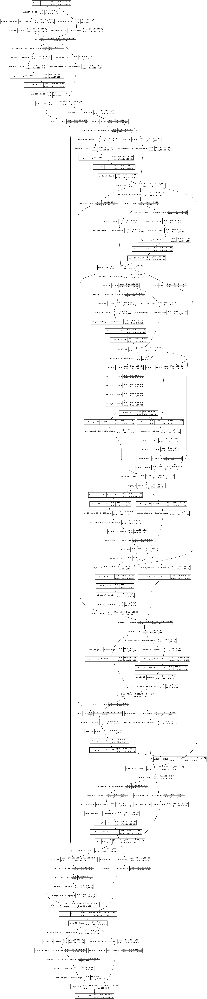

In [ ]:
tf.keras.utils.plot_model(my_model, show_shapes=True)

# Callbacks

In [14]:
class MetricsEval(keras.callbacks.Callback):
        def __init__(self,
                     filepath = None,
                     save_weights_only = False):
            
            super(MetricsEval, self).__init__()
            self.filepath = filepath
            self.save_weights_only = save_weights_only
        
        def on_train_begin(self, logs={}): #vale per validation in .fit e in test in .evaluate

            self.best = []
            self.metrics = []
            self.epochs = np.zeros(3)

            self.min_dice = 0. 
            self.min_hd = float("inf") 
            self.min_gce = float("inf")
            self.worst_metric = float("inf")

            #THE MODEL AT THE FIRST EPOCH IS CONSIDERED THE FIRST BEST MODEL
            if self.save_weights_only == False:
                self.model.save(filepath = self.filepath,
                                overwrite = True)
            elif self.save_weights_only == True:
                self.model.save_weights(filepath = self.filepath + '_weights',
                                        save_format = 'h5',
                                        overwrite = True)
        
        def on_epoch_end(self, epoch, logs={}):
            dice = logs.get('val_Mean_DICE')
            hd = logs.get('val_HD')
            gce = logs.get('val_GCE')

            metric = (1-dice) + hd + gce 
            if metric < self.worst_metric:
                self.worst_metric = metric
                self.best = ['Best is: Epoch_{} '.format(epoch+1), dice, hd, gce] #, self.epochs[0], self.epochs[1], self.epochs[2]]
                
                if self.save_weights_only == False:
                    self.model.save(filepath = self.filepath,
                                    overwrite = True)
                elif self.save_weights_only == True:
                    self.model.save_weights(filepath = self.filepath + '_weights',
                                            save_format = 'h5',
                                            overwrite = True)

#Manual path



##  Model.compile

In [ ]:
selected_loss = "Dice_CE" #@param ["CE", "WCE", "Focal", "TopK", "Dice", "HD", "Dice_CE", "Dice_Focal", "Dice_TopK", "Dice_HD"] {allow-input: true}

In [ ]:

if SELECTED_ARCHITECTURE == 'GoldStandard':
    arch = unet  
    my_model  = unet.build_model()
if SELECTED_ARCHITECTURE == 'QTNet':
    arch = qtnet
    my_model = qtnet.build_model()
if SELECTED_ARCHITECTURE == 'DRINet':
    arch = drinet
    my_model = drinet.build_model()
if SELECTED_ARCHITECTURE == 'IMUNet':
    arch = imunet
    my_model = imunet.build_model()

    
    
my_model.compile(loss = loss_dict[selected_loss],
                 #optimizer = tf.keras.optimizers.Adam(beta_1=0.9, beta_2=0.999, epsilon=1e-8),
                 optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001),
                 metrics = [Mean_DICE(num_classes= NUM_CLASSES),
                            Hausdorff_Distance(num_classes= NUM_CLASSES),
                            Global_Consistency_Error(num_classes= NUM_CLASSES, batch_size= BATCH_SIZE, threshold= GCE_THRESHOLD),
                            'accuracy'], #più metriche in una lista [, , , ]
                            
                 )

SELECTED_LOSS = loss_dict[selected_loss].name

if check_overwrite == False:    
    MODEL_NAME = SELECTED_ARCHITECTURE + "_" + SELECTED_LOSS + "_" + datetime.now(gettz("Europe/Rome")).strftime("%Y%m%d-%H%M%S")

    NETWORK_DIR =  os.path.join(MODEL_PATH, SELECTED_ARCHITECTURE) #ex CALLBACKS_DIR
    try:
        os.mkdir(NETWORK_DIR)
        with open(os.path.join(NETWORK_DIR, 'overview.csv'), mode = 'w') as output:
            writer = csv.writer(output)
            header = ['MODEL_NAME', 'Mean_DICE', 'HD', 'GCE']
            writer.writerow(header)
            output.close()

        print('1/4 |█___| : Parent Directory Created - overview.csv created ')
    except:
    
        with open(os.path.join(NETWORK_DIR, 'overview.csv'), mode = 'r') as input:
            
            reader = csv.reader(input)
            new_rows = []
            ordered_rows = []
            metric = []
            dirlist = []
            
            table = list(reader)
            header = table[0]
            row = table[1:]

            for filename in os.listdir(NETWORK_DIR):
                if os.path.isdir(os.path.join(NETWORK_DIR,filename)):
                    dirlist.append(filename)
            
            if row:
                column = list(zip(*row))[0]
                unmatched_csv = list(set(column)-set(dirlist))
                
                for r in row:
                    if r[0] not in unmatched_csv:
                        ctrl = (1-float(r[1])) + float(r[2]) + float(r[3])
                        r.append(ctrl)
                        new_rows.append(r)

                new_rows.sort(key=lambda x: x[4]) #riordino in base al criterio ctrl minore 
                for nr in new_rows:
                    ordered_rows.append(nr[:4]) #tolgo il valore di controllo ctrl
                    
            else:
                column = list(zip(*row)) #sarà una lista vuota [] se row è vuoto []

            unmatched_folder = list(set(dirlist)-set(column))
            for f in unmatched_folder:
                shutil.rmtree(os.path.join(NETWORK_DIR, f))

            os.remove(os.path.join(NETWORK_DIR, 'overview.csv'))

            with open(os.path.join(NETWORK_DIR, 'overview.csv'), mode = 'w') as output:
                writer = csv.writer(output)
                writer.writerow(header)
                writer.writerows(ordered_rows)
                output.close()
            
            input.close()
        
        print('1/4 |█___| : Parent Directory already exist - overview.csv updated ')
        pass
    
    #MODEL FOLDERS
    VERSIONS_DIR =  os.path.join(NETWORK_DIR, MODEL_NAME)
    try:
        os.mkdir(VERSIONS_DIR)
    except:
        raise ValueError('VERSIONS_DIR already exists!')
    print('2/4 |██__| : Network Version Directory created ')

    CHECKPOINTS_DIR =  os.path.join(VERSIONS_DIR, 'checkpoints')
    try:
        os.mkdir(CHECKPOINTS_DIR)
    except:
        raise ValueError('CHECKPOINTS_DIR already exists!')

    LOGS_DIR =  os.path.join(VERSIONS_DIR, 'logs')
    try:
        os.mkdir(LOGS_DIR)
    except:
        raise ValueError('LOGS_DIR already exists!')

    PROPERTIES_DIR =  os.path.join(VERSIONS_DIR, 'properties')
    try:
        os.mkdir(PROPERTIES_DIR)
    except:
        raise ValueError('PROPERTIES_DIR already exists!')
    print('3/4 |███_| : Subdirectories created ')
    
    log_dir = LOGS_DIR
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, update_freq = 'batch', profile_batch=0)
    
    check_overwrite = True
    
    print('4/4 |████| : Directories succesfully created!')

else:
    raise ValueError('Directories already created!')

1/4 |█___| : Parent Directory already exist - overview.csv updated 
2/4 |██__| : Network Version Directory created 
3/4 |███_| : Subdirectories created 
4/4 |████| : Directories succesfully created!


## Tensorboard

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir '$log_dir'

<IPython.core.display.Javascript object>

## Model.fit & Model.evaluate

In [ ]:
if check_overwrite == True:
    check_overwrite = False

    metric = MetricsEval(filepath = os.path.join(CHECKPOINTS_DIR, 'best_model'),
                     save_weights_only = False)
    
    with open(os.path.join(PROPERTIES_DIR, 'config.csv'), mode = 'w') as output:
        writer = csv.writer(output)
        header = [MODEL_NAME, None]
        writer.writerow(header)

        writer.writerow(['ARCHITECTURE_CONFIG', '***' ])
        for key, value in (arch.get_config()).items():
            writer.writerow([key, value])
        
        writer.writerow(['LOSS_CONFIG','***'])
        for key, value in (my_model.loss.get_config()).items():
            writer.writerow([key, value])
        
        writer.writerow(['OPTIMIZER_CONFIG','***'])
        for key, value in (my_model.optimizer.get_config()).items():
            writer.writerow([key, value])
        
        writer.writerow(['TRAINING_CONFIG','***'])
        for key, value in (train_prop).items():
            writer.writerow([key, value])
        
        output.close()

    history = my_model.fit(train_ds, 
                           epochs = EPOCHS,
                           verbose = 1,
                           validation_data = validation_ds,
                           callbacks=[tensorboard_callback, metric])
    
    best_model = tf.keras.models.load_model(os.path.join(CHECKPOINTS_DIR, 'best_model'),
                                            custom_objects = { my_model.loss.cname : my_model.loss,
                                                              'Mean_DICE': my_model.metrics[1], 
                                                              'Hausdorff_Distance': my_model.metrics[2], 
                                                              'Global_Consistency_Error': my_model.metrics[3]
                                                              }) 
    test_scores = best_model.evaluate(test_ds, verbose = 2)

    with open(os.path.join(NETWORK_DIR, 'overview.csv'), mode = 'a') as output:
        writer = csv.writer(output)
        test = [MODEL_NAME, round(test_scores[1],5), round(test_scores[2],5), round(test_scores[3],5)]
        writer.writerow(test)
        output.close()
    
else:
    raise ValueError("Create new Directories to save model")

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 1/70
46/46 [==============================] - 42s 653ms/step - loss: 0.3256 - Mean_DICE: 0.0139 - HD: 4.0214 - GCE: inf - accuracy: 0.9330 - val_loss: 8.1336 - val_Mean_DICE: 9.2005e-04 - val_HD: 6.6036 - val_GCE: inf - val_accuracy: 0.2245
Epoch 2/70
46/46 [==============================] - 26s 558ms/step - loss: 0.1286 - Mean_DICE: 0.0316 - HD: 3.7280 - GCE: inf - accuracy: 0.9706 - val_loss: 0.9964 - val_Mean_DICE: 0.0020 - val_HD: 5.3326 - val_GCE: inf - val_accuracy: 0.8537
Epoch 3/70
46/46 [==============================] - 26s 559ms/step - loss: 0.1052 - Mean_DICE: 0.0562 - HD: 3.5427 - GCE: inf - accuracy: 0.9757 - val_loss: 1.3937 - val_Mean_DICE: 0.0018 - val_HD: 5.5313 - val_GCE: inf - val_accuracy: 0.8430
Epoch 4/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0871 - Mean_DICE: 0.1003 - HD: 3.4049 - GCE: inf - accuracy: 0.9799 - val_loss: 1.4014 - val_Mean_DICE: 0.0019 - val_HD: 5.2754 - val_GCE: inf - val_accuracy: 0.8530
Epoch 5/70
46/46 [======

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 51s 1s/step - loss: 0.0445 - Mean_DICE: 0.6806 - HD: 2.8110 - GCE: 0.0077 - accuracy: 0.9893 - val_loss: 0.1747 - val_Mean_DICE: 0.4720 - val_HD: 3.1994 - val_GCE: 0.0186 - val_accuracy: 0.9663
Epoch 16/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0427 - Mean_DICE: 0.6990 - HD: 2.7833 - GCE: 0.0068 - accuracy: 0.9897 - val_loss: 0.2042 - val_Mean_DICE: 0.4947 - val_HD: 3.4309 - val_GCE: inf - val_accuracy: 0.9641
Epoch 17/70
46/46 [==============================] - ETA: 0s - loss: 0.0417 - Mean_DICE: 0.7427 - HD: 2.7289 - GCE: 0.0067 - accuracy: 0.9899INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 51s 1s/step - loss: 0.0417 - Mean_DICE: 0.7427 - HD: 2.7289 - GCE: 0.0067 - accuracy: 0.9899 - val_loss: 0.1306 - val_Mean_DICE: 0.6354 - val_HD: 3.1410 - val_GCE: 0.0152 - val_accuracy: 0.9744
Epoch 18/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0409 - Mean_DICE: 0.7444 - HD: 2.6390 - GCE: 0.0065 - accuracy: 0.9900 - val_loss: 0.1464 - val_Mean_DICE: 0.6330 - val_HD: 3.2172 - val_GCE: 0.0164 - val_accuracy: 0.9717
Epoch 19/70
46/46 [==============================] - ETA: 0s - loss: 0.0404 - Mean_DICE: 0.7277 - HD: 2.6752 - GCE: 0.0065 - accuracy: 0.9901INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0404 - Mean_DICE: 0.7277 - HD: 2.6752 - GCE: 0.0065 - accuracy: 0.9901 - val_loss: 0.1255 - val_Mean_DICE: 0.6581 - val_HD: 3.1143 - val_GCE: 0.0152 - val_accuracy: 0.9744
Epoch 20/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0403 - Mean_DICE: 0.7186 - HD: 2.6793 - GCE: 0.0066 - accuracy: 0.9901 - val_loss: 0.1932 - val_Mean_DICE: 0.6070 - val_HD: 3.2528 - val_GCE: 0.0183 - val_accuracy: 0.9676
Epoch 21/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0547 - Mean_DICE: 0.2606 - HD: 3.4114 - GCE: inf - accuracy: 0.9869 - val_loss: 4.9769 - val_Mean_DICE: 0.0020 - val_HD: 5.8796 - val_GCE: inf - val_accuracy: 0.6622
Epoch 22/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0677 - Mean_DICE: 0.6089 - HD: 2.8897 - GCE: 0.0080 - accuracy: 0.9838 - val_loss: 2.3644 - val_Mean_DICE: 0.0025 - val_HD: 5.2906 - val_GCE: inf - val_accuracy: 0.8144
Epoch 23/70
46/46 [=====

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0444 - Mean_DICE: 0.6486 - HD: 2.7979 - GCE: 0.0080 - accuracy: 0.9892 - val_loss: 0.0720 - val_Mean_DICE: 0.6817 - val_HD: 2.8335 - val_GCE: 0.0094 - val_accuracy: 0.9853
Epoch 26/70
46/46 [==============================] - ETA: 0s - loss: 0.0424 - Mean_DICE: 0.7225 - HD: 2.7118 - GCE: 0.0076 - accuracy: 0.9896INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0424 - Mean_DICE: 0.7225 - HD: 2.7118 - GCE: 0.0076 - accuracy: 0.9896 - val_loss: 0.0585 - val_Mean_DICE: 0.7411 - val_HD: 2.7203 - val_GCE: 0.0088 - val_accuracy: 0.9870
Epoch 27/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0445 - Mean_DICE: 0.7464 - HD: 2.6723 - GCE: 0.0076 - accuracy: 0.9891 - val_loss: 0.0700 - val_Mean_DICE: 0.6868 - val_HD: 2.8831 - val_GCE: 0.0101 - val_accuracy: 0.9843
Epoch 28/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0435 - Mean_DICE: 0.7137 - HD: 2.7151 - GCE: 0.0074 - accuracy: 0.9893 - val_loss: 0.0652 - val_Mean_DICE: 0.7228 - val_HD: 2.7174 - val_GCE: 0.0100 - val_accuracy: 0.9857
Epoch 29/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0411 - Mean_DICE: 0.7180 - HD: 2.7237 - GCE: 0.0068 - accuracy: 0.9898 - val_loss: 0.0700 - val_Mean_DICE: 0.7307 - val_HD: 2.8222 - val_GCE: 0.0103 - val_accuracy: 0.9845
Epoch 30/70
46/

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0399 - Mean_DICE: 0.7849 - HD: 2.5846 - GCE: 0.0063 - accuracy: 0.9901 - val_loss: 0.0574 - val_Mean_DICE: 0.7670 - val_HD: 2.6948 - val_GCE: 0.0089 - val_accuracy: 0.9868
Epoch 33/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0398 - Mean_DICE: 0.7722 - HD: 2.6202 - GCE: 0.0064 - accuracy: 0.9902 - val_loss: 0.0612 - val_Mean_DICE: 0.7617 - val_HD: 2.7124 - val_GCE: 0.0093 - val_accuracy: 0.9865
Epoch 34/70
46/46 [==============================] - ETA: 0s - loss: 0.0393 - Mean_DICE: 0.7821 - HD: 2.5698 - GCE: 0.0064 - accuracy: 0.9902INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 53s 1s/step - loss: 0.0393 - Mean_DICE: 0.7821 - HD: 2.5698 - GCE: 0.0064 - accuracy: 0.9902 - val_loss: 0.0524 - val_Mean_DICE: 0.7843 - val_HD: 2.6333 - val_GCE: 0.0082 - val_accuracy: 0.9880
Epoch 35/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0391 - Mean_DICE: 0.7727 - HD: 2.6229 - GCE: 0.0064 - accuracy: 0.9902 - val_loss: 0.0529 - val_Mean_DICE: 0.7951 - val_HD: 2.6502 - val_GCE: 0.0082 - val_accuracy: 0.9877
Epoch 36/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0389 - Mean_DICE: 0.7699 - HD: 2.6000 - GCE: 0.0063 - accuracy: 0.9903 - val_loss: 0.0587 - val_Mean_DICE: 0.7716 - val_HD: 2.7925 - val_GCE: 0.0089 - val_accuracy: 0.9864
Epoch 37/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0387 - Mean_DICE: 0.7496 - HD: 2.6006 - GCE: 0.0065 - accuracy: 0.9903 - val_loss: 0.0542 - val_Mean_DICE: 0.7784 - val_HD: 2.6581 - val_GCE: 0.0085 - val_accuracy: 0.9873
Epoch 38/70
46/

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0388 - Mean_DICE: 0.7500 - HD: 2.5860 - GCE: 0.0064 - accuracy: 0.9903 - val_loss: 0.0499 - val_Mean_DICE: 0.8042 - val_HD: 2.6145 - val_GCE: 0.0077 - val_accuracy: 0.9882
Epoch 39/70
46/46 [==============================] - ETA: 0s - loss: 0.0376 - Mean_DICE: 0.7685 - HD: 2.6894 - GCE: 0.0063 - accuracy: 0.9905INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 53s 1s/step - loss: 0.0376 - Mean_DICE: 0.7685 - HD: 2.6894 - GCE: 0.0063 - accuracy: 0.9905 - val_loss: 0.0493 - val_Mean_DICE: 0.7927 - val_HD: 2.5997 - val_GCE: 0.0075 - val_accuracy: 0.9883
Epoch 40/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0372 - Mean_DICE: 0.7713 - HD: 2.6644 - GCE: 0.0063 - accuracy: 0.9906 - val_loss: 0.0513 - val_Mean_DICE: 0.7797 - val_HD: 2.6345 - val_GCE: 0.0077 - val_accuracy: 0.9879
Epoch 41/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0368 - Mean_DICE: 0.7572 - HD: 2.6248 - GCE: 0.0062 - accuracy: 0.9907 - val_loss: 0.0505 - val_Mean_DICE: 0.7848 - val_HD: 2.6282 - val_GCE: 0.0075 - val_accuracy: 0.9881
Epoch 42/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0367 - Mean_DICE: 0.7699 - HD: 2.5702 - GCE: 0.0062 - accuracy: 0.9908 - val_loss: 0.0507 - val_Mean_DICE: 0.7888 - val_HD: 2.6447 - val_GCE: 0.0077 - val_accuracy: 0.9880
Epoch 43/70
46/

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 53s 1s/step - loss: 0.0356 - Mean_DICE: 0.7855 - HD: 2.5558 - GCE: 0.0061 - accuracy: 0.9910 - val_loss: 0.0520 - val_Mean_DICE: 0.7915 - val_HD: 2.5563 - val_GCE: 0.0079 - val_accuracy: 0.9878
Epoch 48/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0354 - Mean_DICE: 0.7896 - HD: 2.5139 - GCE: 0.0059 - accuracy: 0.9911 - val_loss: 0.0506 - val_Mean_DICE: 0.7898 - val_HD: 2.6067 - val_GCE: 0.0076 - val_accuracy: 0.9880
Epoch 49/70
46/46 [==============================] - ETA: 0s - loss: 0.0352 - Mean_DICE: 0.7850 - HD: 2.5216 - GCE: 0.0060 - accuracy: 0.9911INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0352 - Mean_DICE: 0.7850 - HD: 2.5216 - GCE: 0.0060 - accuracy: 0.9911 - val_loss: 0.0507 - val_Mean_DICE: 0.7960 - val_HD: 2.5435 - val_GCE: 0.0075 - val_accuracy: 0.9880
Epoch 50/70
46/46 [==============================] - ETA: 0s - loss: 0.0351 - Mean_DICE: 0.8027 - HD: 2.5492 - GCE: 0.0061 - accuracy: 0.9911INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 53s 1s/step - loss: 0.0351 - Mean_DICE: 0.8027 - HD: 2.5492 - GCE: 0.0061 - accuracy: 0.9911 - val_loss: 0.0492 - val_Mean_DICE: 0.8042 - val_HD: 2.5097 - val_GCE: 0.0073 - val_accuracy: 0.9882
Epoch 51/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0350 - Mean_DICE: 0.8161 - HD: 2.4718 - GCE: 0.0060 - accuracy: 0.9911 - val_loss: 0.0490 - val_Mean_DICE: 0.8055 - val_HD: 2.5211 - val_GCE: 0.0071 - val_accuracy: 0.9885
Epoch 52/70
46/46 [==============================] - ETA: 0s - loss: 0.0350 - Mean_DICE: 0.8113 - HD: 2.5008 - GCE: 0.0060 - accuracy: 0.9911INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211201-160102/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0350 - Mean_DICE: 0.8113 - HD: 2.5008 - GCE: 0.0060 - accuracy: 0.9911 - val_loss: 0.0480 - val_Mean_DICE: 0.8254 - val_HD: 2.4646 - val_GCE: 0.0070 - val_accuracy: 0.9886
Epoch 53/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0348 - Mean_DICE: 0.8029 - HD: 2.5066 - GCE: 0.0060 - accuracy: 0.9912 - val_loss: 0.0490 - val_Mean_DICE: 0.7924 - val_HD: 2.5627 - val_GCE: 0.0072 - val_accuracy: 0.9884
Epoch 54/70
46/46 [==============================] - 26s 557ms/step - loss: 0.0347 - Mean_DICE: 0.8176 - HD: 2.4921 - GCE: 0.0059 - accuracy: 0.9912 - val_loss: 0.0508 - val_Mean_DICE: 0.8024 - val_HD: 2.5563 - val_GCE: 0.0073 - val_accuracy: 0.9882
Epoch 55/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0345 - Mean_DICE: 0.8033 - HD: 2.5222 - GCE: 0.0058 - accuracy: 0.9913 - val_loss: 0.0473 - val_Mean_DICE: 0.8110 - val_HD: 2.5255 - val_GCE: 0.0070 - val_accuracy: 0.9889
Epoch 56/70
46/

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0342 - Mean_DICE: 0.8173 - HD: 2.4484 - GCE: 0.0057 - accuracy: 0.9914 - val_loss: 0.0476 - val_Mean_DICE: 0.8350 - val_HD: 2.4508 - val_GCE: 0.0069 - val_accuracy: 0.9888
Epoch 60/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0341 - Mean_DICE: 0.8111 - HD: 2.5090 - GCE: 0.0058 - accuracy: 0.9913 - val_loss: 0.0468 - val_Mean_DICE: 0.8128 - val_HD: 2.5000 - val_GCE: 0.0068 - val_accuracy: 0.9889
Epoch 61/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0341 - Mean_DICE: 0.8201 - HD: 2.5117 - GCE: 0.0059 - accuracy: 0.9913 - val_loss: 0.0496 - val_Mean_DICE: 0.8235 - val_HD: 2.4987 - val_GCE: 0.0070 - val_accuracy: 0.9885
Epoch 62/70
46/46 [==============================] - ETA: 0s - loss: 0.0339 - Mean_DICE: 0.8147 - HD: 2.4612 - GCE: 0.0058 - accuracy: 0.9914INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_Dic

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 53s 1s/step - loss: 0.0339 - Mean_DICE: 0.8147 - HD: 2.4612 - GCE: 0.0058 - accuracy: 0.9914 - val_loss: 0.0445 - val_Mean_DICE: 0.8402 - val_HD: 2.4230 - val_GCE: 0.0066 - val_accuracy: 0.9894
Epoch 63/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0336 - Mean_DICE: 0.8183 - HD: 2.4672 - GCE: 0.0058 - accuracy: 0.9915 - val_loss: 0.0467 - val_Mean_DICE: 0.8235 - val_HD: 2.4992 - val_GCE: 0.0069 - val_accuracy: 0.9890
Epoch 64/70
46/46 [==============================] - 26s 559ms/step - loss: 0.0335 - Mean_DICE: 0.8081 - HD: 2.5114 - GCE: 0.0058 - accuracy: 0.9915 - val_loss: 0.0478 - val_Mean_DICE: 0.8224 - val_HD: 2.5280 - val_GCE: 0.0070 - val_accuracy: 0.9887
Epoch 65/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0336 - Mean_DICE: 0.8023 - HD: 2.4769 - GCE: 0.0057 - accuracy: 0.9915 - val_loss: 0.0510 - val_Mean_DICE: 0.8186 - val_HD: 2.4567 - val_GCE: 0.0075 - val_accuracy: 0.9879
Epoch 66/70
46/

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 52s 1s/step - loss: 0.0332 - Mean_DICE: 0.8126 - HD: 2.4412 - GCE: 0.0057 - accuracy: 0.9916 - val_loss: 0.0461 - val_Mean_DICE: 0.8578 - val_HD: 2.4068 - val_GCE: 0.0066 - val_accuracy: 0.9890
Epoch 70/70
46/46 [==============================] - 26s 558ms/step - loss: 0.0331 - Mean_DICE: 0.8059 - HD: 2.5023 - GCE: 0.0057 - accuracy: 0.9916 - val_loss: 0.0461 - val_Mean_DICE: 0.8345 - val_HD: 2.4951 - val_GCE: 0.0067 - val_accuracy: 0.9891
6/6 - 5s - loss: 0.0793 - Mean_DICE: 0.8545 - HD: 2.3853 - GCE: 0.0123 - accuracy: 0.9839 - 5s/epoch - 861ms/step


## Past Model Loading

In [ ]:
#SE SALVO SOLO PESI:
##1) ricompilo il modello cone metriche e loss che volglio e ottengo my_model
##2) per ripristinarlo faccio my_model.load_weights(filename)
##3) posso rifare my_model.evaluate
my_model.load_weights('/content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/QTNet/QTNet_DiceTopKLoss_Epochs50_BatchSize8/checkpoints/fit_20211118-103251/best_model_congetconfig__lastepochweights')

In [15]:
#SE SALVO TUTTO
##1) posso non ricompilare, ma devo passare comunque le loss e le metriche

LOADING_PATH = '/content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models/IMUNet/IMUNet_DiceCE_20211129-180755/checkpoints/best_model' #inserire path del modello da caricare
LOADED_MODEL_NAME = os.path.split(os.path.dirname(os.path.dirname(LOADING_PATH)))[1]
load_model = tf.keras.models.load_model(LOADING_PATH,
                                        custom_objects = {'Dice_CE': Dice_CE, #da modificare ogni volta
                                                            'Mean_DICE': Mean_DICE, 
                                                            'Hausdorff_Distance': Hausdorff_Distance, 
                                                            'Global_Consistency_Error': Global_Consistency_Error
                                                            })

## Model.evaluate & Model.predict

In [16]:
#.evaluate del modello caricato in #Past Model Loading

test_scores_l = load_model.evaluate(test_ds, verbose = 2)
prediction = load_model.predict(test_ds)
print(test_scores_l)

6/6 - 16s - loss: 0.0869 - Mean_DICE: 0.8515 - HD: 2.3280 - GCE: 0.0116 - 16s/epoch - 3s/step
[0.08685175329446793, 0.8514774441719055, 2.3279738426208496, 0.011615906842052937]


In [ ]:
#.evaluate del best_model corrente fittato in #Model.fit

test_scores = best_model.evaluate(test_ds, verbose = 2)
prediction = best_model.predict(test_ds)
print(test_scores)

# Prediction Plotting 

Batch n°:  0


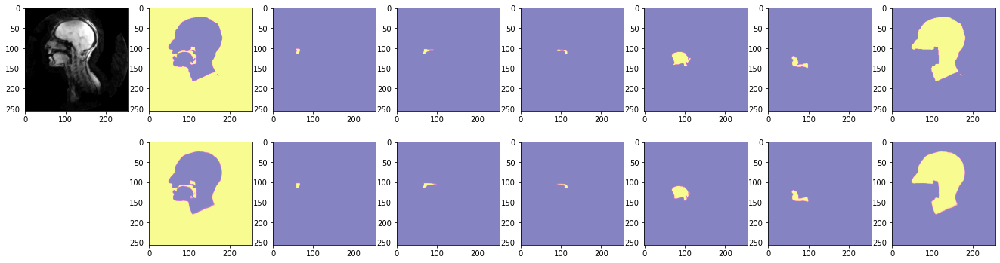

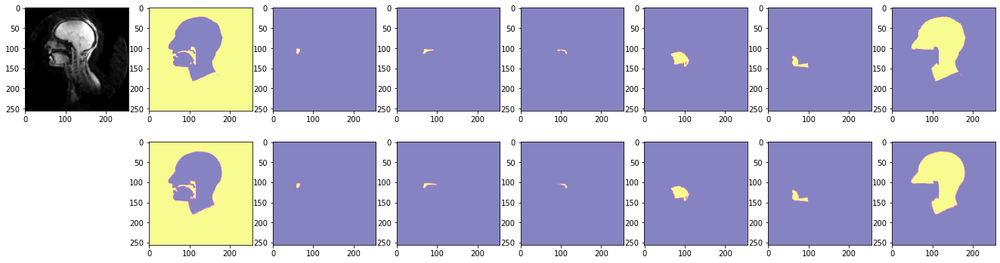

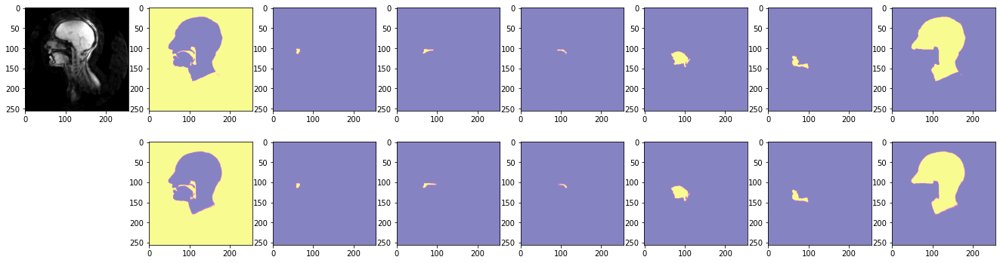

KeyboardInterrupt: ignored

In [22]:
batch_n = 0
n_volume = 0

for batch in test_ds.take(BATCH_NUM_TEST):  #rendi meno hard code (prende un batch alla volta)
    volume_batch, label_batch = batch
    print("Batch n°: ", batch_n)
    batch_n = batch_n + 1
    
    for volume, label in zip(volume_batch, label_batch):  #(prende un immagine del sopracitatao batch alla volta)
        
        fig = plt.figure(figsize = [23, 6]) #creo ogni ciclo la figura bianca
        plt.subplot(2, (NUM_CLASSES + 1), 1) #creo le colonne e le righe
        plt.imshow(volume[:,:,0], cmap="gray") #ploto l'immagine

        for i in range(NUM_CLASSES): #(per ciascuna immagine cicla sulle classi)
            
            plt.subplot(2, (NUM_CLASSES + 1), i+2) #muovo l'indice di colonna per plottare le varie classi 
            plt.imshow(label[:,:,i], cmap="plasma", alpha=0.5) #plotto le classi
            plt.subplot(2, (NUM_CLASSES + 1), i+10)
            plt.imshow(prediction[n_volume,:,:,i], cmap="plasma", alpha=0.5)
        
        n_volume = n_volume + 1
    
    n_volume = 0
    plt.show(fig) #stampo il tutto

In [ ]:
np.percentile(prediction[1,:,:], [1, 50, 75, 85, 86, 87, 88, 89, 90, 99])

array([7.10738857e-23, 1.96353750e-13, 4.14757082e-08, 4.58445160e-03,
       9.40270450e-01, 9.99826416e-01, 9.99991059e-01, 9.99998212e-01,
       9.99999642e-01, 1.00000000e+00])

#Hyperparameters dashboard


In [ ]:
%load_ext tensorboard

In [ ]:
log_hp = '/content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi'
%tensorboard --logdir '$log_hp'

In [ ]:
HP_DENSEDEPTH = hp.HParam('dense_depth', hp.Discrete([6, 10, 12]))
HP_
HP_ACTIVATION = hp.HParam('activation', hp.Discrete(['linear', 'relu', 'exponential' ]))
HP_OPTIMIZER = hp.HParam('optimizer', hp.Discrete(['adam', 'sgd']))

with tf.summary.create_file_writer(log_hp + '/hparam_tuning').as_default():
  hp.hparams_config(
    hparams = [HP_DEPTH, HP_ACTIVATION, HP_OPTIMIZER],
    metrics = [hp.Metric('Mean_Dice'),
               hp.Metric('Hausdorff_Distance'),
               hp.Metric('Global_Consistency_Error')]
  )

In [ ]:
qtnet = QT_Net(depth = hparams[HP_DEPTH],
               activation_conv = hparams[HP_ACTIVATION],)


my_model = qtnet.build_model()

In [ ]:
my_model.compile(loss = loss_dict[selected_loss],
                 #optimizer = tf.keras.optimizers.Adam(beta_1=0.9, beta_2=0.999, epsilon=1e-8),
                 optimizer = hparams[HP_OPTIMIZER],
                 metrics = [Mean_DICE(num_classes= NUM_CLASSES),
                            Hausdorff_Distance(num_classes= NUM_CLASSES),
                            Global_Consistency_Error(num_classes= NUM_CLASSES, batch_size= BATCH_SIZE, threshold= GCE_THRESHOLD)] #più metriche in una lista [, , , ]
                 )

# Automatic gridsearch

In [ ]:
class gridsearch():

    def __init__(self, 
                 loss_dict = [],
                 train_properties = [],

                 model = None,
                 selected_architecture = None,

                 train_ds = None,
                 validation_ds = None,
                 test_ds = None,

                 project_path = None,
                 
                ):
        
        self.loss_dict = loss_dict
        self.train_properties = train_properties

        self.model = model
        self.selected_architecture = selected_architecture

        self.train_ds = train_ds
        self.validation_ds = validation_ds
        self.test_ds = test_ds

        self.project_path = project_path

        self.prediction = []
        self.model_scores = []

        #PARENT DIRECTORY 
        self.gridsearch_dir = os.path.join(self.project_path, 'Models_Gridsearch')
        try:
            os.mkdir(self.gridsearch_dir)
        except:
            pass
 
        self.date = datetime.now(gettz("Europe/Rome")).strftime("%Y%m%d-%H%M%S" )
        self.gridsearch_network_dir = os.path.join(self.gridsearch_dir, self.selected_architecture + "_" + self.date )
 
        %load_ext tensorboard
    
    def evaluate(self): 
        #LOOP FOR ALL LOSSES EVALUATION 
        l = 0
        for ls in self.loss_dict:
            
            loss = list(self.loss_dict.keys())[l]

            #MODEL NAME EXTRACTION
            self.model_name = self.selected_architecture + "_" + self.loss_dict[ls].name + "_" + self.date
            
            #DIRECTORIES CREATION
            try:
                #OVERVIEW CSV CREATION
                os.mkdir(self.gridsearch_network_dir)
                with open(os.path.join(self.gridsearch_network_dir, 'overview.csv'), mode = 'w') as output:
                    writer = csv.writer(output)
                    header = ['MODEL NAME', 'Mean_DICE', 'HD', 'GCE']
                    writer.writerow(header)
                    output.close()

            except:

                #OVERVIEW CSV CHECK AND ORDERING
                with open(os.path.join(self.gridsearch_network_dir, 'overview.csv'), mode = 'r') as input:
                    
                    reader = csv.reader(input)
                    new_rows = []
                    ordered_rows = []
                    metric = []
                    dirlist = []
                    
                    table = list(reader)
                    header = table[0]
                    row = table[1:]

                    for filename in os.listdir(self.gridsearch_network_dir):
                        if os.path.isdir(os.path.join(self.gridsearch_network_dir,filename)):
                            dirlist.append(filename)
                    
                    if row:
                        column = list(zip(*row))[0]
                        unmatched_csv = list(set(column)-set(dirlist))
                        
                        for r in row:
                            if r[0] not in unmatched_csv:
                                ctrl = (1-float(r[1])) + float(r[2]) + float(r[3])
                                r.append(ctrl)
                                new_rows.append(r)

                        new_rows.sort(key=lambda x: x[4]) #riordino in base al criterio ctrl minore 
                        for nr in new_rows:
                            ordered_rows.append(nr[:4]) #tolgo il valore di controllo ctrl
                            
                    else:
                        column = list(zip(*row)) #sarà una lista vuota [] se row è vuoto []

                    unmatched_folder = list(set(dirlist)-set(column))
                    for f in unmatched_folder:
                        shutil.rmtree(os.path.join(self.gridsearch_network_dir, f))

                    os.remove(os.path.join(self.gridsearch_network_dir, 'overview.csv'))

                    with open(os.path.join(self.gridsearch_network_dir, 'overview.csv'), mode = 'w') as output:
                        writer = csv.writer(output)
                        writer.writerow(header)
                        writer.writerows(ordered_rows)
                        output.close()
                    
                    input.close()
                pass

            version_dir =  os.path.join(self.gridsearch_network_dir, self.model_name)
            try:
                os.mkdir(version_dir)
            except:
                raise ValueError('VERSIONS_DIR already exists!')

            checkpoints_dir =  os.path.join(version_dir, 'checkpoints')
            try:
                os.mkdir(checkpoints_dir)
            except:
                raise ValueError('CHECKPOINTS_DIR already exists!')

            logs_dir =  os.path.join(version_dir, 'logs')
            try:
                os.mkdir(logs_dir)
            except:
                raise ValueError('LOGS_DIR already exists!')

            properties_dir =  os.path.join(version_dir, 'properties')
            try:
                os.mkdir(properties_dir)
            except:
                raise ValueError('PROPERTIES_DIR already exists!')

            #TENSORBOARD
            self.tb_logdir = logs_dir #, MODEL_NAME, 'logs')
            
            #CALLBACKS
            tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir= self.tb_logdir, update_freq = 'batch', profile_batch=0)
            
            metrics_eval = MetricsEval(filepath = os.path.join(checkpoints_dir, 'best_model'),
                                       save_weights_only = False)
            
            callbacks = [tensorboard_callback, metrics_eval ]

            #MODEL COMPILE
            current_model = self.model.build_model()
            current_model.compile(loss = self.loss_dict[ls],
                                 #optimizer = tf.keras.optimizers.Adam(beta_1=0.9, beta_2=0.999, epsilon=1e-8),
                                 optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001),
                                 metrics = [Mean_DICE(num_classes= NUM_CLASSES),
                                            Hausdorff_Distance(num_classes= NUM_CLASSES),
                                            Global_Consistency_Error(num_classes= NUM_CLASSES, batch_size= self.train_properties['BATCH_SIZE'], threshold= GCE_THRESHOLD)] #più metriche in una lista [, , , ]
                                 )
            
            #CONFIG CSV WRITER 
            with open(os.path.join(properties_dir, 'config.csv'), mode = 'w') as output:
                writer = csv.writer(output)
                header = [self.model_name, None]
                writer.writerow(header)

                writer.writerow(['ARCHITECTURE_CONFIG', '***' ])
                for key, value in (self.model.get_config()).items():
                    writer.writerow([key, value])
                
                writer.writerow(['LOSS_CONFIG','***'])
                for key, value in (current_model.loss.get_config()).items():
                    writer.writerow([key, value])
                
                writer.writerow(['OPTIMIZER_CONFIG','***'])
                for key, value in (current_model.optimizer.get_config()).items():
                    writer.writerow([key, value])
                
                writer.writerow(['TRAINING_CONFIG','***'])
                for key, value in (self.train_properties).items():
                    writer.writerow([key, value])
                
                output.close()

            
            #MODEL FIT
            history = current_model.fit(self.train_ds, 
                                        epochs = self.train_properties['EPOCHS'],
                                        verbose = 1,
                                        validation_data = self.validation_ds,
                                        callbacks = callbacks)
            
            #RECOVERY BEST MODEL
            current_best_model = tf.keras.models.load_model(os.path.join(checkpoints_dir, 'best_model'),
                                            custom_objects = { current_model.loss.cname : current_model.loss,
                                                              'Mean_DICE': current_model.metrics[1], 
                                                              'Hausdorff_Distance': current_model.metrics[2], 
                                                              'Global_Consistency_Error': current_model.metrics[3]
                                                              }) 
            
            #MODEL EVALUATE
            test_scores = current_best_model.evaluate(self.test_ds, verbose = 2)

            #MODEL PREDICTION
            self.prediction.append(current_model.predict(self.test_ds)) #non testato

            #OVERVIEW CSV UPDATING
            with open(os.path.join(self.gridsearch_network_dir, 'overview.csv'), mode = 'a') as output:
                writer = csv.writer(output)
                test = [self.model_name, round(test_scores[1],5), round(test_scores[2],5), round(test_scores[3],5)]
                writer.writerow(test)
                output.close()



In [ ]:
gs = gridsearch(loss_dict= loss_dict,
                train_properties = train_prop,

                train_ds = train_ds,
                validation_ds = validation_ds,
                test_ds = test_ds,

                model = imunet,
                selected_architecture = SELECTED_ARCHITECTURE,

                project_path = PROJECT_PATH,
            )


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir '$gs.gridsearch_network_dir'

<IPython.core.display.Javascript object>

In [ ]:
gs.evaluate()

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models_Gridsearch/IMUNet_20211130-170341/IMUNet_DiceCE_20211130-170341/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 1/70
46/46 [==============================] - 35s 567ms/step - loss: 0.3313 - Mean_DICE: 0.0727 - HD: 3.9907 - GCE: inf - val_loss: 1.4367 - val_Mean_DICE: 0.0035 - val_HD: 5.3083 - val_GCE: inf
Epoch 2/70
46/46 [==============================] - 24s 519ms/step - loss: 0.1157 - Mean_DICE: 0.1213 - HD: 3.6712 - GCE: inf - val_loss: 1.4484 - val_Mean_DICE: 0.0026 - val_HD: 4.9353 - val_GCE: inf
Epoch 3/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0927 - Mean_DICE: 0.1665 - HD: 3.5131 - GCE: inf - val_loss: 1.7498 - val_Mean_DICE: 0.0017 - val_HD: 5.5814 - val_GCE: inf
Epoch 4/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0790 - Mean_DICE: 0.2330 - HD: 3.3562 - GCE: inf - val_loss: 1.3763 - val_Mean_DICE: 0.0024 - val_HD: 5.1428 - val_GCE: inf
Epoch 5/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0682 - Mean_DICE: 0.3313 - HD: 3.2889 - GCE: inf - val_loss: 1.5043 - val_Mean_DICE: 0.0022 - val_HD: 5.4522 - val_GCE:

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 18/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0378 - Mean_DICE: 0.7607 - HD: 2.6382 - GCE: 0.0066 - val_loss: 0.0875 - val_Mean_DICE: 0.7447 - val_HD: 2.9389 - val_GCE: 0.0121
Epoch 19/70
46/46 [==============================] - 41s 898ms/step - loss: 0.0373 - Mean_DICE: 0.7797 - HD: 2.5666 - GCE: 0.0064 - val_loss: 0.0658 - val_Mean_DICE: 0.7737 - val_HD: 2.6176 - val_GCE: 0.0095


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 20/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0364 - Mean_DICE: 0.7775 - HD: 2.6507 - GCE: 0.0062 - val_loss: 0.1257 - val_Mean_DICE: 0.7342 - val_HD: 3.1616 - val_GCE: 0.0153
Epoch 21/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0368 - Mean_DICE: 0.7703 - HD: 2.6289 - GCE: 0.0063 - val_loss: 0.1395 - val_Mean_DICE: 0.7498 - val_HD: 3.1453 - val_GCE: 0.0141
Epoch 22/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0369 - Mean_DICE: 0.7682 - HD: 2.6084 - GCE: 0.0062 - val_loss: 0.2130 - val_Mean_DICE: 0.7629 - val_HD: 3.4280 - val_GCE: 0.0170
Epoch 23/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0369 - Mean_DICE: 0.7676 - HD: 2.6483 - GCE: 0.0061 - val_loss: 0.0812 - val_Mean_DICE: 0.7747 - val_HD: 2.7351 - val_GCE: 0.0105
Epoch 24/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0370 - Mean_DICE: 0.7750 - HD: 2.5641 - GCE: 0.0060 - val_loss: 0.1079 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 26/70
46/46 [==============================] - 40s 880ms/step - loss: 0.0373 - Mean_DICE: 0.7880 - HD: 2.5097 - GCE: 0.0058 - val_loss: 0.0728 - val_Mean_DICE: 0.8180 - val_HD: 2.6195 - val_GCE: 0.0091


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 27/70
46/46 [==============================] - ETA: 0s - loss: 0.0371 - Mean_DICE: 0.7875 - HD: 2.5794 - GCE: 0.0058INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models_Gridsearch/IMUNet_20211130-170341/IMUNet_DiceCE_20211130-170341/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 40s 885ms/step - loss: 0.0371 - Mean_DICE: 0.7875 - HD: 2.5794 - GCE: 0.0058 - val_loss: 0.0646 - val_Mean_DICE: 0.8300 - val_HD: 2.5355 - val_GCE: 0.0086
Epoch 28/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0369 - Mean_DICE: 0.7876 - HD: 2.5230 - GCE: 0.0058 - val_loss: 0.0573 - val_Mean_DICE: 0.8226 - val_HD: 2.5423 - val_GCE: 0.0076
Epoch 29/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0364 - Mean_DICE: 0.7979 - HD: 2.5257 - GCE: 0.0058 - val_loss: 0.0945 - val_Mean_DICE: 0.8041 - val_HD: 2.8867 - val_GCE: 0.0105
Epoch 30/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0361 - Mean_DICE: 0.7939 - HD: 2.5277 - GCE: 0.0059 - val_loss: 0.0705 - val_Mean_DICE: 0.8092 - val_HD: 2.6065 - val_GCE: 0.0099
Epoch 31/70
46/46 [==============================] - 41s 894ms/step - loss: 0.0357 - Mean_DICE: 0.8026 - HD: 2.5087 - GCE: 0.0057 - val_loss: 0.0592 - val_Mean_DICE: 0.8171 - val_H

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 32/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0354 - Mean_DICE: 0.8086 - HD: 2.4959 - GCE: 0.0057 - val_loss: 0.0589 - val_Mean_DICE: 0.8273 - val_HD: 2.5904 - val_GCE: 0.0084
Epoch 33/70
46/46 [==============================] - 41s 900ms/step - loss: 0.0352 - Mean_DICE: 0.8057 - HD: 2.4346 - GCE: 0.0057 - val_loss: 0.0485 - val_Mean_DICE: 0.8397 - val_HD: 2.4089 - val_GCE: 0.0066


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 34/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0348 - Mean_DICE: 0.8054 - HD: 2.4616 - GCE: 0.0058 - val_loss: 0.0530 - val_Mean_DICE: 0.8333 - val_HD: 2.4625 - val_GCE: 0.0071
Epoch 35/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0346 - Mean_DICE: 0.8100 - HD: 2.4444 - GCE: 0.0057 - val_loss: 0.0735 - val_Mean_DICE: 0.8055 - val_HD: 2.6468 - val_GCE: 0.0100
Epoch 36/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0347 - Mean_DICE: 0.8032 - HD: 2.4658 - GCE: 0.0059 - val_loss: 0.0529 - val_Mean_DICE: 0.8322 - val_HD: 2.4378 - val_GCE: 0.0071
Epoch 37/70
46/46 [==============================] - 40s 879ms/step - loss: 0.0346 - Mean_DICE: 0.8042 - HD: 2.4800 - GCE: 0.0058 - val_loss: 0.0511 - val_Mean_DICE: 0.8355 - val_HD: 2.3972 - val_GCE: 0.0068


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 38/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0344 - Mean_DICE: 0.8031 - HD: 2.5267 - GCE: 0.0058 - val_loss: 0.0513 - val_Mean_DICE: 0.8299 - val_HD: 2.4266 - val_GCE: 0.0069
Epoch 39/70
46/46 [==============================] - 41s 897ms/step - loss: 0.0339 - Mean_DICE: 0.8115 - HD: 2.4122 - GCE: 0.0057 - val_loss: 0.0492 - val_Mean_DICE: 0.8352 - val_HD: 2.3567 - val_GCE: 0.0065


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 40/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0337 - Mean_DICE: 0.8025 - HD: 2.4583 - GCE: 0.0058 - val_loss: 0.0525 - val_Mean_DICE: 0.8325 - val_HD: 2.5302 - val_GCE: 0.0069
Epoch 41/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0338 - Mean_DICE: 0.7984 - HD: 2.4814 - GCE: 0.0058 - val_loss: 0.0498 - val_Mean_DICE: 0.8369 - val_HD: 2.4170 - val_GCE: 0.0065
Epoch 42/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0336 - Mean_DICE: 0.7971 - HD: 2.5226 - GCE: 0.0057 - val_loss: 0.0503 - val_Mean_DICE: 0.8343 - val_HD: 2.4161 - val_GCE: 0.0067
Epoch 43/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0336 - Mean_DICE: 0.7972 - HD: 2.5042 - GCE: 0.0058 - val_loss: 0.0720 - val_Mean_DICE: 0.8005 - val_HD: 2.7376 - val_GCE: 0.0097
Epoch 44/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0336 - Mean_DICE: 0.7962 - HD: 2.4696 - GCE: 0.0058 - val_loss: 0.0489 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 51/70
46/46 [==============================] - 40s 880ms/step - loss: 0.0328 - Mean_DICE: 0.8024 - HD: 2.5056 - GCE: 0.0057 - val_loss: 0.0480 - val_Mean_DICE: 0.8489 - val_HD: 2.3349 - val_GCE: 0.0062


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 52/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0325 - Mean_DICE: 0.8026 - HD: 2.4648 - GCE: 0.0056 - val_loss: 0.0467 - val_Mean_DICE: 0.8473 - val_HD: 2.4205 - val_GCE: 0.0065
Epoch 53/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0327 - Mean_DICE: 0.8067 - HD: 2.4676 - GCE: 0.0057 - val_loss: 0.0461 - val_Mean_DICE: 0.8429 - val_HD: 2.3628 - val_GCE: 0.0062
Epoch 54/70
46/46 [==============================] - 41s 904ms/step - loss: 0.0324 - Mean_DICE: 0.8086 - HD: 2.4568 - GCE: 0.0055 - val_loss: 0.0479 - val_Mean_DICE: 0.8387 - val_HD: 2.3219 - val_GCE: 0.0067


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 55/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0321 - Mean_DICE: 0.8122 - HD: 2.4561 - GCE: 0.0056 - val_loss: 0.0589 - val_Mean_DICE: 0.8448 - val_HD: 2.4897 - val_GCE: 0.0074
Epoch 56/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0322 - Mean_DICE: 0.8028 - HD: 2.4711 - GCE: 0.0055 - val_loss: 0.0606 - val_Mean_DICE: 0.8016 - val_HD: 2.5316 - val_GCE: 0.0081
Epoch 57/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0322 - Mean_DICE: 0.8068 - HD: 2.5024 - GCE: 0.0056 - val_loss: 0.0452 - val_Mean_DICE: 0.8502 - val_HD: 2.4117 - val_GCE: 0.0062
Epoch 58/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0321 - Mean_DICE: 0.8038 - HD: 2.4641 - GCE: 0.0056 - val_loss: 0.0525 - val_Mean_DICE: 0.8348 - val_HD: 2.4725 - val_GCE: 0.0074
Epoch 59/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0320 - Mean_DICE: 0.8131 - HD: 2.4345 - GCE: 0.0055 - val_loss: 0.0470 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 67/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0318 - Mean_DICE: 0.8193 - HD: 2.4178 - GCE: 0.0055 - val_loss: 0.0442 - val_Mean_DICE: 0.8455 - val_HD: 2.4007 - val_GCE: 0.0064
Epoch 68/70
46/46 [==============================] - ETA: 0s - loss: 0.0315 - Mean_DICE: 0.8197 - HD: 2.4263 - GCE: 0.0055INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models_Gridsearch/IMUNet_20211130-170341/IMUNet_DiceCE_20211130-170341/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 40s 887ms/step - loss: 0.0315 - Mean_DICE: 0.8197 - HD: 2.4263 - GCE: 0.0055 - val_loss: 0.0465 - val_Mean_DICE: 0.8508 - val_HD: 2.2973 - val_GCE: 0.0061
Epoch 69/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0314 - Mean_DICE: 0.8217 - HD: 2.4100 - GCE: 0.0055 - val_loss: 0.0467 - val_Mean_DICE: 0.8453 - val_HD: 2.3492 - val_GCE: 0.0063
Epoch 70/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0314 - Mean_DICE: 0.8134 - HD: 2.4362 - GCE: 0.0056 - val_loss: 0.0457 - val_Mean_DICE: 0.8547 - val_HD: 2.3835 - val_GCE: 0.0060
6/6 - 4s - loss: 0.0895 - Mean_DICE: 0.8399 - HD: 2.4065 - GCE: 0.0120 - 4s/epoch - 688ms/step
INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models_Gridsearch/IMUNet_20211130-170341/IMUNet_DiceFocal_20211130-170341/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 1/70
46/46 [==============================] - 35s 568ms/step - loss: 0.2458 - Mean_DICE: 0.0776 - HD: 3.9157 - GCE: inf - val_loss: 5.2184 - val_Mean_DICE: 0.0015 - val_HD: 6.6521 - val_GCE: inf
Epoch 2/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0875 - Mean_DICE: 0.1414 - HD: 3.6061 - GCE: inf - val_loss: 3.6801 - val_Mean_DICE: 0.0022 - val_HD: 6.8005 - val_GCE: inf
Epoch 3/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0667 - Mean_DICE: 0.2045 - HD: 3.4901 - GCE: inf - val_loss: 1.0846 - val_Mean_DICE: 0.0023 - val_HD: 5.7741 - val_GCE: inf
Epoch 4/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0588 - Mean_DICE: 0.2765 - HD: 3.2727 - GCE: inf - val_loss: 1.0025 - val_Mean_DICE: 0.0022 - val_HD: 5.6491 - val_GCE: inf
Epoch 5/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0521 - Mean_DICE: 0.3580 - HD: 3.1516 - GCE: inf - val_loss: 0.9698 - val_Mean_DICE: 0.0026 - val_HD: 5.0352 - val_GCE:

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 40s 888ms/step - loss: 0.0282 - Mean_DICE: 0.7265 - HD: 2.5468 - GCE: 0.0072 - val_loss: 0.1122 - val_Mean_DICE: 0.6318 - val_HD: 3.1464 - val_GCE: 0.0183
Epoch 18/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0278 - Mean_DICE: 0.7289 - HD: 2.5866 - GCE: 0.0072 - val_loss: 0.1178 - val_Mean_DICE: 0.6715 - val_HD: 3.1984 - val_GCE: 0.0192
Epoch 19/70
46/46 [==============================] - 40s 874ms/step - loss: 0.0274 - Mean_DICE: 0.7480 - HD: 2.5397 - GCE: 0.0071 - val_loss: 0.0851 - val_Mean_DICE: 0.6719 - val_HD: 2.7154 - val_GCE: 0.0144


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 20/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0272 - Mean_DICE: 0.7297 - HD: 2.5852 - GCE: 0.0071 - val_loss: 0.1033 - val_Mean_DICE: 0.7096 - val_HD: 3.0394 - val_GCE: 0.0168
Epoch 21/70
46/46 [==============================] - 24s 519ms/step - loss: 0.0268 - Mean_DICE: 0.7500 - HD: 2.5543 - GCE: 0.0071 - val_loss: 0.2493 - val_Mean_DICE: 0.6032 - val_HD: 3.6664 - val_GCE: 0.0267
Epoch 22/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0269 - Mean_DICE: 0.7384 - HD: 2.5958 - GCE: inf - val_loss: 0.2990 - val_Mean_DICE: 0.7405 - val_HD: 3.7541 - val_GCE: 0.0238
Epoch 23/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0266 - Mean_DICE: 0.7363 - HD: 2.5986 - GCE: 0.0070 - val_loss: 0.1004 - val_Mean_DICE: 0.7598 - val_HD: 3.1335 - val_GCE: 0.0161
Epoch 24/70
46/46 [==============================] - 41s 891ms/step - loss: 0.0264 - Mean_DICE: 0.7467 - HD: 2.5414 - GCE: 0.0070 - val_loss: 0.0591 - val_Mean_DICE: 0.765

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 25/70
46/46 [==============================] - 40s 886ms/step - loss: 0.0259 - Mean_DICE: 0.7376 - HD: 2.6293 - GCE: 0.0069 - val_loss: 0.0474 - val_Mean_DICE: 0.7896 - val_HD: 2.4288 - val_GCE: 0.0087


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 26/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0260 - Mean_DICE: 0.7549 - HD: 2.4978 - GCE: 0.0070 - val_loss: 0.0577 - val_Mean_DICE: 0.7585 - val_HD: 2.4844 - val_GCE: 0.0100
Epoch 27/70
46/46 [==============================] - 41s 895ms/step - loss: 0.0256 - Mean_DICE: 0.7519 - HD: 2.5373 - GCE: 0.0068 - val_loss: 0.0480 - val_Mean_DICE: 0.8017 - val_HD: 2.4383 - val_GCE: 0.0087


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 28/70
46/46 [==============================] - 40s 885ms/step - loss: 0.0253 - Mean_DICE: 0.7450 - HD: 2.5200 - GCE: 0.0069 - val_loss: 0.0452 - val_Mean_DICE: 0.7975 - val_HD: 2.3832 - val_GCE: 0.0085


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 29/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0251 - Mean_DICE: 0.7633 - HD: 2.4897 - GCE: 0.0069 - val_loss: 0.0433 - val_Mean_DICE: 0.7773 - val_HD: 2.3818 - val_GCE: 0.0081
Epoch 30/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0252 - Mean_DICE: 0.7691 - HD: 2.4434 - GCE: 0.0069 - val_loss: 0.0471 - val_Mean_DICE: 0.7833 - val_HD: 2.4075 - val_GCE: 0.0089
Epoch 31/70
46/46 [==============================] - 24s 520ms/step - loss: 0.0246 - Mean_DICE: 0.7664 - HD: 2.4542 - GCE: 0.0068 - val_loss: 0.0436 - val_Mean_DICE: 0.7835 - val_HD: 2.4172 - val_GCE: 0.0083
Epoch 32/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0245 - Mean_DICE: 0.7690 - HD: 2.4629 - GCE: 0.0069 - val_loss: 0.0462 - val_Mean_DICE: 0.7823 - val_HD: 2.4883 - val_GCE: 0.0086
Epoch 33/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0241 - Mean_DICE: 0.7768 - HD: 2.4224 - GCE: 0.0068 - val_loss: 0.0538 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 38/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0234 - Mean_DICE: 0.7867 - HD: 2.4619 - GCE: 0.0067 - val_loss: 0.0367 - val_Mean_DICE: 0.8113 - val_HD: 2.4024 - val_GCE: 0.0076
Epoch 39/70
46/46 [==============================] - ETA: 0s - loss: 0.0234 - Mean_DICE: 0.7801 - HD: 2.4525 - GCE: 0.0067INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models_Gridsearch/IMUNet_20211130-170341/IMUNet_DiceFocal_20211130-170341/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 42s 911ms/step - loss: 0.0234 - Mean_DICE: 0.7801 - HD: 2.4525 - GCE: 0.0067 - val_loss: 0.0360 - val_Mean_DICE: 0.8126 - val_HD: 2.3599 - val_GCE: 0.0074
Epoch 40/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0232 - Mean_DICE: 0.7825 - HD: 2.4121 - GCE: 0.0067 - val_loss: 0.0367 - val_Mean_DICE: 0.8114 - val_HD: 2.3722 - val_GCE: 0.0076
Epoch 41/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0233 - Mean_DICE: 0.7839 - HD: 2.3965 - GCE: 0.0067 - val_loss: 0.0404 - val_Mean_DICE: 0.7995 - val_HD: 2.3648 - val_GCE: 0.0085
Epoch 42/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0230 - Mean_DICE: 0.7820 - HD: 2.4576 - GCE: 0.0066 - val_loss: 0.0395 - val_Mean_DICE: 0.8140 - val_HD: 2.3769 - val_GCE: 0.0086
Epoch 43/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0231 - Mean_DICE: 0.7821 - HD: 2.4569 - GCE: 0.0067 - val_loss: 0.0498 - val_Mean_DICE: 0.8058 - val_H

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 41s 892ms/step - loss: 0.0226 - Mean_DICE: 0.7856 - HD: 2.4332 - GCE: 0.0066 - val_loss: 0.0476 - val_Mean_DICE: 0.8079 - val_HD: 2.3283 - val_GCE: 0.0096
Epoch 51/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0227 - Mean_DICE: 0.7847 - HD: 2.4129 - GCE: 0.0066 - val_loss: 0.0338 - val_Mean_DICE: 0.8144 - val_HD: 2.3755 - val_GCE: 0.0071
Epoch 52/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0225 - Mean_DICE: 0.7902 - HD: 2.4002 - GCE: 0.0064 - val_loss: 0.0438 - val_Mean_DICE: 0.8151 - val_HD: 2.3401 - val_GCE: 0.0092
Epoch 53/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0224 - Mean_DICE: 0.7842 - HD: 2.4085 - GCE: 0.0065 - val_loss: 0.0473 - val_Mean_DICE: 0.8228 - val_HD: 2.4741 - val_GCE: 0.0093
Epoch 54/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0222 - Mean_DICE: 0.7831 - HD: 2.4288 - GCE: 0.0066 - val_loss: 0.0358 - val_Mean_DICE: 0.8099 - val_H

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 59/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0221 - Mean_DICE: 0.7964 - HD: 2.3639 - GCE: 0.0066 - val_loss: 0.0341 - val_Mean_DICE: 0.8201 - val_HD: 2.3516 - val_GCE: 0.0069
Epoch 60/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0220 - Mean_DICE: 0.7854 - HD: 2.3918 - GCE: 0.0066 - val_loss: 0.0323 - val_Mean_DICE: 0.8290 - val_HD: 2.3047 - val_GCE: 0.0066
Epoch 61/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0217 - Mean_DICE: 0.7879 - HD: 2.3861 - GCE: 0.0066 - val_loss: 0.0397 - val_Mean_DICE: 0.8142 - val_HD: 2.3936 - val_GCE: 0.0072
Epoch 62/70
46/46 [==============================] - 24s 521ms/step - loss: 0.0219 - Mean_DICE: 0.7940 - HD: 2.3375 - GCE: 0.0065 - val_loss: 0.0626 - val_Mean_DICE: 0.8101 - val_HD: 2.5788 - val_GCE: 0.0099
Epoch 63/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0220 - Mean_DICE: 0.7864 - HD: 2.4026 - GCE: 0.0065 - val_loss: 0.0320 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 1/70
46/46 [==============================] - 37s 593ms/step - loss: 0.2590 - Mean_DICE: 0.0871 - HD: 3.9181 - GCE: inf - val_loss: 13.7680 - val_Mean_DICE: 9.6663e-04 - val_HD: 6.7459 - val_GCE: inf
Epoch 2/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0967 - Mean_DICE: 0.1710 - HD: 3.6206 - GCE: inf - val_loss: 2.0376 - val_Mean_DICE: 0.0025 - val_HD: 5.5402 - val_GCE: inf
Epoch 3/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0792 - Mean_DICE: 0.2613 - HD: 3.3817 - GCE: inf - val_loss: 1.3634 - val_Mean_DICE: 0.0025 - val_HD: 5.5370 - val_GCE: inf
Epoch 4/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0690 - Mean_DICE: 0.3508 - HD: 3.2120 - GCE: inf - val_loss: 1.2877 - val_Mean_DICE: 0.0025 - val_HD: 5.5885 - val_GCE: inf
Epoch 5/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0604 - Mean_DICE: 0.4467 - HD: 3.1142 - GCE: inf - val_loss: 1.2155 - val_Mean_DICE: 0.0025 - val_HD: 5.2570 - val

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 15/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0395 - Mean_DICE: 0.7602 - HD: 2.6743 - GCE: 0.0064 - val_loss: 0.1162 - val_Mean_DICE: 0.5845 - val_HD: 3.3256 - val_GCE: inf
Epoch 16/70
46/46 [==============================] - 43s 948ms/step - loss: 0.0385 - Mean_DICE: 0.7653 - HD: 2.7174 - GCE: 0.0062 - val_loss: 0.0978 - val_Mean_DICE: 0.6640 - val_HD: 3.1990 - val_GCE: 0.0131


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 17/70
46/46 [==============================] - 40s 883ms/step - loss: 0.0379 - Mean_DICE: 0.7822 - HD: 2.5827 - GCE: 0.0059 - val_loss: 0.0576 - val_Mean_DICE: 0.7710 - val_HD: 2.6410 - val_GCE: 0.0082


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 18/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0373 - Mean_DICE: 0.7818 - HD: 2.6538 - GCE: 0.0059 - val_loss: 0.0517 - val_Mean_DICE: 0.8024 - val_HD: 2.6735 - val_GCE: 0.0074
Epoch 19/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0370 - Mean_DICE: 0.7821 - HD: 2.5997 - GCE: 0.0058 - val_loss: 0.0658 - val_Mean_DICE: 0.7922 - val_HD: 2.7237 - val_GCE: 0.0093
Epoch 20/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0370 - Mean_DICE: 0.7800 - HD: 2.5657 - GCE: 0.0059 - val_loss: 0.0656 - val_Mean_DICE: 0.7976 - val_HD: 2.7584 - val_GCE: 0.0088
Epoch 21/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0368 - Mean_DICE: 0.7834 - HD: 2.5387 - GCE: 0.0060 - val_loss: 0.0729 - val_Mean_DICE: 0.7915 - val_HD: 2.6778 - val_GCE: 0.0092
Epoch 22/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0367 - Mean_DICE: 0.7887 - HD: 2.5537 - GCE: 0.0058 - val_loss: 0.0847 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 43s 935ms/step - loss: 0.0367 - Mean_DICE: 0.7853 - HD: 2.5745 - GCE: 0.0060 - val_loss: 0.0713 - val_Mean_DICE: 0.7973 - val_HD: 2.6329 - val_GCE: 0.0086
Epoch 24/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0369 - Mean_DICE: 0.7937 - HD: 2.5130 - GCE: 0.0059 - val_loss: 0.0672 - val_Mean_DICE: 0.7781 - val_HD: 2.6879 - val_GCE: 0.0089
Epoch 25/70
46/46 [==============================] - 40s 874ms/step - loss: 0.0363 - Mean_DICE: 0.8040 - HD: 2.4605 - GCE: 0.0058 - val_loss: 0.0509 - val_Mean_DICE: 0.8147 - val_HD: 2.5829 - val_GCE: 0.0072


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 26/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0361 - Mean_DICE: 0.7978 - HD: 2.4965 - GCE: 0.0058 - val_loss: 0.0610 - val_Mean_DICE: 0.8163 - val_HD: 2.6507 - val_GCE: 0.0080
Epoch 27/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0360 - Mean_DICE: 0.8011 - HD: 2.5037 - GCE: 0.0057 - val_loss: 0.0576 - val_Mean_DICE: 0.8319 - val_HD: 2.6217 - val_GCE: 0.0073
Epoch 28/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0356 - Mean_DICE: 0.8035 - HD: 2.4865 - GCE: 0.0058 - val_loss: 0.0620 - val_Mean_DICE: 0.8276 - val_HD: 2.6305 - val_GCE: 0.0076
Epoch 29/70
46/46 [==============================] - 41s 903ms/step - loss: 0.0355 - Mean_DICE: 0.8036 - HD: 2.4726 - GCE: 0.0056 - val_loss: 0.0509 - val_Mean_DICE: 0.8337 - val_HD: 2.5417 - val_GCE: 0.0065


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 30/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0348 - Mean_DICE: 0.8098 - HD: 2.4955 - GCE: 0.0057 - val_loss: 0.0482 - val_Mean_DICE: 0.8395 - val_HD: 2.5795 - val_GCE: 0.0064
Epoch 31/70
46/46 [==============================] - 42s 914ms/step - loss: 0.0347 - Mean_DICE: 0.8117 - HD: 2.4760 - GCE: 0.0058 - val_loss: 0.0525 - val_Mean_DICE: 0.8426 - val_HD: 2.5301 - val_GCE: 0.0067


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 32/70
46/46 [==============================] - 24s 529ms/step - loss: 0.0352 - Mean_DICE: 0.8036 - HD: 2.5178 - GCE: 0.0059 - val_loss: 0.0549 - val_Mean_DICE: 0.8267 - val_HD: 2.6803 - val_GCE: 0.0071
Epoch 33/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0346 - Mean_DICE: 0.8161 - HD: 2.4521 - GCE: 0.0058 - val_loss: 0.0521 - val_Mean_DICE: 0.8355 - val_HD: 2.6259 - val_GCE: 0.0067
Epoch 34/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0344 - Mean_DICE: 0.8062 - HD: 2.5113 - GCE: 0.0059 - val_loss: 0.0508 - val_Mean_DICE: 0.8405 - val_HD: 2.6008 - val_GCE: 0.0065
Epoch 35/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0340 - Mean_DICE: 0.8102 - HD: 2.4538 - GCE: 0.0058 - val_loss: 0.0535 - val_Mean_DICE: 0.8372 - val_HD: 2.5898 - val_GCE: 0.0069
Epoch 36/70
46/46 [==============================] - 24s 529ms/step - loss: 0.0338 - Mean_DICE: 0.8095 - HD: 2.4454 - GCE: 0.0057 - val_loss: 0.0517 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 39/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0332 - Mean_DICE: 0.8128 - HD: 2.4468 - GCE: 0.0057 - val_loss: 0.0584 - val_Mean_DICE: 0.8214 - val_HD: 2.5843 - val_GCE: 0.0074
Epoch 40/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0333 - Mean_DICE: 0.8117 - HD: 2.4672 - GCE: 0.0057 - val_loss: 0.0497 - val_Mean_DICE: 0.8391 - val_HD: 2.4856 - val_GCE: 0.0063
Epoch 41/70
46/46 [==============================] - 24s 529ms/step - loss: 0.0334 - Mean_DICE: 0.8140 - HD: 2.4435 - GCE: 0.0057 - val_loss: 0.0502 - val_Mean_DICE: 0.8352 - val_HD: 2.5019 - val_GCE: 0.0067
Epoch 42/70
46/46 [==============================] - 42s 925ms/step - loss: 0.0330 - Mean_DICE: 0.8178 - HD: 2.4407 - GCE: 0.0057 - val_loss: 0.0497 - val_Mean_DICE: 0.8415 - val_HD: 2.4565 - val_GCE: 0.0065


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 43/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0330 - Mean_DICE: 0.8131 - HD: 2.4391 - GCE: 0.0057 - val_loss: 0.0528 - val_Mean_DICE: 0.8317 - val_HD: 2.5582 - val_GCE: 0.0070
Epoch 44/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0330 - Mean_DICE: 0.8053 - HD: 2.4719 - GCE: 0.0058 - val_loss: 0.0517 - val_Mean_DICE: 0.8377 - val_HD: 2.5551 - val_GCE: 0.0069
Epoch 45/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0328 - Mean_DICE: 0.8146 - HD: 2.4492 - GCE: 0.0056 - val_loss: 0.0439 - val_Mean_DICE: 0.8370 - val_HD: 2.5388 - val_GCE: 0.0061
Epoch 46/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0324 - Mean_DICE: 0.8052 - HD: 2.4539 - GCE: 0.0056 - val_loss: 0.0540 - val_Mean_DICE: 0.8359 - val_HD: 2.5650 - val_GCE: 0.0071
Epoch 47/70
46/46 [==============================] - ETA: 0s - loss: 0.0327 - Mean_DICE: 0.8073 - HD: 2.4698 - GCE: 0.0056INFO:tensorflow:Assets written to: /content/gd

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 40s 887ms/step - loss: 0.0327 - Mean_DICE: 0.8073 - HD: 2.4698 - GCE: 0.0056 - val_loss: 0.0469 - val_Mean_DICE: 0.8417 - val_HD: 2.4278 - val_GCE: 0.0060
Epoch 48/70
46/46 [==============================] - 24s 529ms/step - loss: 0.0323 - Mean_DICE: 0.8133 - HD: 2.4593 - GCE: 0.0055 - val_loss: 0.0481 - val_Mean_DICE: 0.8454 - val_HD: 2.5000 - val_GCE: 0.0062
Epoch 49/70
46/46 [==============================] - 24s 529ms/step - loss: 0.0327 - Mean_DICE: 0.8144 - HD: 2.4489 - GCE: 0.0055 - val_loss: 0.0461 - val_Mean_DICE: 0.8354 - val_HD: 2.5246 - val_GCE: 0.0063
Epoch 50/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0319 - Mean_DICE: 0.8170 - HD: 2.4684 - GCE: 0.0055 - val_loss: 0.0549 - val_Mean_DICE: 0.8383 - val_HD: 2.5591 - val_GCE: 0.0072
Epoch 51/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0323 - Mean_DICE: 0.8073 - HD: 2.4942 - GCE: 0.0056 - val_loss: 0.0493 - val_Mean_DICE: 0.8382 - val_H

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 61/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0311 - Mean_DICE: 0.8251 - HD: 2.4139 - GCE: 0.0053 - val_loss: 0.0488 - val_Mean_DICE: 0.8461 - val_HD: 2.4541 - val_GCE: 0.0064
Epoch 62/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0311 - Mean_DICE: 0.8250 - HD: 2.4664 - GCE: 0.0053 - val_loss: 0.0451 - val_Mean_DICE: 0.8447 - val_HD: 2.4538 - val_GCE: 0.0057
Epoch 63/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0312 - Mean_DICE: 0.8243 - HD: 2.3915 - GCE: 0.0053 - val_loss: 0.0430 - val_Mean_DICE: 0.8510 - val_HD: 2.3823 - val_GCE: 0.0057
Epoch 64/70
46/46 [==============================] - 24s 530ms/step - loss: 0.0312 - Mean_DICE: 0.8286 - HD: 2.3831 - GCE: 0.0055 - val_loss: 0.0449 - val_Mean_DICE: 0.8515 - val_HD: 2.3771 - val_GCE: 0.0058
Epoch 65/70
46/46 [==============================] - 24s 531ms/step - loss: 0.0317 - Mean_DICE: 0.8227 - HD: 2.4484 - GCE: 0.0054 - val_loss: 0.0467 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 1/70
46/46 [==============================] - 36s 572ms/step - loss: 0.4868 - Mean_DICE: 0.0718 - HD: 3.9786 - GCE: inf - val_loss: 1.6736 - val_Mean_DICE: 0.0031 - val_HD: 5.8925 - val_GCE: inf
Epoch 2/70
46/46 [==============================] - 24s 522ms/step - loss: 0.1818 - Mean_DICE: 0.1344 - HD: 3.6391 - GCE: inf - val_loss: 2.1580 - val_Mean_DICE: 0.0021 - val_HD: 5.3915 - val_GCE: inf
Epoch 3/70
46/46 [==============================] - 24s 523ms/step - loss: 0.1394 - Mean_DICE: 0.1957 - HD: 3.4983 - GCE: inf - val_loss: 2.2198 - val_Mean_DICE: 0.0021 - val_HD: 5.6753 - val_GCE: inf
Epoch 4/70
46/46 [==============================] - 24s 522ms/step - loss: 0.1144 - Mean_DICE: 0.2773 - HD: 3.2453 - GCE: inf - val_loss: 2.3767 - val_Mean_DICE: 0.0020 - val_HD: 5.5511 - val_GCE: inf
Epoch 5/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0968 - Mean_DICE: 0.3527 - HD: 3.2314 - GCE: inf - val_loss: 2.4753 - val_Mean_DICE: 0.0017 - val_HD: 5.7686 - val_GCE:

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 17/70
46/46 [==============================] - 41s 899ms/step - loss: 0.0537 - Mean_DICE: 0.7053 - HD: 2.6053 - GCE: 0.0073 - val_loss: 0.1563 - val_Mean_DICE: 0.6511 - val_HD: 2.8059 - val_GCE: 0.0152


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 18/70
46/46 [==============================] - 24s 523ms/step - loss: 0.0536 - Mean_DICE: 0.7240 - HD: 2.6285 - GCE: inf - val_loss: 0.2060 - val_Mean_DICE: 0.6822 - val_HD: 2.9870 - val_GCE: 0.0181
Epoch 19/70
46/46 [==============================] - 24s 523ms/step - loss: 0.0532 - Mean_DICE: 0.7431 - HD: 2.6098 - GCE: 0.0070 - val_loss: 0.2186 - val_Mean_DICE: 0.6894 - val_HD: 2.9704 - val_GCE: 0.0172
Epoch 20/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0528 - Mean_DICE: 0.7443 - HD: 2.5793 - GCE: 0.0068 - val_loss: 0.4529 - val_Mean_DICE: 0.6150 - val_HD: 3.7016 - val_GCE: 0.0241
Epoch 21/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0532 - Mean_DICE: 0.7422 - HD: 2.5641 - GCE: 0.0069 - val_loss: 0.1932 - val_Mean_DICE: 0.6892 - val_HD: 3.1476 - val_GCE: 0.0151
Epoch 22/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0517 - Mean_DICE: 0.7455 - HD: 2.5489 - GCE: inf - val_loss: 0.1502 - val_Mean_DICE: 0.6725 -

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 24/70
46/46 [==============================] - 41s 898ms/step - loss: 0.0520 - Mean_DICE: 0.7429 - HD: 2.5741 - GCE: 0.0068 - val_loss: 0.0910 - val_Mean_DICE: 0.7313 - val_HD: 2.7817 - val_GCE: 0.0108


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 25/70
46/46 [==============================] - 40s 886ms/step - loss: 0.0520 - Mean_DICE: 0.7456 - HD: 2.5372 - GCE: 0.0068 - val_loss: 0.0876 - val_Mean_DICE: 0.7531 - val_HD: 2.7721 - val_GCE: 0.0097


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 26/70
46/46 [==============================] - 41s 901ms/step - loss: 0.0515 - Mean_DICE: 0.7478 - HD: 2.5000 - GCE: 0.0067 - val_loss: 0.0717 - val_Mean_DICE: 0.7867 - val_HD: 2.5371 - val_GCE: 0.0083


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 27/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0507 - Mean_DICE: 0.7511 - HD: 2.4940 - GCE: 0.0067 - val_loss: 0.1019 - val_Mean_DICE: 0.8027 - val_HD: 2.6304 - val_GCE: 0.0101
Epoch 28/70
46/46 [==============================] - 41s 895ms/step - loss: 0.0499 - Mean_DICE: 0.7588 - HD: 2.4733 - GCE: 0.0066 - val_loss: 0.0783 - val_Mean_DICE: 0.7780 - val_HD: 2.5010 - val_GCE: 0.0082


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 29/70
46/46 [==============================] - 41s 904ms/step - loss: 0.0500 - Mean_DICE: 0.7550 - HD: 2.4773 - GCE: 0.0068 - val_loss: 0.0727 - val_Mean_DICE: 0.7959 - val_HD: 2.4833 - val_GCE: 0.0077


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 30/70
46/46 [==============================] - 41s 895ms/step - loss: 0.0498 - Mean_DICE: 0.7584 - HD: 2.4641 - GCE: 0.0067 - val_loss: 0.0836 - val_Mean_DICE: 0.7938 - val_HD: 2.4653 - val_GCE: 0.0083


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 31/70
46/46 [==============================] - ETA: 0s - loss: 0.0491 - Mean_DICE: 0.7634 - HD: 2.4921 - GCE: 0.0066INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models_Gridsearch/IMUNet_20211130-170341/IMUNet_DiceCEFocal_20211130-170341/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


46/46 [==============================] - 41s 900ms/step - loss: 0.0491 - Mean_DICE: 0.7634 - HD: 2.4921 - GCE: 0.0066 - val_loss: 0.0822 - val_Mean_DICE: 0.7984 - val_HD: 2.4443 - val_GCE: 0.0080


/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 32/70
46/46 [==============================] - 39s 860ms/step - loss: 0.0484 - Mean_DICE: 0.7625 - HD: 2.4563 - GCE: 0.0067 - val_loss: 0.0745 - val_Mean_DICE: 0.8158 - val_HD: 2.4538 - val_GCE: 0.0073


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 33/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0484 - Mean_DICE: 0.7749 - HD: 2.4789 - GCE: 0.0065 - val_loss: 0.0928 - val_Mean_DICE: 0.7867 - val_HD: 2.5126 - val_GCE: 0.0084
Epoch 34/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0481 - Mean_DICE: 0.7771 - HD: 2.4846 - GCE: 0.0067 - val_loss: 0.0767 - val_Mean_DICE: 0.8156 - val_HD: 2.4671 - val_GCE: 0.0077
Epoch 35/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0476 - Mean_DICE: 0.7746 - HD: 2.4751 - GCE: 0.0067 - val_loss: 0.0849 - val_Mean_DICE: 0.7936 - val_HD: 2.5101 - val_GCE: 0.0081
Epoch 36/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0478 - Mean_DICE: 0.7690 - HD: 2.5262 - GCE: 0.0067 - val_loss: 0.0760 - val_Mean_DICE: 0.7993 - val_HD: 2.5215 - val_GCE: 0.0077
Epoch 37/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0467 - Mean_DICE: 0.7590 - HD: 2.5205 - GCE: 0.0066 - val_loss: 0.0662 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 49/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0448 - Mean_DICE: 0.7795 - HD: 2.4916 - GCE: 0.0064 - val_loss: 0.0617 - val_Mean_DICE: 0.8182 - val_HD: 2.4938 - val_GCE: 0.0065
Epoch 50/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0449 - Mean_DICE: 0.7893 - HD: 2.4387 - GCE: 0.0064 - val_loss: 0.0691 - val_Mean_DICE: 0.8015 - val_HD: 2.4633 - val_GCE: 0.0069
Epoch 51/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0447 - Mean_DICE: 0.7838 - HD: 2.4500 - GCE: 0.0063 - val_loss: 0.0616 - val_Mean_DICE: 0.8203 - val_HD: 2.4287 - val_GCE: 0.0065
Epoch 52/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0448 - Mean_DICE: 0.8008 - HD: 2.4088 - GCE: 0.0064 - val_loss: 0.0744 - val_Mean_DICE: 0.7990 - val_HD: 2.4575 - val_GCE: 0.0072
Epoch 53/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0445 - Mean_DICE: 0.7923 - HD: 2.3932 - GCE: 0.0064 - val_loss: 0.0655 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 57/70
46/46 [==============================] - 40s 881ms/step - loss: 0.0440 - Mean_DICE: 0.7965 - HD: 2.4547 - GCE: 0.0064 - val_loss: 0.0614 - val_Mean_DICE: 0.8288 - val_HD: 2.4220 - val_GCE: 0.0062


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 58/70
46/46 [==============================] - 24s 523ms/step - loss: 0.0433 - Mean_DICE: 0.8012 - HD: 2.4038 - GCE: 0.0064 - val_loss: 0.0636 - val_Mean_DICE: 0.8127 - val_HD: 2.4702 - val_GCE: 0.0064
Epoch 59/70
46/46 [==============================] - 24s 523ms/step - loss: 0.0437 - Mean_DICE: 0.8058 - HD: 2.4025 - GCE: 0.0063 - val_loss: 0.0604 - val_Mean_DICE: 0.8219 - val_HD: 2.4662 - val_GCE: 0.0062
Epoch 60/70
46/46 [==============================] - 41s 899ms/step - loss: 0.0433 - Mean_DICE: 0.8012 - HD: 2.4070 - GCE: 0.0064 - val_loss: 0.0709 - val_Mean_DICE: 0.8196 - val_HD: 2.4094 - val_GCE: 0.0072


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 61/70
46/46 [==============================] - 24s 524ms/step - loss: 0.0432 - Mean_DICE: 0.8077 - HD: 2.3633 - GCE: 0.0063 - val_loss: 0.0600 - val_Mean_DICE: 0.8224 - val_HD: 2.4655 - val_GCE: 0.0061
Epoch 62/70
46/46 [==============================] - 42s 921ms/step - loss: 0.0431 - Mean_DICE: 0.8088 - HD: 2.4094 - GCE: 0.0062 - val_loss: 0.0636 - val_Mean_DICE: 0.8287 - val_HD: 2.3581 - val_GCE: 0.0065


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 63/70
46/46 [==============================] - 24s 524ms/step - loss: 0.0434 - Mean_DICE: 0.8067 - HD: 2.4213 - GCE: 0.0064 - val_loss: 0.0623 - val_Mean_DICE: 0.8217 - val_HD: 2.3629 - val_GCE: 0.0065
Epoch 64/70
46/46 [==============================] - 24s 523ms/step - loss: 0.0425 - Mean_DICE: 0.8036 - HD: 2.3824 - GCE: 0.0064 - val_loss: 0.0624 - val_Mean_DICE: 0.8252 - val_HD: 2.3935 - val_GCE: 0.0062
Epoch 65/70
46/46 [==============================] - 24s 524ms/step - loss: 0.0432 - Mean_DICE: 0.8133 - HD: 2.3453 - GCE: 0.0062 - val_loss: 0.0623 - val_Mean_DICE: 0.8151 - val_HD: 2.4306 - val_GCE: 0.0066
Epoch 66/70
46/46 [==============================] - 24s 523ms/step - loss: 0.0425 - Mean_DICE: 0.8132 - HD: 2.3605 - GCE: 0.0063 - val_loss: 0.0679 - val_Mean_DICE: 0.8173 - val_HD: 2.4385 - val_GCE: 0.0066
Epoch 67/70
46/46 [==============================] - 24s 522ms/step - loss: 0.0427 - Mean_DICE: 0.8130 - HD: 2.3827 - GCE: 0.0062 - val_loss: 0.0694 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 1/70
46/46 [==============================] - 39s 619ms/step - loss: 0.5251 - Mean_DICE: 0.0801 - HD: 3.9456 - GCE: inf - val_loss: 1.8657 - val_Mean_DICE: 0.0031 - val_HD: 4.9461 - val_GCE: inf
Epoch 2/70
46/46 [==============================] - 24s 531ms/step - loss: 0.1756 - Mean_DICE: 0.1365 - HD: 3.6834 - GCE: inf - val_loss: 2.8857 - val_Mean_DICE: 0.0027 - val_HD: 5.2926 - val_GCE: inf
Epoch 3/70
46/46 [==============================] - 24s 532ms/step - loss: 0.1411 - Mean_DICE: 0.2369 - HD: 3.4740 - GCE: inf - val_loss: 2.3331 - val_Mean_DICE: 0.0024 - val_HD: 6.0590 - val_GCE: inf
Epoch 4/70
46/46 [==============================] - 24s 532ms/step - loss: 0.1192 - Mean_DICE: 0.3532 - HD: 3.2641 - GCE: inf - val_loss: 2.3938 - val_Mean_DICE: 0.0024 - val_HD: 5.9337 - val_GCE: inf
Epoch 5/70
46/46 [==============================] - 24s 532ms/step - loss: 0.1024 - Mean_DICE: 0.4453 - HD: 3.1276 - GCE: inf - val_loss: 2.4789 - val_Mean_DICE: 0.0020 - val_HD: 6.3228 - val_GCE:

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 16/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0641 - Mean_DICE: 0.7541 - HD: 2.5987 - GCE: 0.0065 - val_loss: 0.1702 - val_Mean_DICE: 0.6601 - val_HD: 2.9387 - val_GCE: inf
Epoch 17/70
46/46 [==============================] - 41s 910ms/step - loss: 0.0636 - Mean_DICE: 0.7665 - HD: 2.5497 - GCE: 0.0065 - val_loss: 0.1971 - val_Mean_DICE: 0.6758 - val_HD: 2.9657 - val_GCE: 0.0148


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 18/70
46/46 [==============================] - 40s 872ms/step - loss: 0.0624 - Mean_DICE: 0.7634 - HD: 2.5891 - GCE: 0.0066 - val_loss: 0.1394 - val_Mean_DICE: 0.7176 - val_HD: 2.8000 - val_GCE: 0.0116


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 19/70
46/46 [==============================] - 42s 918ms/step - loss: 0.0619 - Mean_DICE: 0.7613 - HD: 2.5588 - GCE: 0.0064 - val_loss: 0.1182 - val_Mean_DICE: 0.7531 - val_HD: 2.5871 - val_GCE: 0.0098


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 20/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0613 - Mean_DICE: 0.7756 - HD: 2.5279 - GCE: 0.0062 - val_loss: 0.1443 - val_Mean_DICE: 0.7347 - val_HD: 2.7395 - val_GCE: 0.0117
Epoch 21/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0606 - Mean_DICE: 0.7783 - HD: 2.5409 - GCE: 0.0061 - val_loss: 0.1315 - val_Mean_DICE: 0.7290 - val_HD: 2.7290 - val_GCE: 0.0101
Epoch 22/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0611 - Mean_DICE: 0.7692 - HD: 2.5682 - GCE: 0.0062 - val_loss: 0.1329 - val_Mean_DICE: 0.7296 - val_HD: 2.6832 - val_GCE: 0.0099
Epoch 23/70
46/46 [==============================] - 41s 897ms/step - loss: 0.0619 - Mean_DICE: 0.7828 - HD: 2.4833 - GCE: 0.0060 - val_loss: 0.0997 - val_Mean_DICE: 0.7849 - val_HD: 2.5623 - val_GCE: 0.0085


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 24/70
46/46 [==============================] - 24s 533ms/step - loss: 0.0609 - Mean_DICE: 0.7916 - HD: 2.4686 - GCE: 0.0060 - val_loss: 0.0969 - val_Mean_DICE: 0.7783 - val_HD: 2.5755 - val_GCE: 0.0083
Epoch 25/70
46/46 [==============================] - 42s 921ms/step - loss: 0.0607 - Mean_DICE: 0.7919 - HD: 2.5086 - GCE: 0.0059 - val_loss: 0.0987 - val_Mean_DICE: 0.7993 - val_HD: 2.5641 - val_GCE: 0.0080


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 26/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0596 - Mean_DICE: 0.7875 - HD: 2.5156 - GCE: 0.0059 - val_loss: 0.1017 - val_Mean_DICE: 0.7912 - val_HD: 2.5862 - val_GCE: 0.0084
Epoch 27/70
46/46 [==============================] - 40s 872ms/step - loss: 0.0598 - Mean_DICE: 0.7949 - HD: 2.5125 - GCE: 0.0059 - val_loss: 0.0826 - val_Mean_DICE: 0.8055 - val_HD: 2.5514 - val_GCE: 0.0074


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 28/70
46/46 [==============================] - 42s 930ms/step - loss: 0.0593 - Mean_DICE: 0.7899 - HD: 2.5275 - GCE: 0.0060 - val_loss: 0.0978 - val_Mean_DICE: 0.8018 - val_HD: 2.5366 - val_GCE: 0.0080


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 29/70
46/46 [==============================] - 25s 533ms/step - loss: 0.0591 - Mean_DICE: 0.7893 - HD: 2.5288 - GCE: 0.0061 - val_loss: 0.1050 - val_Mean_DICE: 0.7836 - val_HD: 2.5572 - val_GCE: 0.0082
Epoch 30/70
46/46 [==============================] - 40s 873ms/step - loss: 0.0584 - Mean_DICE: 0.7949 - HD: 2.4762 - GCE: 0.0061 - val_loss: 0.0878 - val_Mean_DICE: 0.8148 - val_HD: 2.4945 - val_GCE: 0.0072


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 31/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0581 - Mean_DICE: 0.7950 - HD: 2.5064 - GCE: 0.0060 - val_loss: 0.0969 - val_Mean_DICE: 0.7986 - val_HD: 2.5638 - val_GCE: 0.0079
Epoch 32/70
46/46 [==============================] - 24s 533ms/step - loss: 0.0573 - Mean_DICE: 0.7945 - HD: 2.4639 - GCE: 0.0061 - val_loss: 0.0863 - val_Mean_DICE: 0.8184 - val_HD: 2.5005 - val_GCE: 0.0071
Epoch 33/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0568 - Mean_DICE: 0.8010 - HD: 2.4533 - GCE: 0.0061 - val_loss: 0.0924 - val_Mean_DICE: 0.8058 - val_HD: 2.5442 - val_GCE: 0.0075
Epoch 34/70
46/46 [==============================] - 42s 911ms/step - loss: 0.0565 - Mean_DICE: 0.7936 - HD: 2.4805 - GCE: 0.0060 - val_loss: 0.0879 - val_Mean_DICE: 0.8234 - val_HD: 2.4678 - val_GCE: 0.0071


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 35/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0561 - Mean_DICE: 0.7897 - HD: 2.5143 - GCE: 0.0061 - val_loss: 0.0916 - val_Mean_DICE: 0.8181 - val_HD: 2.5035 - val_GCE: 0.0072
Epoch 36/70
46/46 [==============================] - 24s 533ms/step - loss: 0.0560 - Mean_DICE: 0.7907 - HD: 2.5097 - GCE: 0.0059 - val_loss: 0.0856 - val_Mean_DICE: 0.8176 - val_HD: 2.5030 - val_GCE: 0.0068
Epoch 37/70
46/46 [==============================] - 24s 533ms/step - loss: 0.0555 - Mean_DICE: 0.8001 - HD: 2.4808 - GCE: 0.0060 - val_loss: 0.0857 - val_Mean_DICE: 0.8153 - val_HD: 2.5758 - val_GCE: 0.0072
Epoch 38/70
46/46 [==============================] - 42s 913ms/step - loss: 0.0555 - Mean_DICE: 0.7894 - HD: 2.5397 - GCE: 0.0060 - val_loss: 0.0809 - val_Mean_DICE: 0.8273 - val_HD: 2.4642 - val_GCE: 0.0066


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 39/70
46/46 [==============================] - 25s 533ms/step - loss: 0.0556 - Mean_DICE: 0.7966 - HD: 2.5310 - GCE: 0.0060 - val_loss: 0.0907 - val_Mean_DICE: 0.8236 - val_HD: 2.5486 - val_GCE: 0.0075
Epoch 40/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0553 - Mean_DICE: 0.7943 - HD: 2.4833 - GCE: 0.0059 - val_loss: 0.0810 - val_Mean_DICE: 0.8254 - val_HD: 2.4707 - val_GCE: 0.0067
Epoch 41/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0553 - Mean_DICE: 0.8058 - HD: 2.4721 - GCE: 0.0058 - val_loss: 0.0804 - val_Mean_DICE: 0.8209 - val_HD: 2.5088 - val_GCE: 0.0067
Epoch 42/70
46/46 [==============================] - ETA: 0s - loss: 0.0546 - Mean_DICE: 0.8044 - HD: 2.4817 - GCE: 0.0058INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models_Gridsearch/IMUNet_20211130-170341/IMUNet_DiceCETopK_20211130-170341/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 42s 919ms/step - loss: 0.0546 - Mean_DICE: 0.8044 - HD: 2.4817 - GCE: 0.0058 - val_loss: 0.0825 - val_Mean_DICE: 0.8207 - val_HD: 2.3966 - val_GCE: 0.0068
Epoch 43/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0549 - Mean_DICE: 0.8024 - HD: 2.4973 - GCE: 0.0059 - val_loss: 0.0861 - val_Mean_DICE: 0.8149 - val_HD: 2.4374 - val_GCE: 0.0069
Epoch 44/70
46/46 [==============================] - 40s 872ms/step - loss: 0.0552 - Mean_DICE: 0.8043 - HD: 2.4522 - GCE: 0.0058 - val_loss: 0.0756 - val_Mean_DICE: 0.8318 - val_HD: 2.4052 - val_GCE: 0.0063


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 45/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0547 - Mean_DICE: 0.8082 - HD: 2.4741 - GCE: 0.0058 - val_loss: 0.0814 - val_Mean_DICE: 0.8260 - val_HD: 2.4376 - val_GCE: 0.0067
Epoch 46/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0544 - Mean_DICE: 0.8097 - HD: 2.4297 - GCE: 0.0059 - val_loss: 0.0782 - val_Mean_DICE: 0.8342 - val_HD: 2.4169 - val_GCE: 0.0065
Epoch 47/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0547 - Mean_DICE: 0.8040 - HD: 2.4878 - GCE: 0.0057 - val_loss: 0.3387 - val_Mean_DICE: 0.8160 - val_HD: 3.2420 - val_GCE: 0.0141
Epoch 48/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0534 - Mean_DICE: 0.8066 - HD: 2.4360 - GCE: 0.0058 - val_loss: 0.0737 - val_Mean_DICE: 0.8327 - val_HD: 2.4216 - val_GCE: 0.0062
Epoch 49/70
46/46 [==============================] - 24s 532ms/step - loss: 0.0540 - Mean_DICE: 0.8124 - HD: 2.4500 - GCE: 0.0056 - val_loss: 0.0867 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 1/70
46/46 [==============================] - 40s 600ms/step - loss: 0.6265 - Mean_DICE: 0.0670 - HD: 4.0291 - GCE: inf - val_loss: 16.0266 - val_Mean_DICE: 0.0018 - val_HD: 6.6932 - val_GCE: inf
Epoch 2/70
46/46 [==============================] - 25s 534ms/step - loss: 0.2476 - Mean_DICE: 0.1388 - HD: 3.6739 - GCE: inf - val_loss: 3.3981 - val_Mean_DICE: 0.0028 - val_HD: 4.9665 - val_GCE: inf
Epoch 3/70
46/46 [==============================] - 25s 534ms/step - loss: 0.1832 - Mean_DICE: 0.2243 - HD: 3.5313 - GCE: inf - val_loss: 3.2438 - val_Mean_DICE: 0.0032 - val_HD: 4.9418 - val_GCE: inf
Epoch 4/70
46/46 [==============================] - 25s 535ms/step - loss: 0.1563 - Mean_DICE: 0.3075 - HD: 3.1570 - GCE: inf - val_loss: 3.0922 - val_Mean_DICE: 0.0028 - val_HD: 5.1985 - val_GCE: inf
Epoch 5/70
46/46 [==============================] - 25s 535ms/step - loss: 0.1320 - Mean_DICE: 0.3875 - HD: 3.2017 - GCE: inf - val_loss: 3.0325 - val_Mean_DICE: 0.0029 - val_HD: 5.2128 - val_GCE

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 17/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0764 - Mean_DICE: 0.7204 - HD: 2.6136 - GCE: 0.0072 - val_loss: 0.2118 - val_Mean_DICE: 0.7021 - val_HD: 2.9252 - val_GCE: 0.0130
Epoch 18/70
46/46 [==============================] - 42s 917ms/step - loss: 0.0767 - Mean_DICE: 0.7370 - HD: 2.6075 - GCE: inf - val_loss: 0.1467 - val_Mean_DICE: 0.7324 - val_HD: 2.7890 - val_GCE: 0.0105


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 19/70
46/46 [==============================] - 41s 900ms/step - loss: 0.0753 - Mean_DICE: 0.7371 - HD: 2.6445 - GCE: 0.0071 - val_loss: 0.1053 - val_Mean_DICE: 0.7630 - val_HD: 2.5707 - val_GCE: 0.0084


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 20/70
46/46 [==============================] - 25s 534ms/step - loss: 0.0742 - Mean_DICE: 0.7487 - HD: 2.5715 - GCE: 0.0069 - val_loss: 0.1081 - val_Mean_DICE: 0.7705 - val_HD: 2.5967 - val_GCE: 0.0085
Epoch 21/70
46/46 [==============================] - 25s 534ms/step - loss: 0.0739 - Mean_DICE: 0.7495 - HD: 2.6025 - GCE: 0.0069 - val_loss: 0.1145 - val_Mean_DICE: 0.7719 - val_HD: 2.5909 - val_GCE: 0.0087
Epoch 22/70
46/46 [==============================] - 25s 534ms/step - loss: 0.0729 - Mean_DICE: 0.7546 - HD: 2.5647 - GCE: 0.0068 - val_loss: 0.1338 - val_Mean_DICE: 0.7645 - val_HD: 2.6763 - val_GCE: 0.0103
Epoch 23/70
46/46 [==============================] - 25s 534ms/step - loss: 0.0725 - Mean_DICE: 0.7546 - HD: 2.5320 - GCE: 0.0068 - val_loss: 0.4234 - val_Mean_DICE: 0.7399 - val_HD: 3.5465 - val_GCE: 0.0185
Epoch 24/70
46/46 [==============================] - 25s 534ms/step - loss: 0.0716 - Mean_DICE: 0.7563 - HD: 2.5019 - GCE: 0.0067 - val_loss: 0.1546 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 28/70
46/46 [==============================] - 25s 534ms/step - loss: 0.0726 - Mean_DICE: 0.7702 - HD: 2.5366 - GCE: 0.0065 - val_loss: 0.1739 - val_Mean_DICE: 0.7732 - val_HD: 2.8064 - val_GCE: 0.0108
Epoch 29/70
46/46 [==============================] - ETA: 0s - loss: 0.0735 - Mean_DICE: 0.7683 - HD: 2.4782 - GCE: 0.0065INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Colab Notebooks Teo/Segmentazione PoliMi/Models_Gridsearch/IMUNet_20211130-170341/IMUNet_DiceCEFocalTopK_20211130-170341/checkpoints/best_model/assets


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


46/46 [==============================] - 41s 892ms/step - loss: 0.0735 - Mean_DICE: 0.7683 - HD: 2.4782 - GCE: 0.0065 - val_loss: 0.1080 - val_Mean_DICE: 0.7848 - val_HD: 2.5122 - val_GCE: 0.0078
Epoch 30/70
46/46 [==============================] - 42s 928ms/step - loss: 0.0727 - Mean_DICE: 0.7764 - HD: 2.5149 - GCE: 0.0065 - val_loss: 0.1133 - val_Mean_DICE: 0.7922 - val_HD: 2.4311 - val_GCE: 0.0082


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 31/70
46/46 [==============================] - 40s 877ms/step - loss: 0.0719 - Mean_DICE: 0.7757 - HD: 2.4802 - GCE: 0.0064 - val_loss: 0.1030 - val_Mean_DICE: 0.8084 - val_HD: 2.4264 - val_GCE: 0.0073


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 32/70
46/46 [==============================] - 25s 537ms/step - loss: 0.0713 - Mean_DICE: 0.7674 - HD: 2.5498 - GCE: 0.0065 - val_loss: 0.0994 - val_Mean_DICE: 0.8132 - val_HD: 2.4867 - val_GCE: 0.0072
Epoch 33/70
46/46 [==============================] - 25s 536ms/step - loss: 0.0712 - Mean_DICE: 0.7597 - HD: 2.5130 - GCE: 0.0065 - val_loss: 0.0992 - val_Mean_DICE: 0.8152 - val_HD: 2.4480 - val_GCE: 0.0072
Epoch 34/70
46/46 [==============================] - 25s 536ms/step - loss: 0.0703 - Mean_DICE: 0.7673 - HD: 2.5178 - GCE: 0.0065 - val_loss: 0.0970 - val_Mean_DICE: 0.8159 - val_HD: 2.4510 - val_GCE: 0.0071
Epoch 35/70
46/46 [==============================] - 42s 912ms/step - loss: 0.0699 - Mean_DICE: 0.7723 - HD: 2.5122 - GCE: 0.0065 - val_loss: 0.0961 - val_Mean_DICE: 0.8147 - val_HD: 2.3696 - val_GCE: 0.0068


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 36/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0697 - Mean_DICE: 0.7762 - HD: 2.4367 - GCE: 0.0064 - val_loss: 0.1046 - val_Mean_DICE: 0.7995 - val_HD: 2.4598 - val_GCE: 0.0076
Epoch 37/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0691 - Mean_DICE: 0.7788 - HD: 2.4575 - GCE: 0.0065 - val_loss: 0.0979 - val_Mean_DICE: 0.8134 - val_HD: 2.4590 - val_GCE: 0.0068
Epoch 38/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0688 - Mean_DICE: 0.7853 - HD: 2.4319 - GCE: 0.0065 - val_loss: 0.1146 - val_Mean_DICE: 0.8023 - val_HD: 2.4503 - val_GCE: 0.0079
Epoch 39/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0691 - Mean_DICE: 0.7562 - HD: 2.5128 - GCE: 0.0067 - val_loss: 0.0975 - val_Mean_DICE: 0.8036 - val_HD: 2.4299 - val_GCE: 0.0066
Epoch 40/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0683 - Mean_DICE: 0.7667 - HD: 2.4861 - GCE: 0.0065 - val_loss: 0.1020 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 47/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0666 - Mean_DICE: 0.7731 - HD: 2.4924 - GCE: 0.0065 - val_loss: 0.0943 - val_Mean_DICE: 0.8135 - val_HD: 2.4212 - val_GCE: 0.0064
Epoch 48/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0660 - Mean_DICE: 0.7885 - HD: 2.4106 - GCE: 0.0064 - val_loss: 0.0894 - val_Mean_DICE: 0.8242 - val_HD: 2.3920 - val_GCE: 0.0064
Epoch 49/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0656 - Mean_DICE: 0.7825 - HD: 2.4396 - GCE: 0.0064 - val_loss: 0.1722 - val_Mean_DICE: 0.8023 - val_HD: 2.6748 - val_GCE: 0.0091
Epoch 50/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0654 - Mean_DICE: 0.7834 - HD: 2.4427 - GCE: 0.0063 - val_loss: 0.0849 - val_Mean_DICE: 0.8264 - val_HD: 2.3908 - val_GCE: 0.0061
Epoch 51/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0652 - Mean_DICE: 0.7741 - HD: 2.4873 - GCE: 0.0063 - val_loss: 0.0961 - val_Mean_DICE: 0.

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)
/usr/local/lib/python3.7/dist-packages/keras/saving/saved_model/layer_serialization.py:112: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  return generic_utils.serialize_keras_object(obj)


Epoch 59/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0635 - Mean_DICE: 0.7891 - HD: 2.3860 - GCE: 0.0062 - val_loss: 0.0840 - val_Mean_DICE: 0.8362 - val_HD: 2.2869 - val_GCE: 0.0059
Epoch 60/70
46/46 [==============================] - 25s 536ms/step - loss: 0.0628 - Mean_DICE: 0.7973 - HD: 2.3222 - GCE: 0.0062 - val_loss: 0.0906 - val_Mean_DICE: 0.8336 - val_HD: 2.3277 - val_GCE: 0.0061
Epoch 61/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0631 - Mean_DICE: 0.7953 - HD: 2.3987 - GCE: 0.0063 - val_loss: 0.0904 - val_Mean_DICE: 0.8377 - val_HD: 2.3123 - val_GCE: 0.0061
Epoch 62/70
46/46 [==============================] - 25s 536ms/step - loss: 0.0630 - Mean_DICE: 0.7932 - HD: 2.4071 - GCE: 0.0062 - val_loss: 0.0953 - val_Mean_DICE: 0.8347 - val_HD: 2.3521 - val_GCE: 0.0064
Epoch 63/70
46/46 [==============================] - 25s 535ms/step - loss: 0.0628 - Mean_DICE: 0.7940 - HD: 2.4243 - GCE: 0.0063 - val_loss: 0.0944 - val_Mean_DICE: 0.

# Debugging

TensorShape([1, 256, 256, 1])

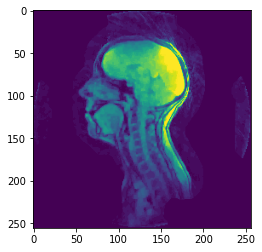

In [ ]:
plt.imshow(volume[:,:,0])
img = volume[:,:,0]
test = tf.expand_dims(img, axis = 0)
test = tf.expand_dims(test, axis = 3)
test.shape

In [ ]:
y = layers.Conv2DTranspose(filters = 10,
                  kernel_size = (3,3),
                  padding = 'same')(test)
y

z = layers.Conv2DTranspose(filters = 10,
                  kernel_size = (3,3),
                  padding = 'same')(y)

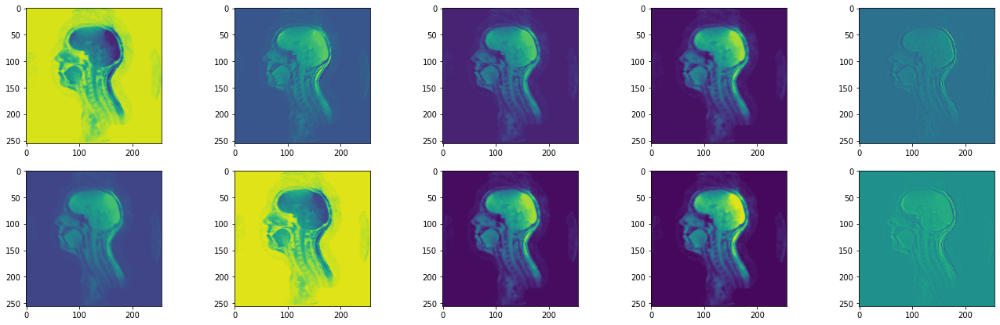

In [ ]:
fig = plt.figure(figsize = [23, 7])
for i in range(10):
    plt.subplot(2,5,i+1)
    plt.imshow(y[0,:,:,i])

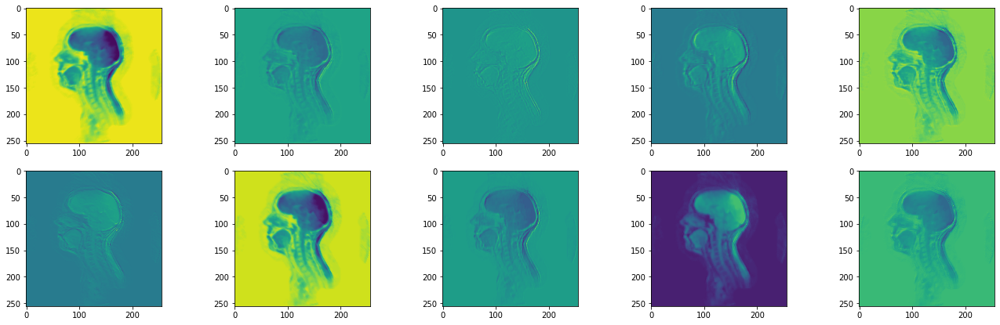

In [ ]:
fig = plt.figure(figsize = [23, 7])
for i in range(10):
    plt.subplot(2,5,i+1)
    plt.imshow(z[0,:,:,i])

### Debugging Matrices

In [ ]:
x = np.array( #3 CLASSI, BATCH_SIZE = 2
    [
     [
            [ [,0. 0., 1],
              [0, 1., 1],
              [0, 1., 1.]],
            [ [0, 0, 1],
              [1, 0, 1],
              [0, 0, 1]]
     ],
     [
            [ [0, 1, 1],
              [0, 0, 0],
              [0, 0, 1]],
            [ [0, 0, 0],
              [0, 0, 0],
              [0, 1, 0]]
     ],
     [
            [ [0, 1, 1],
              [1, 1, 1],
              [1, 1, 1]],
            [ [1, 1, 1],
              [1, 1, 0],
              [1, 1, 0]],
     ]
    ]
, dtype = float)

y = np.array(
    [
     [
            [ [1, 0.9, 0.5],
              [0.3, 1, 1],
              [0.1, 1, 1]],
            [ [0, 0, 3],
              [0, 0, 6],
              [0, 0, 5]]
     ],
     [
            [ [1, 0, 1],
              [1, 0, 1],
              [1, 0, 1]],
            [ [0, 0, 0],
              [0, 0.1, 0],
              [0, 0.6, 0]]
     ],
     [
            [ [0, 0.6, 0.7],
              [1, 0.6, 0.7],
              [0.6, 0.6, 0.9]],
            [ [1, 1, 1],
              [0.5, 0.6, 0.2],
              [0.2, 0.9, 0.1]],
     ]
    ]
, dtype = float)
x = np.transpose(x, [1, 2, 3, 0])
y = np.transpose(y, [1, 2, 3, 0])
print(x.shape)
y.shape

In [ ]:
x = np.array(
    [
     [
            [ [0, 0, 1, 1, 1, 1, 1, 1, 1 ,1 ],
              [1, 0, 1, 1, 1, 1, 1, 1, 1, 1 ],
             [0, 0, 1, 1, 1, 1, 1, 1, 1 ,1 ],
             [0, 1, 1, 1, 1, 1, 1, 1, 1 ,1 ],
             [0, 1, 1, 1, 1, 1, 1, 1, 1 ,1 ],
             [0, 1, 1, 1, 1, 1, 1, 1, 1 ,1 ],
             [0, 1, 1, 1, 1, 1, 1, 1, 1 ,1 ],
             [0, 1, 1, 1, 1, 1, 1, 1, 1 ,1 ],
             [0, 1, 1, 1, 1, 1, 1, 1, 1 ,1 ],
             [0, 1, 1, 1, 1, 1, 1, 1, 1 ,1 ]],
     ],
     [
            [ [1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
             [1, 1, 1, 1, 1, 1, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
            ],
     ],
    ]
, dtype = float)

y = np.array(
    [
     [
            [ [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             [0, 0, 0.9, 0.8, 0.7, 0.8, 0.9, 0.1, 1 ,1 ],
             ],
     ],
     [
           [ [1, 1, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
             [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
            ],
     ],
    ]
, dtype = float)
x = tf.transpose(x, [1, 2, 3, 0])
y = tf.transpose(y, [1, 2, 3, 0])
print(x.shape)
y.shape

### Image standardization

In [ ]:
#TO EVALUATE PIXEL INTENSITY DISTRIBUTION

perc = 0.
i = 0
for batch in train_ds.take(BATCH_NUM_TRAIN):  #rendi meno hard code 
    volume_batch, label_batch = batch
    for volume, label in zip(volume_batch, label_batch):
        perc = perc + np.percentile(volume, [25, 50, 75, 90, 96, 97, 98, 99, 100])

for batch in validation_ds.take(BATCH_NUM_VALIDATION):  #rendi meno hard code 
    volume_batch, label_batch = batch
    for volume, label in zip(volume_batch, label_batch):
        perc = perc + np.percentile(volume, [25, 50, 75, 90, 96, 97, 98, 99, 100])

for batch in test_ds.take(BATCH_NUM_TEST):  #rendi meno hard code 
    volume_batch, label_batch = batch
    for volume, label in zip(volume_batch, label_batch):
        perc = perc + np.percentile(volume, [25, 50, 75, 90, 96, 97, 98, 99, 100])


perc = perc/460
print(perc)

perc_th = perc*256
print(perc_th)



### HD Loss


In [ ]:
#HD COMPARED WITH SCIPY GOLD STANDARD

import scipy.ndimage.morphology as snm
import scipy.spatial.distance as ssd


In [ ]:
y_t = tf.cast(tf.cast(x, dtype= bool), dtype= tf.uint8)
y_t.shape

In [ ]:
hd_loss_image = tf.TensorArray(tf.float32, size=0, dynamic_size=True, clear_after_read=False)
st = 0.

for c in range(3):
    for b in range(4):
        hd_loss_image = hd_loss_image.write(b, b)
    st = tf.math.add(hd_loss_image.stack(), st)
    

st

In [ ]:

#andrebbe messa una threshold come da paper
"""
a = tf.math.logical_and(tf.cast(x[0,:,:,0,], bool), tf.cast(y[0,:,:,0], bool)) #intersection
b = tf.math.logical_or(tf.cast(x[0,:,:,0,], bool), tf.cast(y[0,:,:,0], bool)) #union
c = tf.math.logical_xor(b,a)
c = tf.cast(c, tf.float32)
"""

In [ ]:
print(x[1,:,:,2])
print(y[1,:,:,2])

In [ ]:
Custom_Loss_Functions.Hausdorff_Distance_Loss(num_classes=3, batch_size=2, alpha=2)(x,y)

In [ ]:
a = snm.distance_transform_edt(y[0,:,:,0])
o = snm.distance_transform_edt(y[1,:,:,0])
z = snm.distance_transform_edt(y[:,:,:,0])
print(' snm \n', a)
print('\n snm \n', o)
print('\n snm \n', z)

In [ ]:
x = tf.cast(x, tf.float32)
a = snm.distance_transform_edt(y[0,:,:,0])
t = y[:,:,:,0]
u = tf.cast(t, bool)
v = tf.cast(u, tf.uint8)
v = tf.expand_dims(v, 3)
print(v.shape)

b = tfa.image.euclidean_dist_transform(v[0,:,:,0], dtype = tf.float32)
c = tfa.image.euclidean_dist_transform(v[1,:,:,0], dtype = tf.float32)
d = tfa.image.euclidean_dist_transform(v[:,:,:,0], dtype = tf.float32)

print(' tfa \n', b)
print('\n tfa \n', c)
print('\n tfa \n', d)


In [ ]:
b=1
a = ssd.directed_hausdorff(x[b,:,:,0], y[b,:,:,0])[0]
d = ssd.directed_hausdorff(y[b,:,:,0], x[b,:,:,0])[0]
c = max(a,d)
print(a, d, c)

hd_a = tf.math.reduce_max(tf.math.multiply(tf.math.abs(tf.math.subtract(x[b,:,:,0], y[b,:,:,0])), snm.distance_transform_edt(x[b,:,:,0])))
hd_b = tf.math.reduce_max(tf.math.multiply(tf.math.abs(tf.math.subtract(x[b,:,:,0], y[b,:,:,0])), snm.distance_transform_edt(y[b,:,:,0])))
hd_o = tf.math.maximum(hd_a, hd_b)
print(hd_a)
print(hd_b)
print('hd_o', hd_o)
print('\n')

Custom_Metrics.Hausdorff_Distance(num_classes=1)(x,y)

In [ ]:
alpha = 2.

a = x[0,:,:,0]
b = y[0,:,:,0]

b=0
c = 0
#LOSS
hd_loss_1 = 0.
hdl = 0.
hd = 0.

hd_loss_1 = tf.math.add(tf.math.pow(snm.distance_transform_edt(x[b,:,:,c]), alpha), tf.math.pow(snm.distance_transform_edt(y[b,:,:,c]), alpha))
hdl = tf.math.square(tf.math.subtract(y[b,:,:,c],x[b,:,:,c]))
hd = tf.math.multiply(hdl, hd_loss_1)
hd_ok = tf.math.reduce_mean(hd)
print(hd_loss_1)
print(hdl)
print(hd)
print(hd_ok)

In [ ]:
b=0
c = 0
#LOSS 2
hd_loss_1 = 0.
hdl = 0.
hd = 0.
alpha = 2

hd_loss_1 = tf.math.add(tf.math.pow(tfa.image.euclidean_dist_transform(tf.cast(tf.cast(x[b,:,:,c], bool), tf.uint8), tf.float32), alpha), tf.math.pow(tfa.image.euclidean_dist_transform(tf.cast(tf.cast(y[b,:,:,c], bool), tf.uint8), tf.float32), alpha))
print(hd_loss_1.dtype)
hdl = tf.cast(tf.math.square(tf.math.subtract(y[b,:,:,c],x[b,:,:,c])), tf.float32)

hd = tf.math.multiply(hdl, hd_loss_1)
hd_ok = tf.math.reduce_mean(hd)
print(hd_loss_1)
print(hdl)
print(hd)
print(hd_ok)

In [ ]:
print(x[1,:,:,2])
print(y[1,:,:,2])

In [ ]:
ao = tf.cast(tf.cast(y[1,:,:,2], bool), tf.uint8)
snm.distance_transform_edt(ao)

In [ ]:
av = tf.cast(tf.cast(y[1,:,:,2], bool), tf.uint8)
snm.distance_transform_edt(av)

In [ ]:

Custom_Loss_Functions.Hausdorff_Distance_Loss(num_classes=1, batch_size=1, alpha=2)(x,y)

In [ ]:
tfa.image.euclidean_dist_transform(tf.cast(tf.cast(y[0,:,:,0], bool), tf.uint8), tf.float32)

### Average Hausdorff Distance

In [ ]:
a = tf.constant([[[0.,2.,3.],[1.,2.,3.]]])
c = tf.constant([[[2,2,4],[1,2,3]]])
b = 1.
print(a)
print(c)

In [ ]:
mask_b = tf.cast(tf.greater(a[:,:], 1), dtype = tf.float32)
non_zero_array_b = tf.expand_dims(tf.boolean_mask(a[:,:], mask_b), axis = 0)
bib = tf.expand_dims(tf.boolean_mask(c[:,:], mask_b), axis = 0)

print(mask_b)
print(non_zero_array_b)
bib

In [ ]:
b = tf.math.reduce_mean(c, 2)
tf.math.reduce_sum(b)

In [ ]:
tf.norm(b-a, ord = 'euclidean', axis = 0 )

In [ ]:
def bahd_v2(x,y):   #uso solo elementi non nulli 
    x = tf.cast(x, dtype= tf.float32)
    y = tf.cast(y, dtype= tf.float32)

    mask_b = tf.cast(tf.greater(y[0,:,:,1], 0), dtype = tf.float32)
    non_zero_array_b = tf.expand_dims(tf.boolean_mask(y[0,:,:,1], mask_b), axis = 0)

    mask_a = tf.cast(tf.greater(x[0,:,:,1], 0), dtype = tf.float32)
    non_zero_array_a = tf.expand_dims(tf.boolean_mask(x[0,:,:,1], mask_a), axis = 0)

    print(non_zero_array_b, non_zero_array_a)

    dim_1 = non_zero_array_a.shape[1]
    dim_2 = non_zero_array_b.shape[1]

    num_1 = 0.
    min_d_1 = 0.
    for i in range(dim_1):
        min_distance_1 = tf.reduce_min(tf.norm(non_zero_array_a[0,i]-non_zero_array_b, ord = 'euclidean', axis = 0 ))
        num_1 = tf.math.add(min_distance_1, num_1)

    min_d_1 = tf.math.divide(num_1,dim_1)
    print(min_d_1)

    num_2 = 0.
    min_d_2 = 0.
    for i in range(dim_2):
        min_distance_2 = tf.reduce_min(tf.norm(non_zero_array_b[0,i]-non_zero_array_a, ord = 'euclidean', axis = 0 ))
        num_2 = tf.math.add(min_distance_2, num_2)

    min_d_2 = tf.math.divide(num_2,dim_1)
    print(min_d_2)

    bahd = (min_d_1+min_d_2)/2
    print(bahd)
    return bahd

In [ ]:
def bahd_v1(x,y):  
    x = tf.cast(x, dtype= tf.float32)
    y = tf.cast(y, dtype= tf.float32)
    a = np.expand_dims(x[0,:,:,1], axis = 0)
    c = np.expand_dims(y[0,:,:,1], axis = 0)
    GT_pixel = 0

    min_distance = 0.
    GT_pixel = 0
    ij_distances = 0.
    ij_distances_1 = 0.
    min_distance = 0.
    min_distance_1 = 0.
    min_d = 0.
    min_d1 = 0.

    for i in range(a.shape[1]):
        for j in range(a.shape[2]):
            if a[0,i,j] != 0:
                ij_distances = tf.norm(a[0,i,j]-c, ord = 'euclidean', axis = 0 )
                print(ij_distances)
                min_distance = tf.math.add(tf.math.reduce_min(ij_distances), min_distance)
                print(min_distance)
                GT_pixel = GT_pixel + 1

    min_d = tf.math.divide(min_distance, GT_pixel)
    print(min_d)
    print("_______________________________________________________________________________")

    min_distance_1 = 0.
    for i in range(c.shape[1]):
        for j in range(c.shape[2]):
            if c[0,i,j] != 0:
                ij_distances_1 = tf.norm(c[0,i,j]-a, ord = 'euclidean', axis = 0 )
                print(ij_distances_1)
                min_distance_1 = tf.math.add(tf.math.reduce_min(ij_distances_1), min_distance_1)
                print(min_distance_1)
    
    min_d_1 = tf.math.divide(min_distance_1, GT_pixel)
    print(min_d_1)
    print("________________________________________________________________________________")

    bahd = (min_d+min_d_1)/2
    print(bahd)
    return bahd



### Metrics and Losses comparison

In [ ]:
image_of_batch = 0 #@param{type:"slider", min:0, max:8, step:1}
class_n = 1 #@param{type:"slider", min:0, max:6, step:1}
loss_0= "CE" #@param ["DiceFocalLoss", "HDLoss", "TopKLoss", "WCE", "CE", "DiceTKLoss", "DiceCE", "Dice", "DiceHDLoss", "Focal"] {allow-input: true}
loss_1= "Dice" #@param ["DiceFocalLoss", "HDLoss", "TopKLoss", "WCE", "CE", "DiceTKLoss", "DiceCE", "Dice", "DiceHDLoss", "Focal"] {allow-input: true}
loss_2= "TopKLoss" #@param ["DiceFocalLoss", "HDLoss", "TopKLoss", "WCE", "CE", "DiceTKLoss", "DiceCE", "Dice", "DiceHDLoss", "Focal"] {allow-input: true}
loss_3= "Focal" #@param ["DiceFocalLoss", "HDLoss", "TopKLoss", "WCE", "CE", "DiceTKLoss", "DiceCE", "Dice", "DiceHDLoss", "Focal"] {allow-input: true}

In [ ]:
lbl_b = image_of_batch
lbl_c = class_n

for batch in test_ds.take(1):
    volume_batch, label_batch = batch

    label_batch = tf.cast(label_batch, dtype = tf.float32)
    label_dim = np.expand_dims(label_batch[lbl_b,:,:,lbl_c], axis = (0,3)) 

    for batch in test_ds.take(-2):
        volume_batch_c, label_batch_c = batch
        label_dim_comparison = np.zeros((256,256))
        label_dim_comparison[:,:] = tf.math.reduce_mean(label_batch_c[:,:,:,lbl_c], axis = 0)
        label_dim_comparison= np.expand_dims(label_dim_comparison[:,:], axis = (0,3)) 
    
    mean_label = np.zeros((1,256,256,7))
    for c in range(7):
        mean_label[0,:,:,c] = tf.math.reduce_mean(label_batch[:,:,:,c], axis = 0)
    
    mean_dim = np.expand_dims(mean_label[0,:,:,lbl_c], axis = (0,3)) # fake-prediction a scelta tra le classi ottenuta mediando le label di un batch;  per test metriche

    negative = np.zeros((1,256,256,1))
    negative = tf.math.logical_not(tf.cast(label_batch[lbl_b, :,:, lbl_c], dtype = tf.bool))
    negative = tf.cast(negative, dtype = tf.float32)
    negative_dim = np.expand_dims(negative[:,:], axis = (0,3))

    #random = tf.random.poisson([256,256], 1, tf.float32)
    random = np.random.randint(2, size=(256,256)).astype(bool)
    random_dim = np.expand_dims(random[:,:], axis = (0,3))

    loss_dictionary = {'DiceFocalLoss':Dice_Focal(num_classes=1, gamma = 2),
                       'HDLoss':Hausdorff_Distance_Loss(num_classes=1, batch_size=1, alpha=2),
                       'TopKLoss': TopK(num_classes=1, percentile=0.01),
                       'WCE': Weighted_Cross_Entropy(num_classes= 1),
                       'CE': Cross_Entropy(num_classes= 1),
                       'DiceTKLoss': Dice_TopK(num_classes = 1, percentile = 1 ),
                       'DiceCE':Dice_CE(num_classes=1),
                       'Dice': Dice(num_classes= 1),
                       'DiceHDLoss': Dice_HD(num_classes=1, batch_size=1, alpha = 2),
                       'Focal': Focal(num_classes= 1, gamma = 2)
                       }

    
    #fake prediction
    DICE_fakep = Mean_DICE(num_classes=1)(label_dim,mean_dim)
    HD_fakep = Hausdorff_Distance(num_classes=1)(label_dim,mean_dim)
    GCE_fakep = Global_Consistency_Error(num_classes= 1, batch_size= 1, threshold= 0.9)(label_dim,mean_dim)
    loss0_fakep = loss_dictionary[loss_0](label_dim,mean_dim)
    loss1_fakep = loss_dictionary[loss_1](label_dim,mean_dim)
    loss2_fakep = loss_dictionary[loss_2](label_dim,mean_dim)
    loss3_fakep = loss_dictionary[loss_3](label_dim,mean_dim)
    

    #negative
    DICE_negative = Mean_DICE(num_classes=1)(label_dim,negative_dim)
    HD_negative = Hausdorff_Distance(num_classes=1)(label_dim, negative_dim)
    GCE_negative = Global_Consistency_Error(num_classes= 1, batch_size= 1, threshold= 0.9)(label_dim,negative_dim)
    loss0_negative = loss_dictionary[loss_0](label_dim,negative_dim)
    loss1_negative = loss_dictionary[loss_1](label_dim,negative_dim)
    loss2_negative = loss_dictionary[loss_2](label_dim,negative_dim)
    loss3_negative = loss_dictionary[loss_3](label_dim,negative_dim)
    
    #identity
    DICE_identity = Mean_DICE(num_classes=1)(label_dim,label_dim)
    HD_identity =  Hausdorff_Distance(num_classes=1)(label_dim, label_dim)
    GCE_identity = Global_Consistency_Error(num_classes= 1, batch_size= 1, threshold= 0.9)(label_dim,label_dim)
    loss0_identity = loss_dictionary[loss_0](label_dim,label_dim)
    loss1_identity = loss_dictionary[loss_1](label_dim,label_dim)
    loss2_identity = loss_dictionary[loss_2](label_dim,label_dim)
    loss3_identity = loss_dictionary[loss_3](label_dim,label_dim)

    #random
    DICE_random = Mean_DICE(num_classes=1)(label_dim,random_dim)
    HD_random = Hausdorff_Distance(num_classes=1)(label_dim, random_dim)
    GCE_random = Global_Consistency_Error(num_classes= 1, batch_size= 1, threshold= 0.9)(label_dim,random_dim)
    loss0_random = loss_dictionary[loss_0](label_dim,random_dim) 
    loss1_random = loss_dictionary[loss_1](label_dim,random_dim) 
    loss2_random = loss_dictionary[loss_2](label_dim,random_dim) 
    loss3_random = loss_dictionary[loss_3](label_dim,random_dim) 

    #comparison
    DICE_comparison = Mean_DICE(num_classes=1)(label_dim,label_dim_comparison)
    HD_comparison = Hausdorff_Distance(num_classes=1)(label_dim,label_dim_comparison)
    GCE_comparison = Global_Consistency_Error(num_classes= 1, batch_size= 1, threshold= 0.9)(label_dim,label_dim_comparison)
    loss0_comparison = loss_dictionary[loss_0](label_dim,label_dim_comparison)
    loss1_comparison = loss_dictionary[loss_1](label_dim,label_dim_comparison)
    loss2_comparison = loss_dictionary[loss_2](label_dim,label_dim_comparison)
    loss3_comparison = loss_dictionary[loss_3](label_dim,label_dim_comparison)

    print(tabulate([["DICE", DICE_identity, DICE_fakep, DICE_negative, DICE_random, DICE_comparison], 
                    ["HD", HD_identity, HD_fakep, HD_negative, HD_random, HD_comparison], 
                    ["GCE", GCE_identity, GCE_fakep, GCE_negative, GCE_random, GCE_comparison ], 
                    [loss_0 , loss0_identity, loss0_fakep, loss0_negative, loss0_random, loss0_comparison],
                    [loss_1 , loss1_identity, loss1_fakep, loss1_negative, loss1_random, loss1_comparison],
                    [loss_2 , loss2_identity, loss2_fakep, loss2_negative, loss2_random, loss2_comparison],
                    [loss_3 , loss3_identity, loss3_fakep, loss3_negative, loss3_random, loss3_comparison],
                    ], 
                   headers=['Metric/Loss', 'lbl identity', 'lbl mean over batch', 'lbl negative', 'lbl random', 'lbl mean other batch'], tablefmt='orgtbl'))

    fig = plt.figure(figsize = [23, 7]) #creo ogni ciclo la figura bianca
    plt.subplot(2, 5, 1) #creo le colonne e le righe
    plt.xlabel('lbl identity')
    plt.imshow(label_dim[0,:,:,0], cmap="magma") #ploto il label
    plt.subplot(2, 5, 2)
    plt.xlabel('lbl mean over batch')
    plt.imshow(mean_dim[0,:,:,0], cmap="magma") #plotto fake prediction
    plt.subplot(2, 5, 3)
    plt.xlabel('lbl negative')
    plt.imshow(negative_dim[0,:,:,0], cmap="magma")
    plt.subplot(2, 5, 4)
    plt.xlabel('lbl random')
    plt.imshow(random_dim[0,:,:,0], cmap="magma")
    plt.subplot(2, 5, 5)
    plt.xlabel('lbl mean over other batch')
    plt.imshow(label_dim_comparison[0,:,:,0], cmap="magma")

    plt.subplot(2, 5, 7) #creo le colonne e le righe
    plt.xlabel('difference id-mob')
    plt.imshow(tf.math.logical_and(label_dim[0,:,:,0], mean_dim[0,:,:,0]), cmap="magma") #ploto il label
    plt.subplot(2, 5, 8)
    plt.xlabel('difference id-neg')
    plt.imshow(tf.math.logical_and(label_dim[0,:,:,0], negative_dim[0,:,:,0]), cmap="magma") #plotto fake prediction
    plt.subplot(2, 5, 9)
    plt.xlabel('difference id-rnd')
    plt.imshow(tf.math.logical_and(label_dim[0,:,:,0], random_dim[0,:,:,0]), cmap="magma")
    plt.subplot(2, 5, 10)
    plt.xlabel('difference id-moob ')
    plt.imshow(tf.math.logical_and(label_dim[0,:,:,0], label_dim_comparison[0,:,:,0]), cmap="magma")





In [ ]:

y_true = label_dim
y_pred = mean_dim
c = 0

diff = tf.math.abs(tf.math.subtract(y_true[:,:,:,c],y_pred[:,:,:,c]))
perc_s = tfp.stats.percentile(diff, [99], axis = (1,2), keepdims= True)
print(perc_s)
perc_s = tf.squeeze(perc_s, 0)
print(perc_s)
mask_b = tf.cast(tf.greater_equal(diff, perc_s), dtype = tf.float32)
k_y_true = tf.math.multiply(y_true[:,:,:,c], mask_b)
k_y_pred = tf.math.multiply(y_pred[:,:,:,c], mask_b)
pc = tfp.stats.percentile(diff, [25, 50, 75, 90, 99])

print(pc)
perc = (tf.math.count_nonzero(diff))*100/65536
print(perc)
diff.shape
print(k_y_true.shape)

CE1 = Custom_Loss_Functions.Cross_Entropy(num_classes=1)(y_true, y_pred)
print(CE1)

CE2 = Custom_Loss_Functions.Cross_Entropy(num_classes=1)(tf.expand_dims(k_y_true,3), tf.expand_dims(k_y_pred, 3))
print(CE2)

y_im = tf.where(volume[0,:,:,1]< 0.34, 0.34, volume[0,:,:,1])
plt.imshow(y_im)

In [ ]:
fig = plt.figure(figsize = [23, 7])
plt.subplot(1,6,4)
plt.imshow(k_y_true[0,:,:])
plt.subplot(1,6,1)
plt.imshow(y_true[0,:,:,0])
plt.subplot(1,6,3)
plt.imshow(diff[0,:,:])
plt.subplot(1,6,6)
plt.imshow(mask_b[0,:,:])
plt.subplot(1,6,5)
plt.imshow(k_y_pred[0,:,:])
plt.subplot(1,6,2)
plt.imshow(y_pred[0,:,:,0])


In [ ]:
plt.imshow(mean_dim[0,:,:,0])

In [ ]:
#plt.imshow(label_dim[0,:,:,0])
#plt.colorbar()
img = label_dim[0,:,:,0]
print(img.shape)
tot_pixel = 256*256
solo_zero = img[img == 0] 
solo_uno = img[img == 1] 
print(tot_pixel)
print(solo_zero.shape[0] + solo_uno.shape[0])


In [ ]:
plt.hist(label_dim[0,:,:,0], bins = 100)

In [ ]:
a = tf.math.logical_and(label_dim[0,:,:,0,], mean_dim[0,:,:,0]) #intersection
b = tf.math.logical_or(label_dim[0,:,:,0,], mean_dim[0,:,:,0]) #union
c = tf.math.logical_xor(b,a)
c = tf.cast(c, tf.float32)

fig = plt.figure(figsize = [23, 7])
plt.subplot(2,3,1)
plt.imshow(a)
plt.subplot(2,3,2)
plt.imshow(b)
plt.subplot(2,3,3)
plt.imshow(c)

hdpq = tf.math.reduce_max(tf.math.multiply(c, snd.morphology.distance_transform_edt(label_dim[0,:,:,0,])))
hdqp = tf.math.reduce_max(tf.math.multiply(c, snd.morphology.distance_transform_edt(mean_dim[0,:,:,0])))
hd = tf.math.maximum(hdpq,hdqp)

plt.subplot(2,3,4)
plt.imshow(snd.morphology.distance_transform_edt(label_dim[0,:,:,0,]))


Custom_Metrics.Hausdorff_Distance(num_classes=1)(x,y)

# Prediction File Writer

In [17]:
!pip install pynrrd

In [88]:
import nrrd
import cv2
import tifffile

In [79]:
header={'type': 'double',
        'dimension': 3,
        'space': 'left-posterior-superior',
        'sizes': [256, 256, 1],
        'endian': 'little',
        'encoding': 'gzip',
        'Segment0_Color': '0.501961 0.682353 0.501961',
        'Segment0_ID': 'Segment_1',
        'Segment0_LabelValue': '5',
        'Segment0_Name': 'LL',
        'Segment0_Layer': '0',
        'Segment1_Color': '0.945098 0.839216 0.568627',
        'Segment1_ID': 'Segment_2',
        'Segment1_LabelValue': '3',
        'Segment1_Name': 'SP',
        'Segment1_Layer': '0',
        'Segment2_Color': '0.694118 0.478431 0.396078',
        'Segment2_ID': 'Segment_3',
        'Segment2_LabelValue': '4',
        'Segment2_Name': 'TO',
        'Segment2_Layer': '0',
        'Segment3_Color': '0.435294 0.721569 0.823529',
        'Segment3_ID': 'Segment_4',
        'Segment3_LabelValue': '1',
        'Segment3_Name': 'UL',
        'Segment3_Layer': '0',
        'Segment4_Color': '0.866667 0.509804 0.396078',
        'Segment4_ID': 'Segment_6',
        'Segment4_LabelValue': '6',
        'Segment4_Name': 'HE',
        'Segment4_Layer': '0',
        'Segment5_Color': '0.847059 0.396078 0.309804',
        'Segment5_ID': 'Segment_5',
        'Segment5_LabelValue': '2',
        'Segment5_Name': 'HP',
        'Segment5_Layer': '0',
        'Segment6_Color': '0.901961 0.862745 0.27451',
        'Segment6_ID': 'Segment_7',
        'Segment6_LabelValue': '7',
        'Segment6_Name': 'BG',
        'Segment6_Layer': '0',
        }

In [91]:
PREDICTIONS_PATH = os.path.join(PROJECT_PATH, 'Predictions')
try:
    os.mkdir(PREDICTIONS_PATH)
except:
    pass

PREDICTIONS_MODELS = os.path.join(PREDICTIONS_PATH, LOADED_MODEL_NAME)
try:
    os.mkdir(PREDICTIONS_MODELS)
except:
    pass

TEST_VOLUMES = os.path.join(PREDICTIONS_MODELS, 'Volumes')
TEST_LABELS = os.path.join(PREDICTIONS_MODELS, 'Labels')
TEST_PREDICTIONS = os.path.join(PREDICTIONS_MODELS, 'Predictions')

try:
    os.mkdir(TEST_VOLUMES)
except:
    pass

try:
    os.mkdir(TEST_LABELS)
except:
    pass

try:
    os.mkdir(TEST_PREDICTIONS)
except:
    pass

test_n = 0

for batch in test_ds.take(BATCH_NUM_TEST):  #rendi meno hard code (prende un batch alla volta)
    volume_batch, label_batch = batch

    for volume, label in zip(volume_batch, label_batch):

            voxel_p = np.zeros([256,256,7])
            voxel_l = np.zeros([256,256,7])

            for j in range(prediction.shape[3]):
                
                if j == 0:
                    voxel_p[:,:,j] = tf.math.multiply(tf.cast(tf.math.greater(prediction[test_n,:,:,j], 0.8),tf.uint8), 7) #va thresholdato per forza
                    voxel_l[:,:,j] = tf.math.multiply(label[:,:,j], 7)
                else: 
                    voxel_p[:,:,j] = tf.math.multiply(tf.cast(tf.math.greater(prediction[test_n,:,:,j], 0.8),tf.uint8), j) #va thresholdato per forza
                    voxel_l[:,:,j] = tf.math.multiply(label[:,:,j], j) 


            voxel_p = tf.math.reduce_sum(voxel_p, axis = 2)
            voxel_p = tf.expand_dims(voxel_p, 2).numpy()
            voxel_p = np.rot90(voxel_p, k=1)
            voxel_p = np.flip(voxel_p, 0)
            
            voxel_l = tf.math.reduce_sum(voxel_l, axis = 2)
            voxel_l = tf.expand_dims(voxel_l, 2).numpy()
            voxel_l = np.rot90(voxel_l, k=1)
            voxel_l = np.flip(voxel_l, 0)

            img = np.squeeze(volume.numpy(), 2)
            tifffile.imsave(os.path.join(TEST_VOLUMES,'test_volume_{}.tiff'.format(test_n)), img)
            #im = Image.fromarray(np.squeeze(volume.numpy(), 2))
            #im.save(TEST_VOLUMES + 'test_volume_{}.jpeg'.format(test_n))

            prediction_name = 'test_prediciton_{}.nrrd'.format(test_n)
            label_name = 'test_label_{}.nrrd'.format(test_n)
            
            # Write to a NRRD file
            nrrd.write(os.path.join(TEST_PREDICTIONS, prediction_name), voxel_p, header)
            nrrd.write(os.path.join(TEST_LABELS, label_name), voxel_l, header)

            test_n = test_n + 1
        



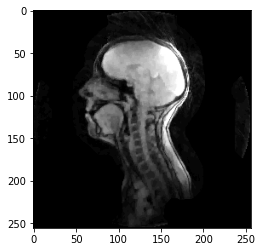

In [86]:
plt.imshow(np.squeeze(volume.numpy(), 2), cmap = 'gray')

In [27]:
voxels = []
map = np.zeros([256,256,7])
for i in range(prediction.shape[0]):

    for j in range(1,prediction.shape[3]):
        map[:,:,j-1] = tf.math.multiply(tf.cast(tf.math.greater(prediction[0,:,:,j], 0.8),tf.uint8), j) #va thresholdato per forza

    map = tf.math.reduce_sum(map, axis = 2)
    map = tf.expand_dims(map, 2).numpy()
    map = np.rot90(map, k=1)
    map = np.flip(map, 0)
    voxels[i] = map

    



IndexError: ignored

In [71]:
voxel_p = np.zeros([256,256,7])
for j in range(prediction.shape[3]):
        
    if j == 0:
        voxel_p[:,:,j] = tf.math.multiply(tf.cast(tf.math.greater(prediction[0,:,:,j], 0.8),tf.uint8), 7) #va thresholdato per forza
        voxel_l[:,:,j] = tf.math.multiply(prediction[0,:,:,j], 7)
    else: 
        voxel_p[:,:,j] = tf.math.multiply(tf.cast(tf.math.greater(prediction[0,:,:,j], 0.8),tf.uint8), j) #va thresholdato per forza
        voxel_l[:,:,j] = tf.math.multiply(prediction[0,:,:,j], j) 

voxel_p = tf.math.reduce_sum(voxel_p, axis = 2)
voxel_p = tf.expand_dims(voxel_p, 2).numpy()
voxel_p = np.rot90(voxel_p, k=1)
voxel_p = np.flip(voxel_p, 0)

voxel_l = tf.math.reduce_sum(voxel_l, axis = 2)
voxel_l = tf.expand_dims(voxel_l, 2).numpy()
voxel_l = np.rot90(voxel_l, k=1)
voxel_l = np.flip(voxel_l, 0)


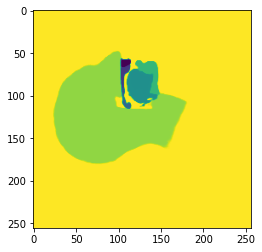

In [72]:
plt.imshow(voxel_l[:,:,0])

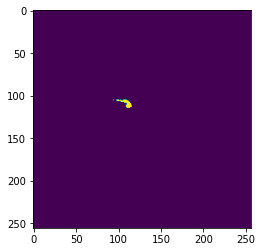

In [52]:
plt.imshow(voxel_p[:,:,3])

In [ ]:
batch_n = 0
n_volume = 0

for batch in test_ds.take(BATCH_NUM_TEST):  #rendi meno hard code (prende un batch alla volta)
    volume_batch, label_batch = batch
    print("Batch n°: ", batch_n)
    batch_n = batch_n + 1
    
    for volume, label in zip(volume_batch, label_batch):  #(prende un immagine del sopracitatao batch alla volta)
        
        fig = plt.figure(figsize = [23, 6]) #creo ogni ciclo la figura bianca
        plt.subplot(2, (NUM_CLASSES + 1), 1) #creo le colonne e le righe
        plt.imshow(volume[:,:,0], cmap="gray") #ploto l'immagine

        for i in range(NUM_CLASSES): #(per ciascuna immagine cicla sulle classi)
            
            plt.subplot(2, (NUM_CLASSES + 1), i+2) #muovo l'indice di colonna per plottare le varie classi 
            plt.imshow(label[:,:,i], cmap="plasma", alpha=0.5) #plotto le classi
            plt.subplot(2, (NUM_CLASSES + 1), i+10)
            plt.imshow(prediction[n_volume,:,:,i], cmap="plasma", alpha=0.5)
        
        n_volume = n_volume + 1
    
    n_volume = 0
    plt.show(fig) #stampo il tutto

In [ ]:
map = np.zeros([256,256,6])
for j in range(1,prediction.shape[3]):
        map[:,:,j-1] = tf.math.multiply(tf.cast(tf.math.greater(prediction[0,:,:,j], 0.8),tf.uint8), j) #va thresholdato per forza

map.shape

(256, 256, 6)

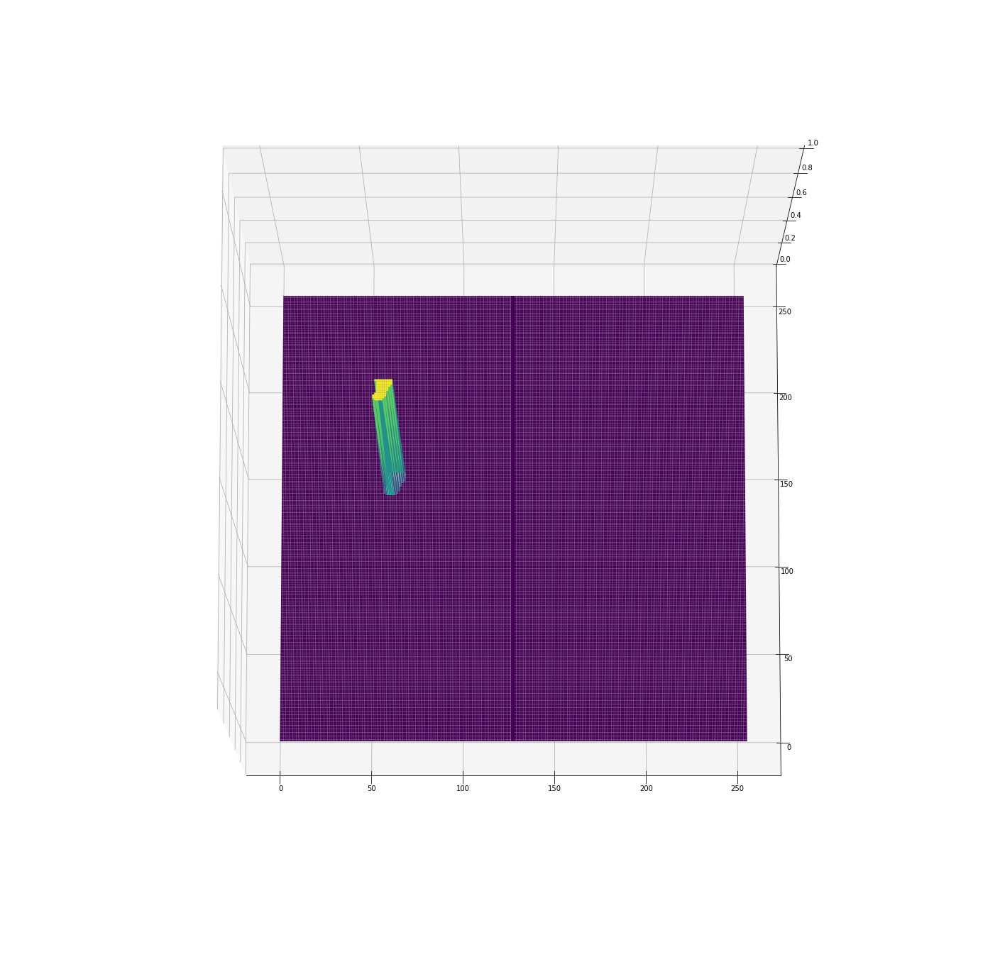

In [26]:
plt.figure(figsize = [25, 25])

ax = plt.axes(projection='3d')
ax.view_init(elev= 80, azim= 270)

y = range( label.shape[0] )
x = range( label.shape[1] )

Z = np.flip(label[:,:,1],0)
X, Y = np.meshgrid(x, y)

ax.plot_surface(X, Y, Z, 
                rstride=1, 
                cstride=1,
                cmap='viridis', 
                edgecolor='none'
                )
plt.show()

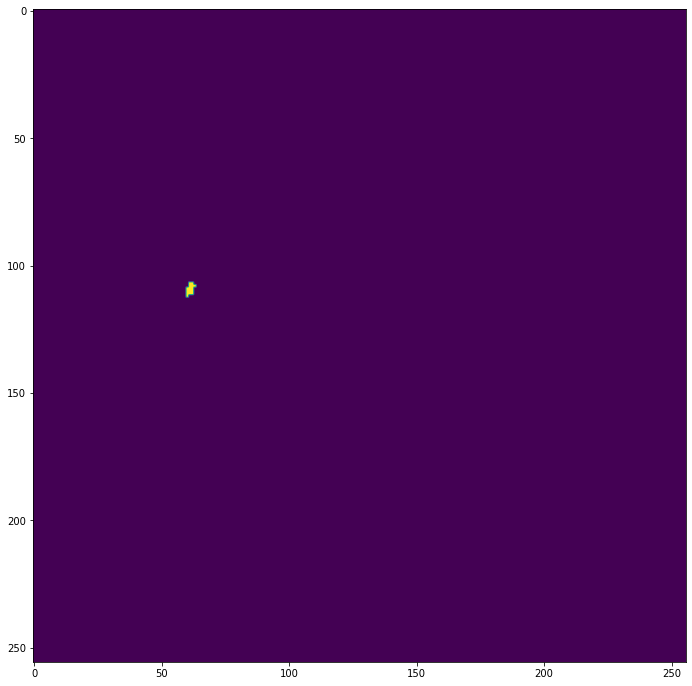

In [ ]:
fig = plt.figure(figsize = [50, 12])
plt.subplot(1,3,1)
plt.imshow(map)

In [ ]:
map.dtype

dtype('float64')

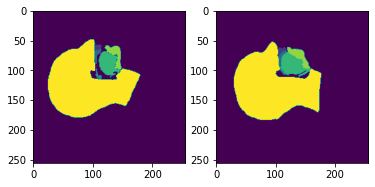

In [ ]:
p = tf.math.reduce_sum(map, axis = 2)
q = tf.expand_dims(p, 2).numpy()
q = np.rot90(q, k=1,)
q = np.flip(q, 0)

plt.subplot(1,2,1)
plt.imshow(q[:,:,0])
plt.subplot(1,2,2)
plt.imshow(voxels[:,:,0])




In [ ]:
header={'type': 'double',
        'dimension': 3,
        'space': 'left-posterior-superior',
        'sizes': [256, 256, 1],
        'endian': 'little',
        'encoding': 'gzip',
        'Segment0_Color': '0.501961 0.682353 0.501961',
        'Segment0_ID': 'Segment_1',
        'Segment0_LabelValue': '5',
        'Segment0_Name': 'LL',
        'Segment0_Layer': '0',
        'Segment1_Color': '0.945098 0.839216 0.568627',
        'Segment1_ID': 'Segment_2',
        'Segment1_LabelValue': '3',
        'Segment1_Name': 'SP',
        'Segment1_Layer': '0',
        'Segment2_Color': '0.694118 0.478431 0.396078',
        'Segment2_ID': 'Segment_3',
        'Segment2_LabelValue': '4',
        'Segment2_Name': 'TO',
        'Segment2_Layer': '0',
        'Segment3_Color': '0.435294 0.721569 0.823529',
        'Segment3_ID': 'Segment_4',
        'Segment3_LabelValue': '1',
        'Segment3_Name': 'UL',
        'Segment3_Layer': '0',
        'Segment4_Color': '0.866667 0.509804 0.396078',
        'Segment4_ID': 'Segment_6',
        'Segment4_LabelValue': '6',
        'Segment4_Name': 'HE',
        'Segment4_Layer': '0',
        'Segment5_Color': '0.847059 0.396078 0.309804',
        'Segment5_ID': 'Segment_5',
        'Segment5_LabelValue': '2',
        'Segment5_Name': 'HP',
        'Segment5_Layer': '0',
        }

In [ ]:
filename = 'testdata2.nrrd'
segment_list = [("LL", 5), ("SP", 3), ("TO", 4), ("UL", 1), ("HE", 6), ("HP", 2)]

# Write to a NRRD file

nrrd.write(filename, q, new_header)

In [ ]:
input_filenames = os.listdir(segmentation_dir)
segment_list = [("LL", 5), ("SP", 3), ("TO", 4), ("UL", 1), ("HE", 6), ("HP", 2)]

seg = 0

for segmentation in input_filenames:
    input_filename = os.path.join(segmentation_dir, input_filenames[seg])
    output_filename = os.path.join(segmentation_checked_dir, input_filenames[seg])
    seg = seg + 1
    voxels, header = nrrd.read(input_filename)
    segmentation_info = si.read_segmentation_info(input_filename)
    output_voxels, output_header = si.extract_segments(voxels, header, segmentation_info, segment_list)
    output_voxels = output_voxels.astype("uint8") #necessario per avere un nnrd in output con type 'uint8' anzichè 'float64' non gestito da med_dataloader
    nrrd.write(output_filename, output_voxels, output_header)